## Importing the necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings, re, joblib
warnings.filterwarnings('ignore')
from sklearn.model_selection import train_test_split, RandomizedSearchCV, RepeatedKFold, cross_val_score
from sklearn.linear_model import LinearRegression, PassiveAggressiveRegressor, SGDRegressor, ARDRegression, RidgeCV, LassoCV, ElasticNetCV, TweedieRegressor, HuberRegressor, RANSACRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR, LinearSVR, NuSVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, AdaBoostRegressor, HistGradientBoostingRegressor, VotingRegressor
from sklearn.neural_network import MLPRegressor
from xgboost import XGBRegressor, XGBRFRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from scipy.stats import probplot
from sklearn.metrics import mean_absolute_percentage_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler, FunctionTransformer, PowerTransformer, OrdinalEncoder
from yellowbrick.regressor import AlphaSelection, ResidualsPlot, PredictionError
from yellowbrick.features import Rank2D
import plotly.express as px
from sklearn.feature_selection import SelectKBest, SelectPercentile, SelectFromModel, f_regression, mutual_info_regression, RFECV, SequentialFeatureSelector

## Loading the dataset

In [2]:
df = pd.read_csv('walmart-sales-dataset-of-45stores.csv')
df.head()

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106


## Understanding and assessing the shape and structure of the dataset

In [3]:
df.shape

(6435, 8)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6435 entries, 0 to 6434
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         6435 non-null   int64  
 1   Date          6435 non-null   object 
 2   Weekly_Sales  6435 non-null   float64
 3   Holiday_Flag  6435 non-null   int64  
 4   Temperature   6435 non-null   float64
 5   Fuel_Price    6435 non-null   float64
 6   CPI           6435 non-null   float64
 7   Unemployment  6435 non-null   float64
dtypes: float64(5), int64(2), object(1)
memory usage: 402.3+ KB


In [5]:
df.describe()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,6435.000000,6.435000e+03,6435.000000,6435.000000,6435.000000,6435.000000,6435.000000
mean,23.000000,1.046965e+06,0.069930,60.663782,3.358607,171.578394,7.999151
std,12.988182,5.643666e+05,0.255049,18.444933,0.459020,39.356712,1.875885
min,1.000000,2.099862e+05,0.000000,-2.060000,2.472000,126.064000,3.879000
25%,12.000000,5.533501e+05,0.000000,47.460000,2.933000,131.735000,6.891000
50%,23.000000,9.607460e+05,0.000000,62.670000,3.445000,182.616521,7.874000
75%,34.000000,1.420159e+06,0.000000,74.940000,3.735000,212.743293,8.622000
max,45.000000,3.818686e+06,1.000000,100.140000,4.468000,227.232807,14.313000


In [6]:
df.isna().sum()

Store           0
Date            0
Weekly_Sales    0
Holiday_Flag    0
Temperature     0
Fuel_Price      0
CPI             0
Unemployment    0
dtype: int64

In [7]:
df.duplicated().sum()

0

## Exploratory Data Analysis (EDA)

### Univariate Analysis

Skewness of Store: 0.0
Kurtosis of Store: -1.2011866346083275


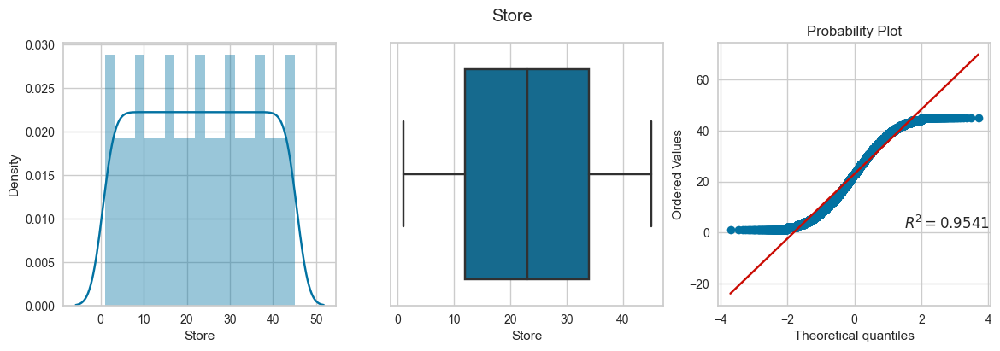

Skewness of Weekly_Sales: 0.6683617974864524
Kurtosis of Weekly_Sales: 0.05314092741722032


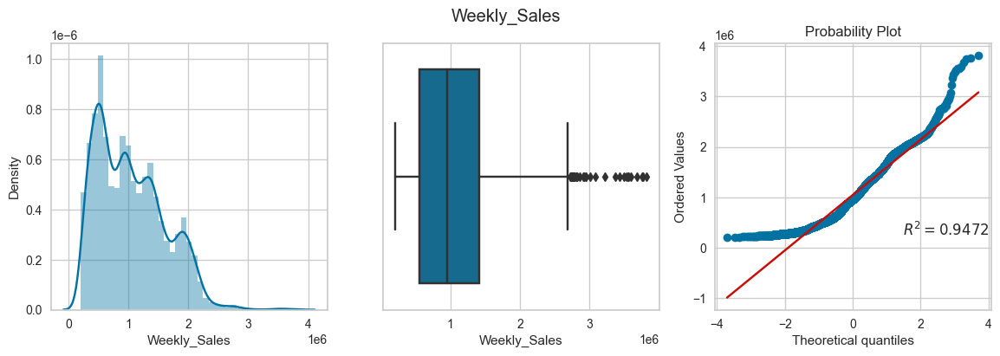

Skewness of Holiday_Flag: 3.3734986714578485
Kurtosis of Holiday_Flag: 9.383409556463409


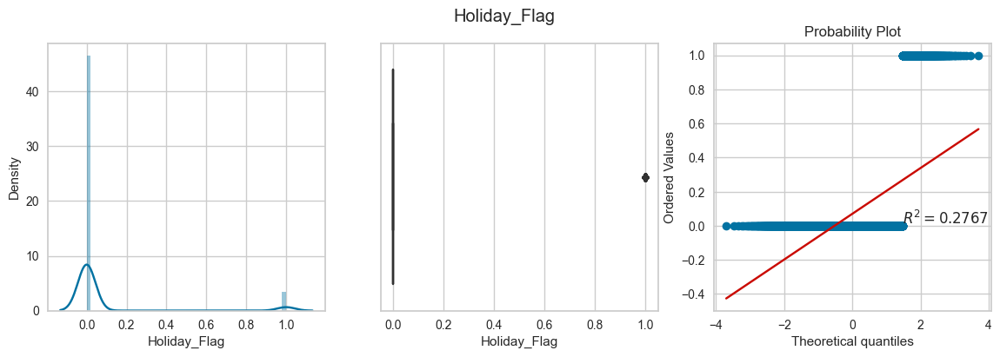

Skewness of Temperature: -0.3367676011075799
Kurtosis of Temperature: -0.6128009588453383


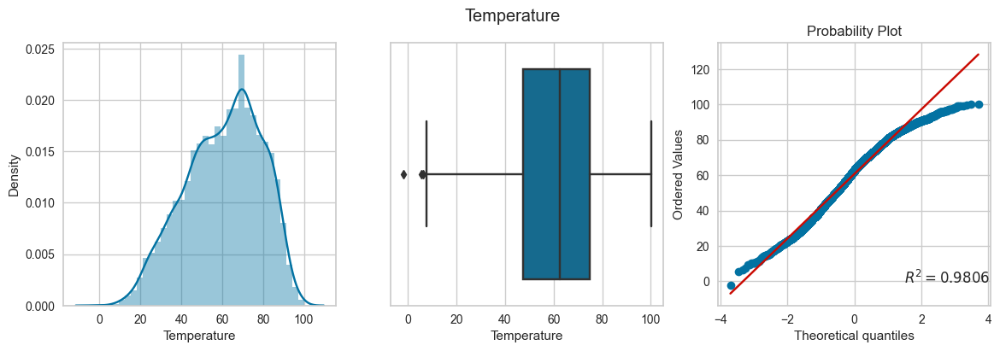

Skewness of Fuel_Price: -0.09615830011865549
Kurtosis of Fuel_Price: -1.1773777964906604


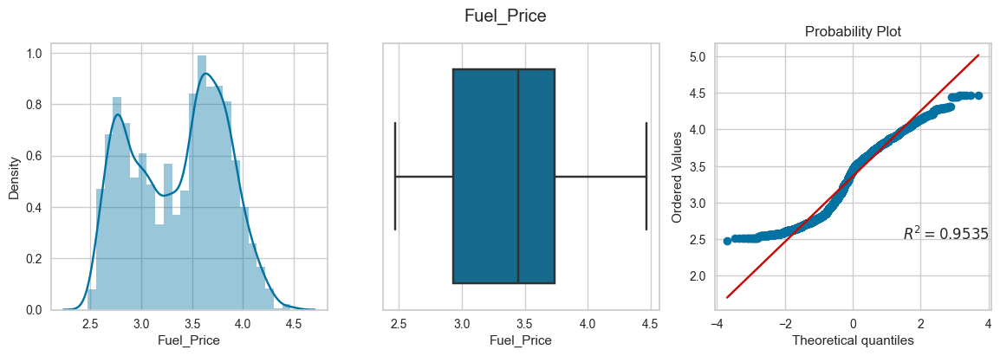

Skewness of CPI: 0.06349184988549494
Kurtosis of CPI: -1.8398133421838165


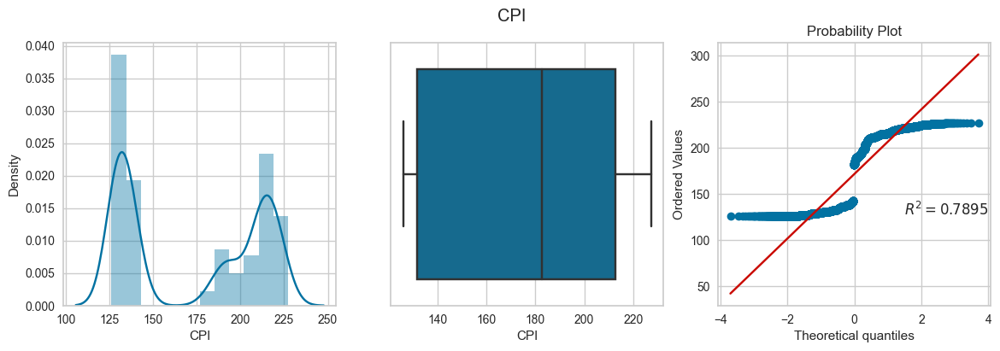

Skewness of Unemployment: 1.1881439334843265
Kurtosis of Unemployment: 2.639711784234234


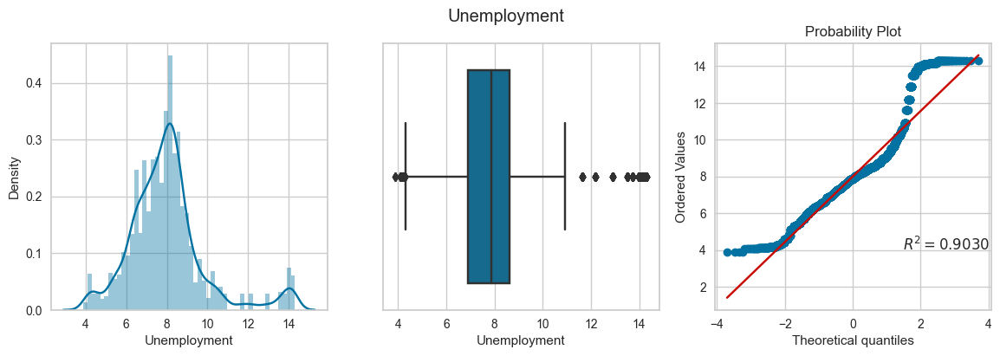

In [8]:
for col in df.select_dtypes(np.number).columns:
    plt.figure(figsize=(14,4))
    print(f"Skewness of {col}:",df[col].skew())
    print(f"Kurtosis of {col}:",df[col].kurtosis())
    plt.subplot(131)
    sns.distplot(df[col])
    plt.subplot(132)
    sns.boxplot(df[col])
    plt.subplot(133)
    probplot(df[col],rvalue=True,plot=plt,dist='norm')
    plt.suptitle(col)
    plt.show();

Normal Distribution: Store <br>
Left-Skewed Distribution: Temperature <br>
Right-Skewed Distribution: Weekly_Sales, Unemployment, Fuel_Price <br>
Bimodal Distribution: CPI <br>
Outlier Columns: Weekly_Sales, Temperature, Unemployment 

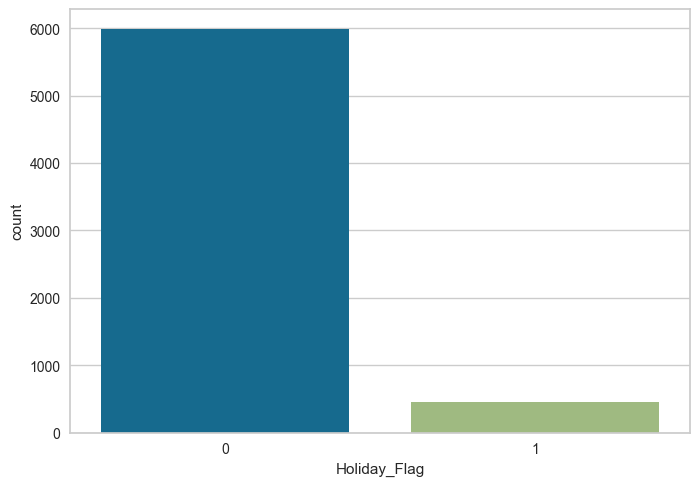

In [9]:
sns.countplot(df.Holiday_Flag);

There are very few holidays across the given time period.

### Bivariate Analysis

In [10]:
df.corr()['Weekly_Sales'].sort_values(ascending=False)[1:]

Holiday_Flag    0.036891
Fuel_Price      0.009464
Temperature    -0.063810
CPI            -0.072634
Unemployment   -0.106176
Store          -0.335332
Name: Weekly_Sales, dtype: float64

In [11]:
px.scatter(df,x='CPI',y='Weekly_Sales',color='Holiday_Flag',title='2D Scatter Plot of CPI and Weekly Sales')

In [12]:
px.scatter(df,x='Unemployment',y='Weekly_Sales',color='Holiday_Flag',title='2D Scatter Plot of Unemployment and Weekly Sales')

There is a very weak negative correlation between unemployment and weekly sales.

In [13]:
px.scatter(df,x='Temperature',y='Weekly_Sales',color='Holiday_Flag',title='2D Scatter Plot of Temperature and Weekly Sales')

There are burgeoning weekly sales during the sunny days and clear weather when temperature ranges between 25 deg C to 45 deg C.

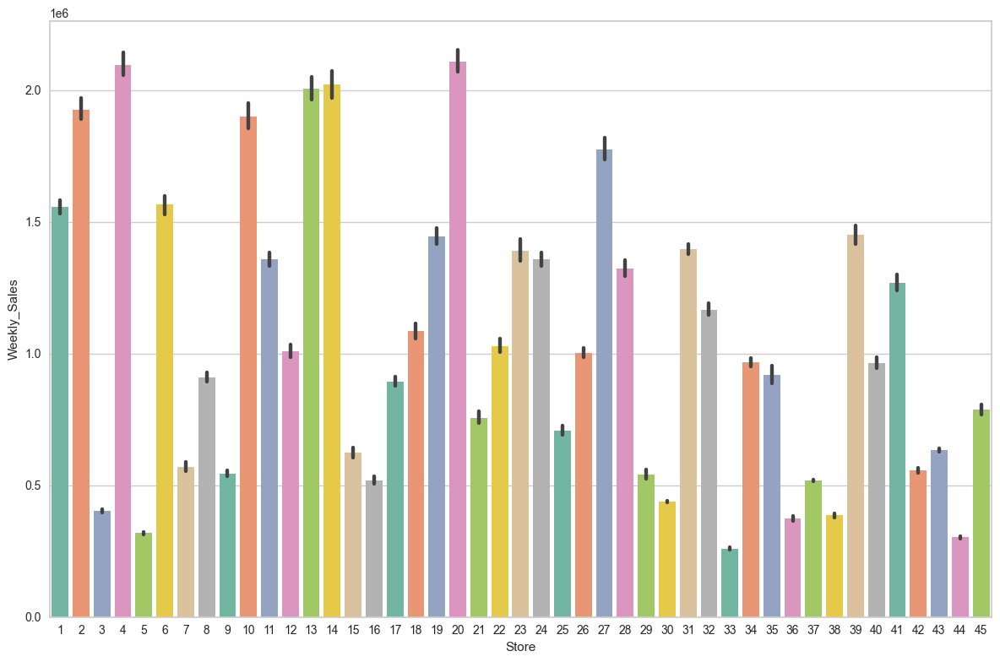

In [14]:
plt.figure(figsize=(12,8))
sns.barplot(x='Store',y='Weekly_Sales',data=df,palette='Set2')
plt.tight_layout();

Stores 4 and 20 have had the most flourishing sales whereas store 33 has had really poor sales.

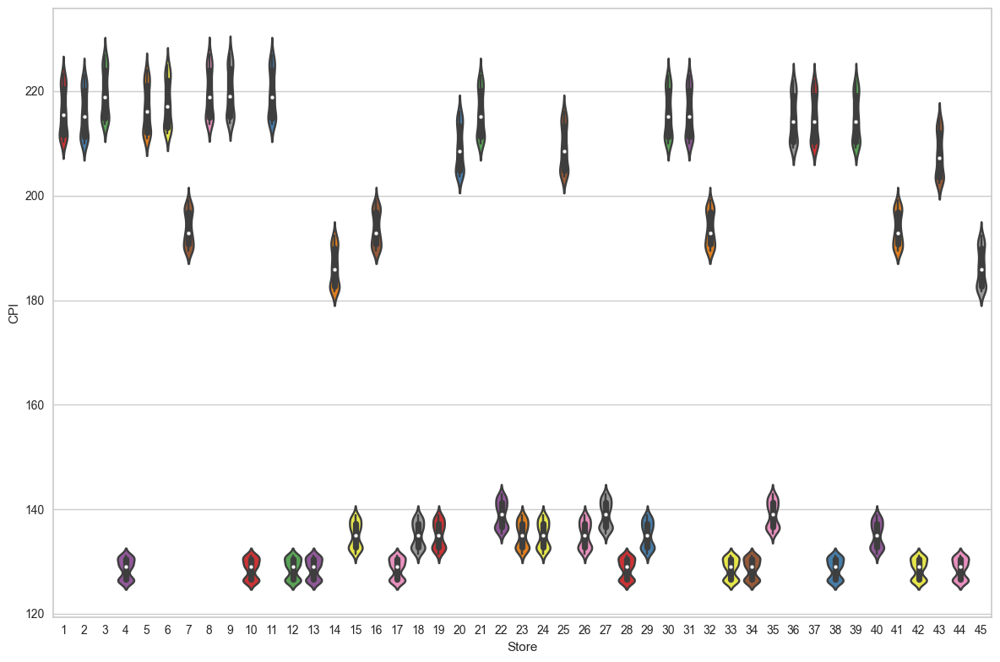

In [15]:
plt.figure(figsize=(12,8))
sns.violinplot(x='Store',y='CPI',data=df,palette='Set1')
plt.tight_layout();

Stores 3,8,9 and 11 have the highest Consumer Price Index (CPI) i.e. they have raised the selling price by a significant amount in the past few years. In simple words, these stores have undergone the most inflation from 2010 to 2012. On the other hand, there are many stores which have the lowest CPI such as stores 4,10,12,13,17,28,33,34,38,42 and 44.

In [16]:
holidays = df[df.Holiday_Flag == 1]
workdays = df[df.Holiday_Flag == 0]

In [17]:
workdays.describe()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,5985.000000,5.985000e+03,5985.0,5985.000000,5985.000000,5985.000000,5985.000000
mean,23.000000,1.041256e+06,0.0,61.448124,3.368467,171.601725,7.993514
std,12.988258,5.589574e+05,0.0,18.076892,0.461158,39.364794,1.875664
min,1.000000,2.099862e+05,0.0,-2.060000,2.472000,126.064000,3.879000
25%,12.000000,5.513784e+05,0.0,48.730000,2.932000,131.784000,6.891000
50%,23.000000,9.562112e+05,0.0,63.560000,3.475000,182.622509,7.874000
75%,34.000000,1.414344e+06,0.0,75.320000,3.744000,212.861131,8.595000
max,45.000000,3.818686e+06,0.0,100.140000,4.468000,227.232807,14.313000


In [18]:
holidays.describe()

,Store,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
count,450.000000,4.500000e+02,450.0,450.000000,450.000000,450.000000,450.000000
mean,23.000000,1.122888e+06,1.0,50.232044,3.227464,171.268092,8.074127
std,13.001627,6.276849e+05,0.0,20.071118,0.407934,39.291449,1.879293
min,1.000000,2.153592e+05,1.0,10.240000,2.513000,126.114581,4.077000
25%,12.000000,5.758655e+05,1.0,33.367500,2.943000,131.586613,7.015000
50%,23.000000,1.018538e+06,1.0,47.870000,3.179000,182.598178,7.890000
75%,34.000000,1.555213e+06,1.0,67.335000,3.546000,211.760416,8.625000
max,45.000000,3.004702e+06,1.0,96.220000,4.124000,226.210354,14.313000


Holidays have slightly more weekly sales as compared to normal days. This may be due to the festive seasons when a large number of consumers visit the retail stores for purchasing their desired goods, products and services at reasonable discounted rates. <br><br>
Temperatures are relatively lower in the holiday season in comparison to the normal working season.

### Multivariate Analysis

In [19]:
fig = px.scatter_3d(df,x='CPI',y='Weekly_Sales',z='Fuel_Price',color='Holiday_Flag',title='3D Scatter Plot of CPI and Weekly Sales')
fig.show()

Fuel price is generally lower during the holidays.

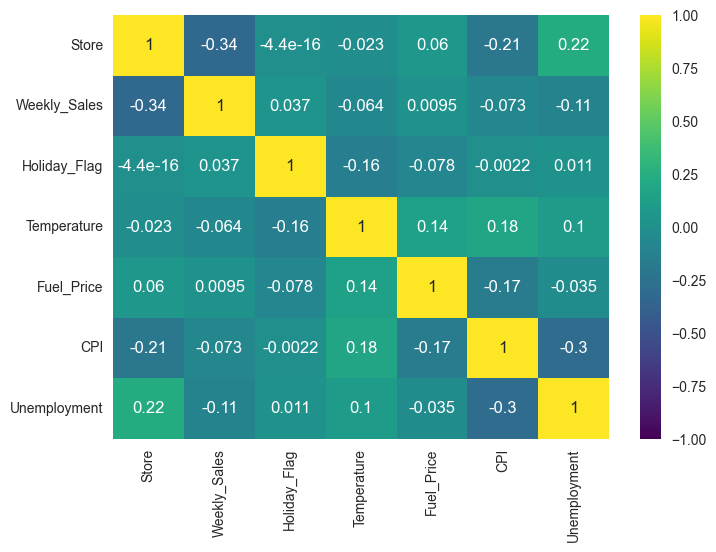

In [20]:
sns.heatmap(df.corr(),annot=True,cmap='viridis',vmin=-1.0,vmax=1.0);

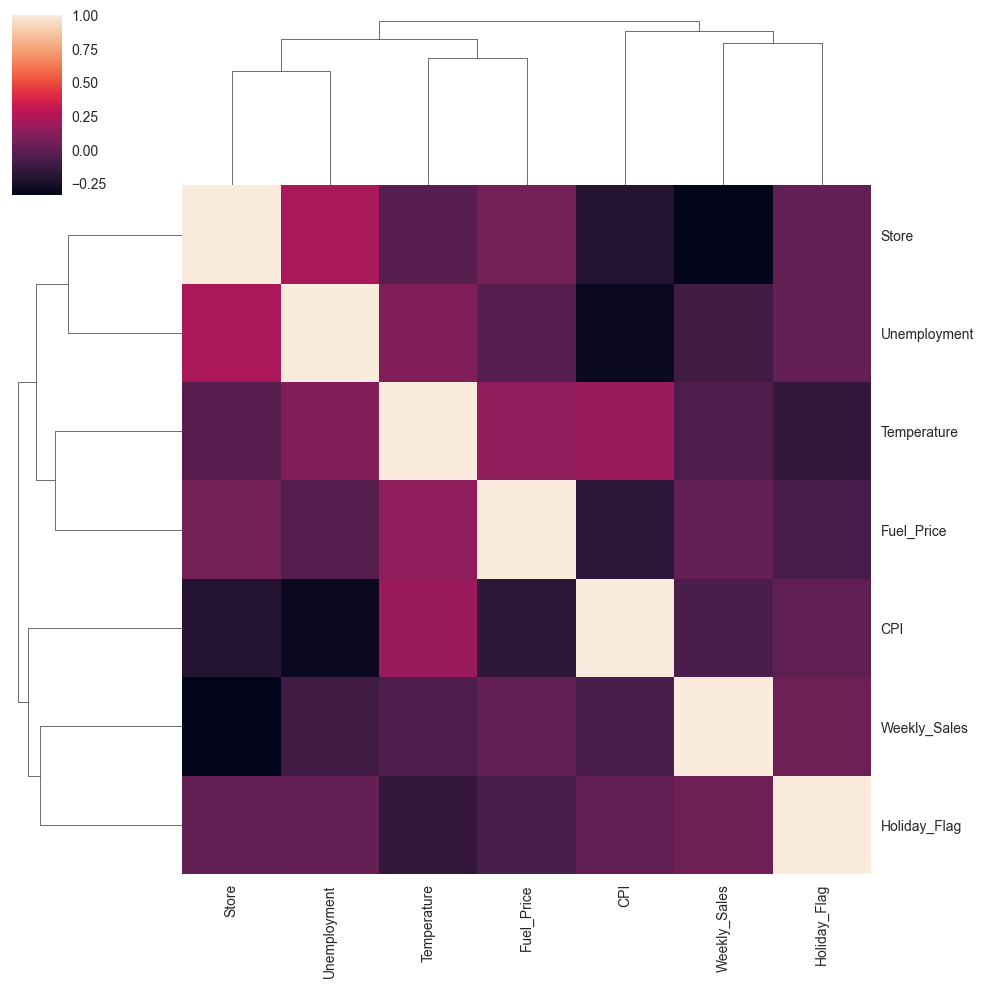

In [21]:
sns.clustermap(df.corr());

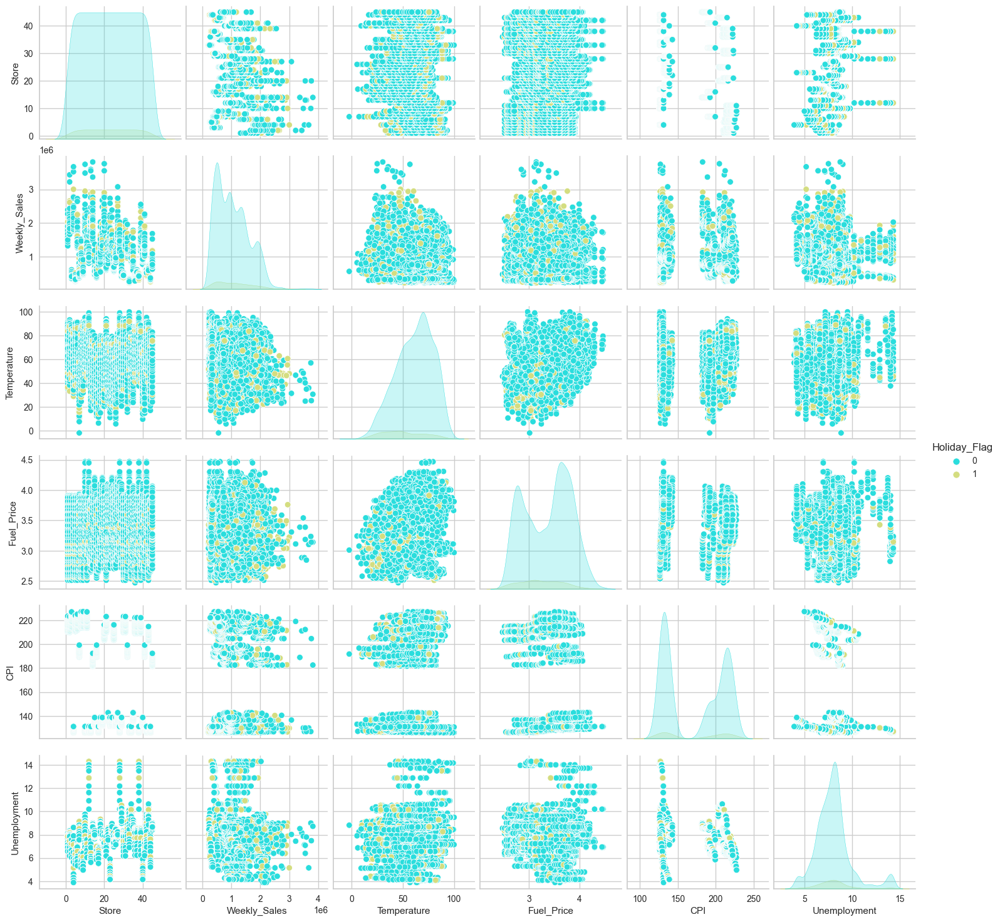

In [22]:
sns.pairplot(df,hue='Holiday_Flag',palette='rainbow');

## Feature Engineering

### Outlier Treatment

In [23]:
def remove_outliers(col):
    lower_limit, upper_limit = df[col].quantile([0.25,0.75])
    IQR = upper_limit - lower_limit
    lower_whisker = lower_limit - 1.5 * IQR
    upper_whisker = upper_limit + 1.5 * IQR
    return np.where(df[col]>upper_whisker,upper_whisker,np.where(df[col]<lower_whisker,lower_whisker,df[col]))

In [24]:
outlier_cols = ['Weekly_Sales','Temperature','Unemployment']

for col in outlier_cols:
    df[col] = remove_outliers(col)

### Feature Transformation

In [25]:
def apply_transform(transform,col):
    plt.figure(figsize=(14,4))
    plt.subplot(131)
    sns.distplot(df[col])
    plt.subplot(132)
    sns.boxplot(df[col])
    plt.subplot(133)
    probplot(df[col],rvalue=True,dist='norm',plot=plt)
    plt.suptitle(f'{col} Before Transform')
    plt.show()
    col_tf = transform.fit_transform(df[[col]])
    col_tf = np.array(col_tf).reshape(col_tf.shape[0])
    plt.figure(figsize=(14,4))
    plt.subplot(131)
    sns.distplot(col_tf)
    plt.subplot(132)
    sns.boxplot(col_tf)
    plt.subplot(133)
    probplot(col_tf,rvalue=True,dist='norm',plot=plt)
    plt.suptitle(f'{col} After Transform')
    plt.show();

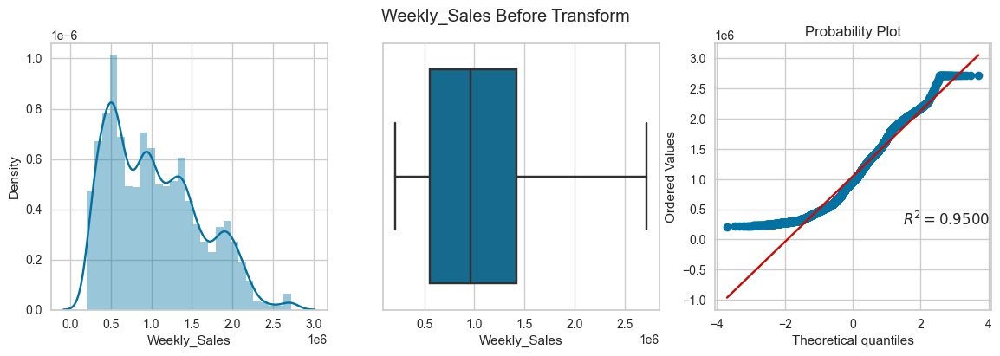

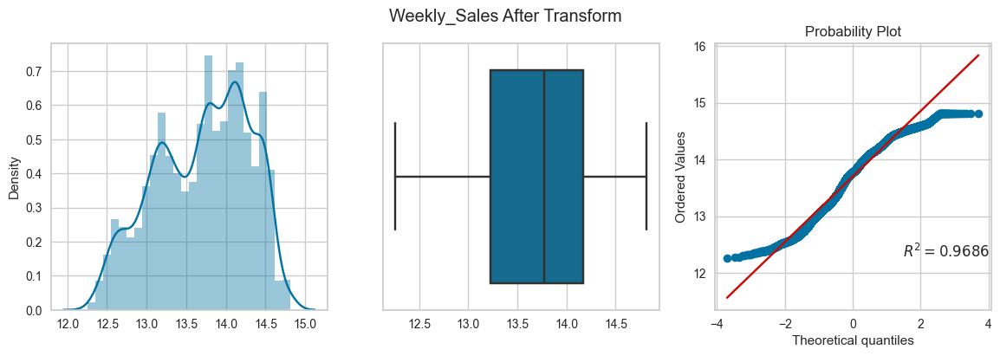

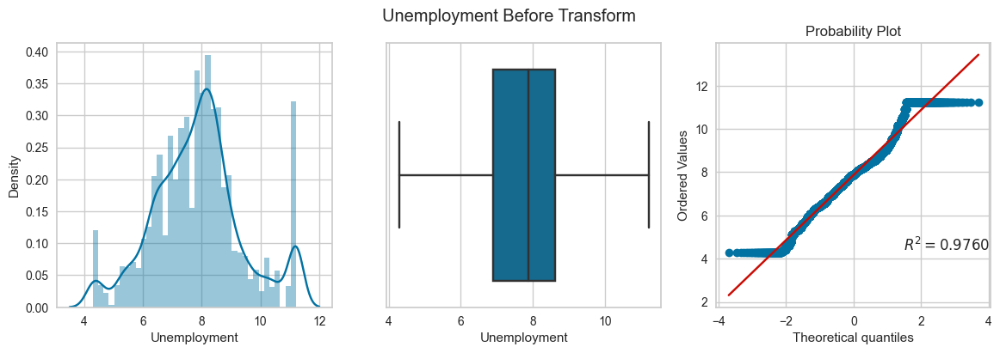

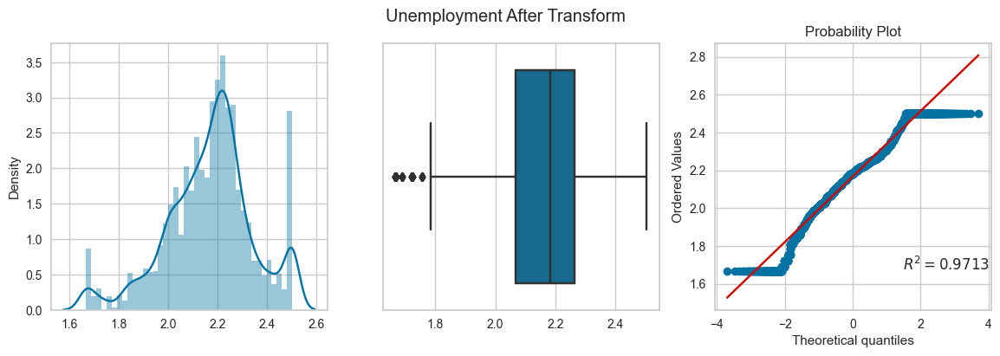

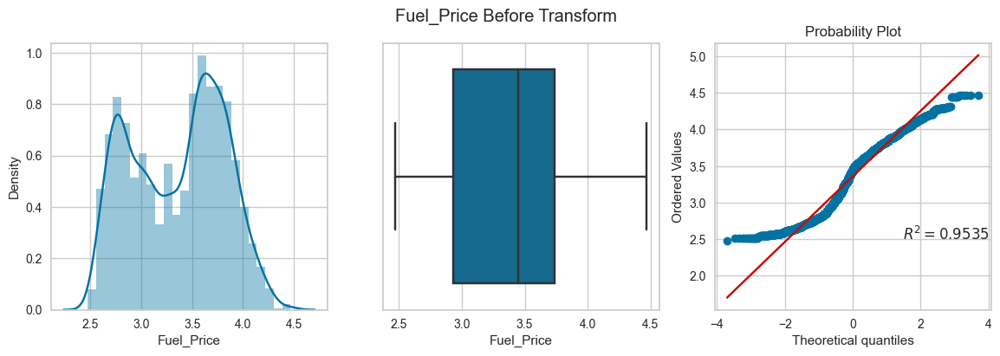

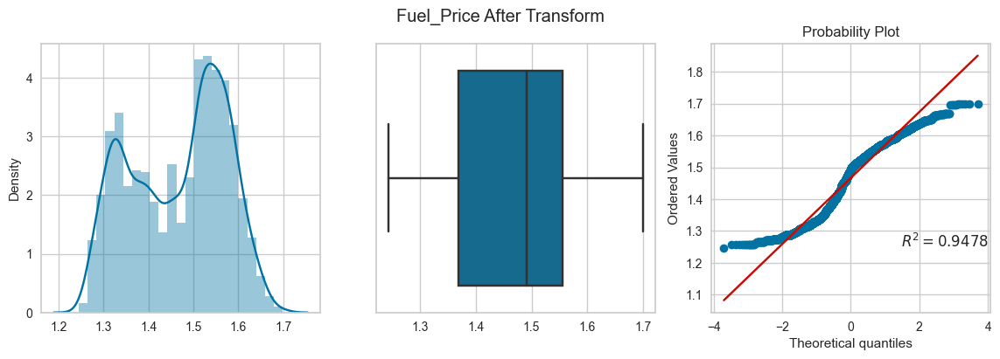

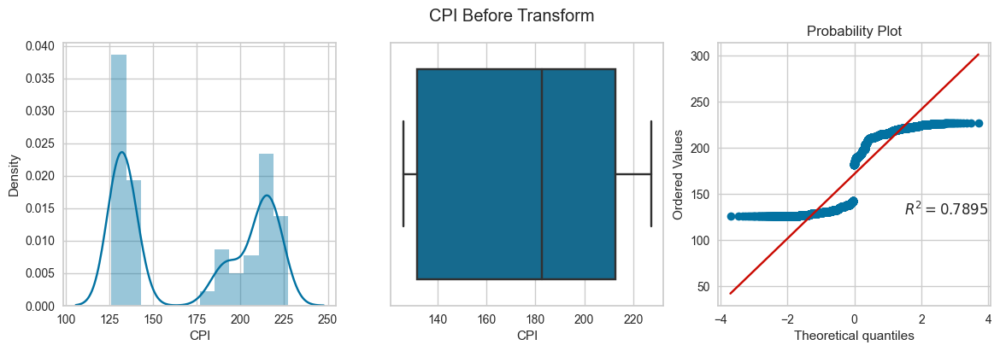

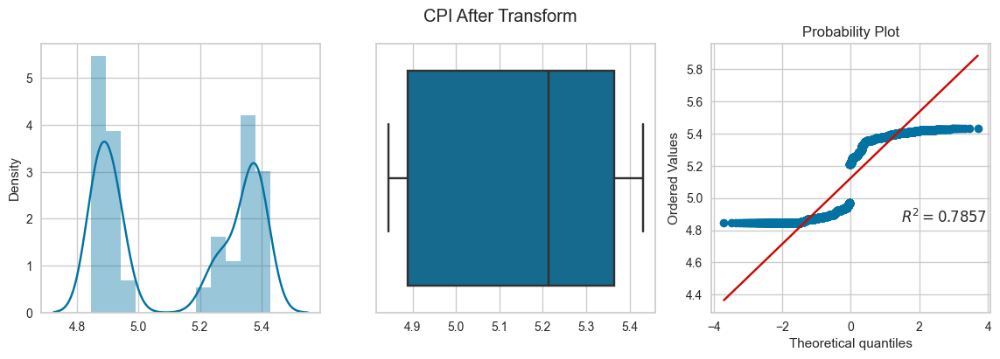

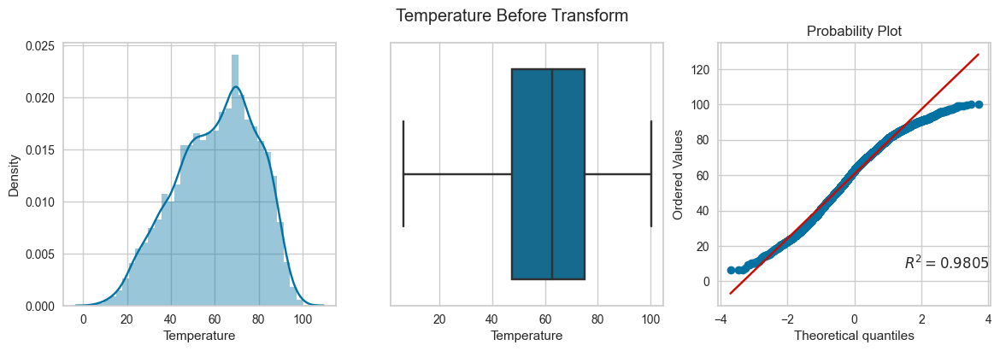

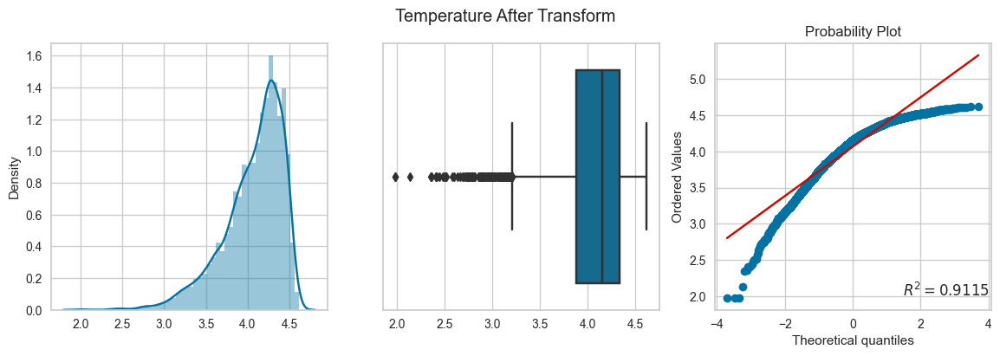

In [26]:
skewed_cols = ['Weekly_Sales','Unemployment','Fuel_Price','CPI','Temperature']

for col in skewed_cols:
    apply_transform(FunctionTransformer(np.log1p),col)

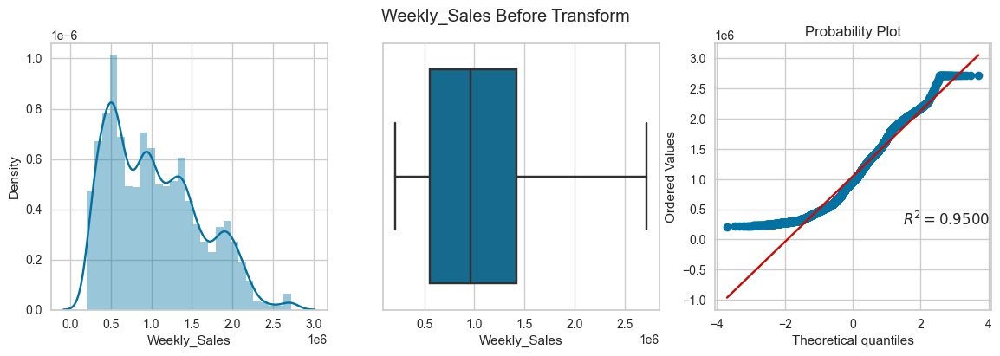

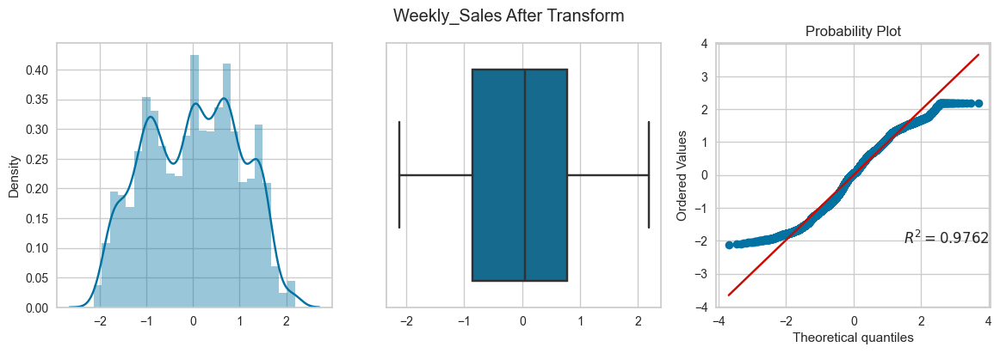

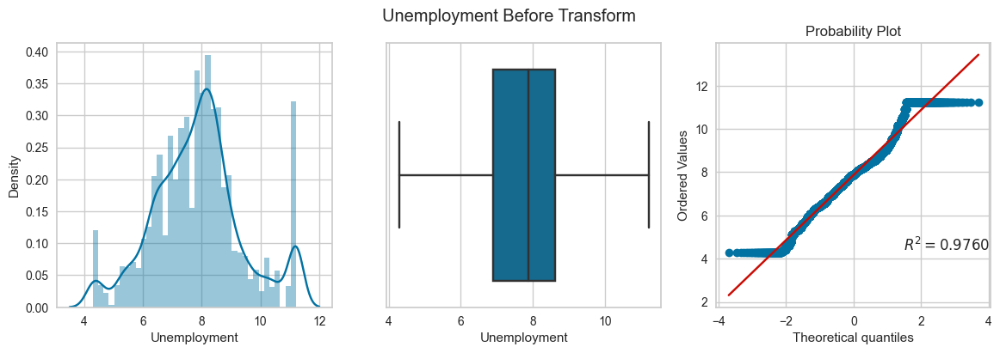

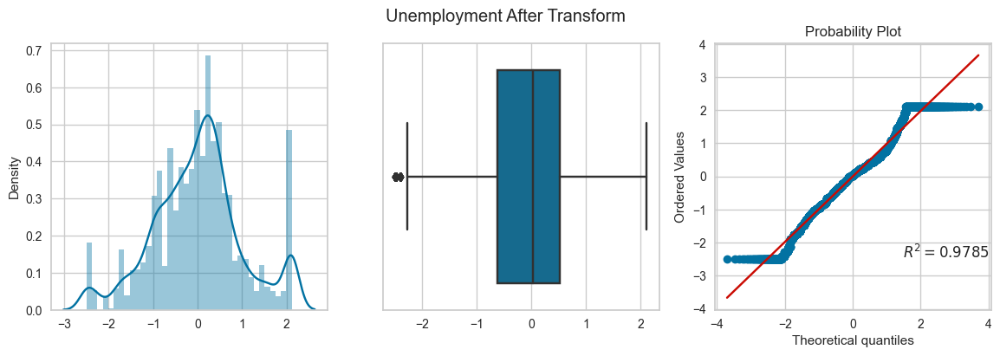

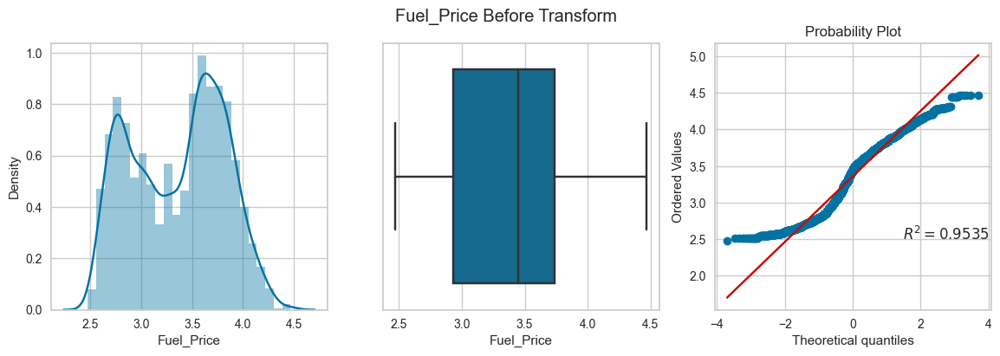

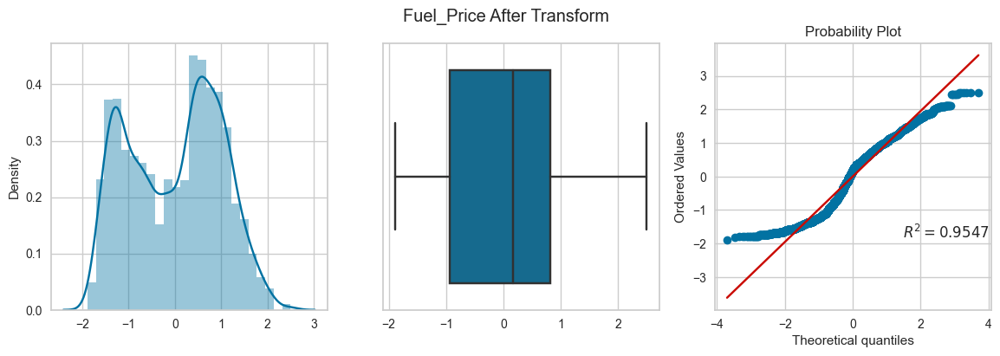

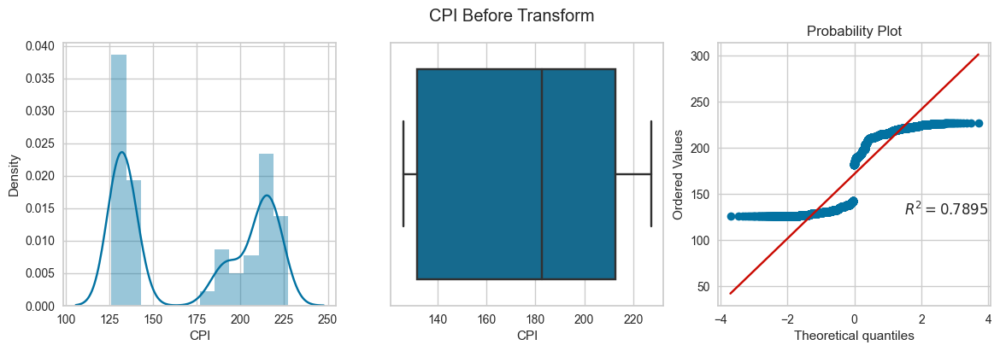

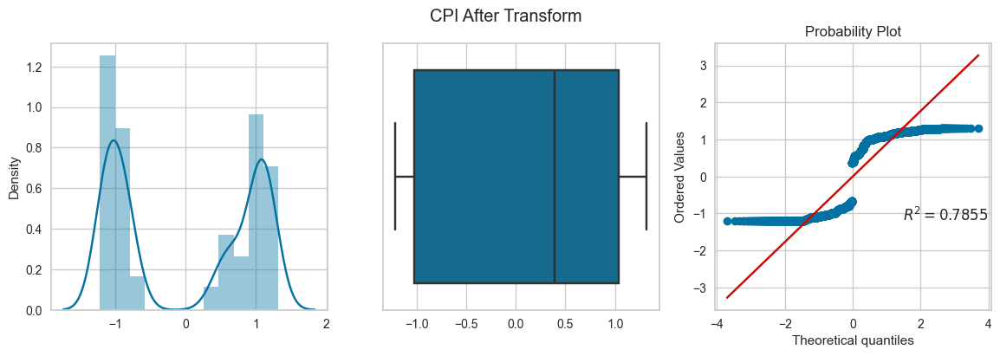

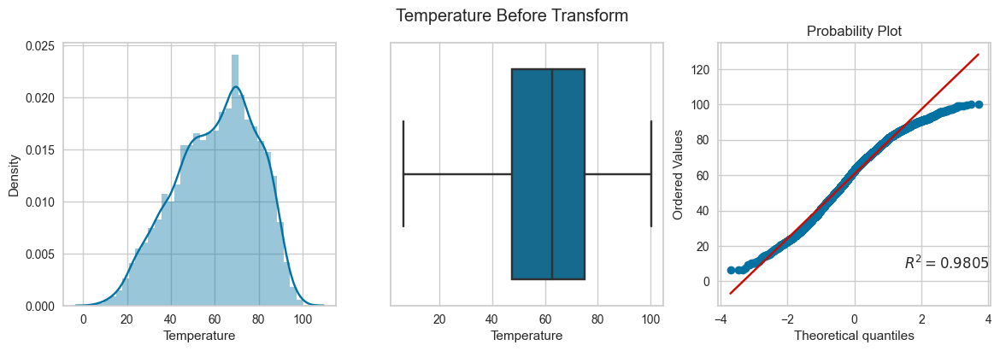

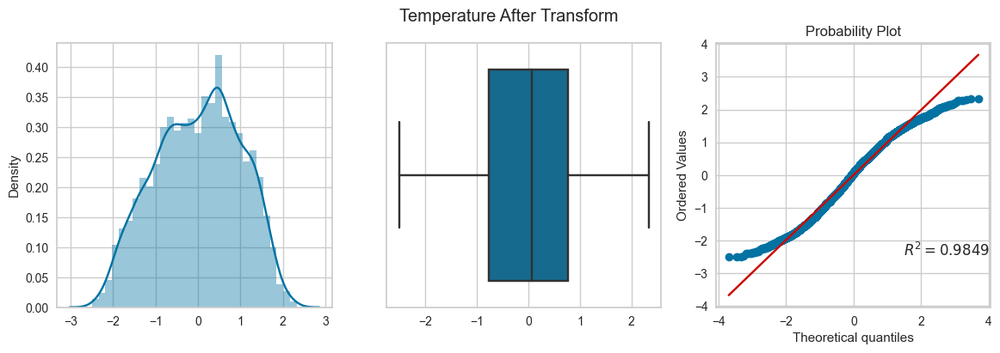

In [27]:
for col in skewed_cols:
    apply_transform(PowerTransformer(),col)

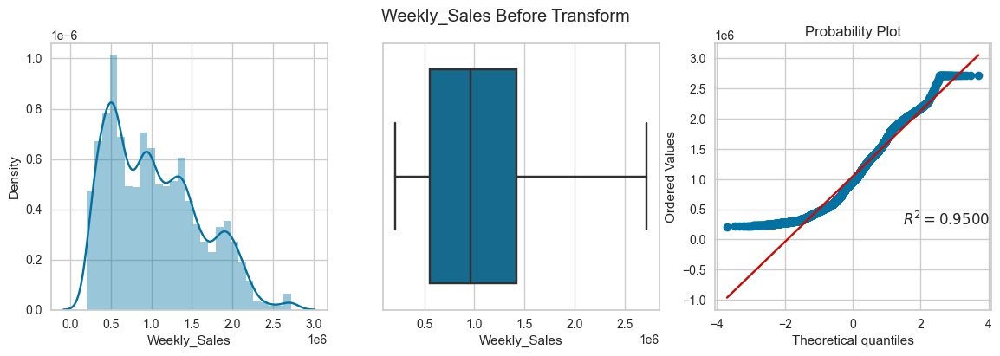

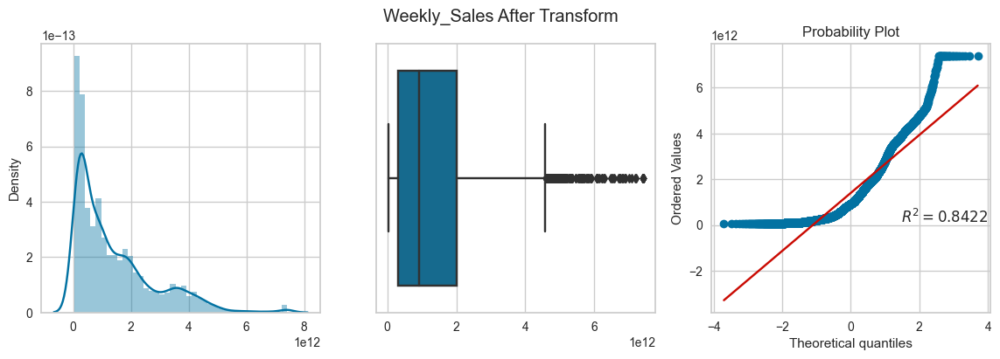

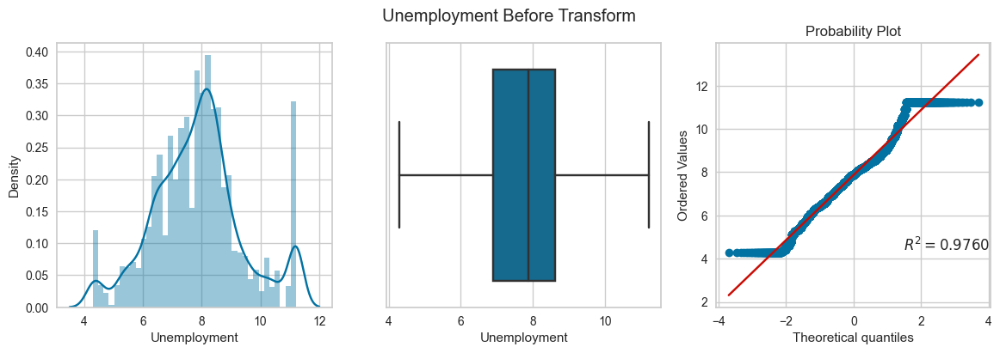

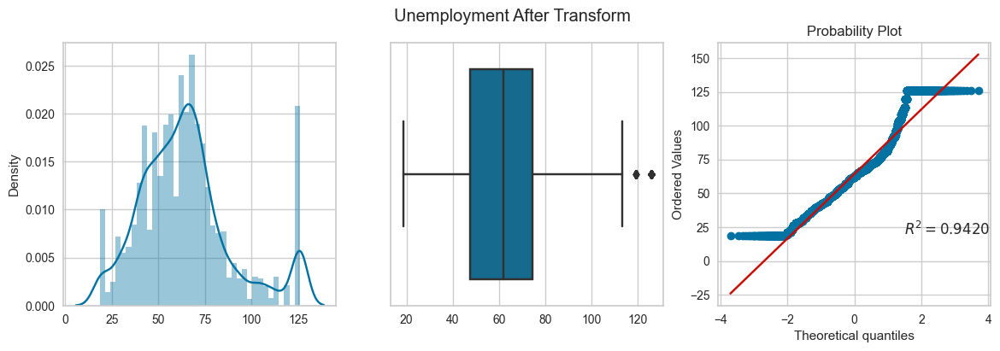

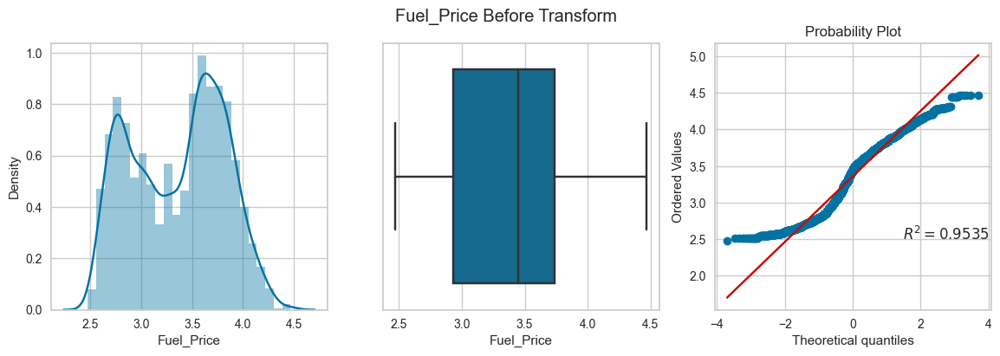

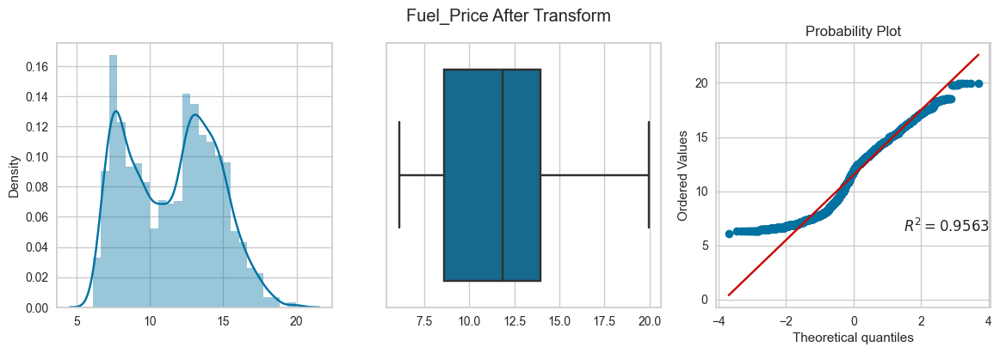

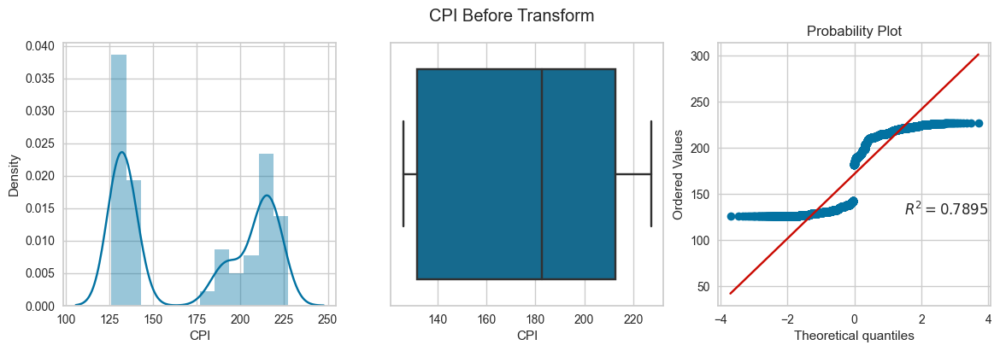

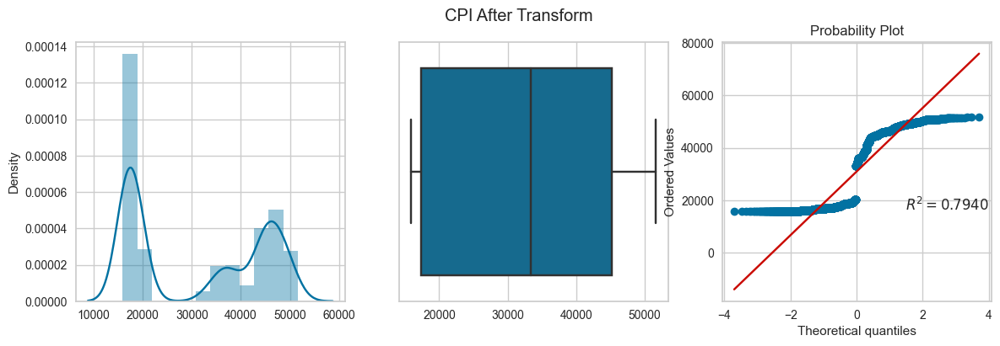

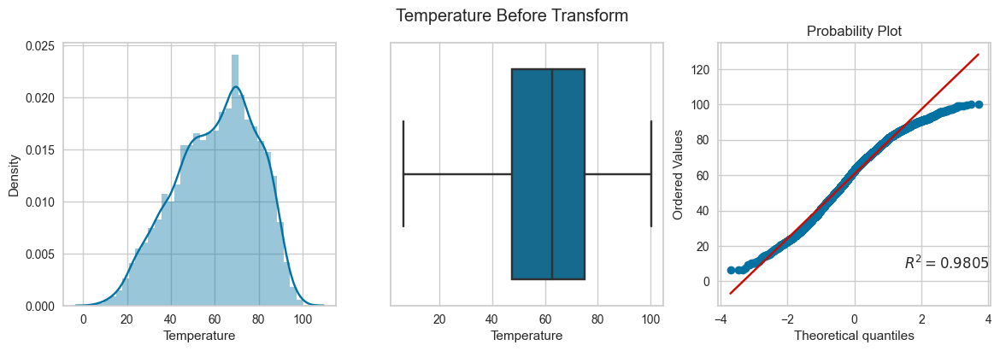

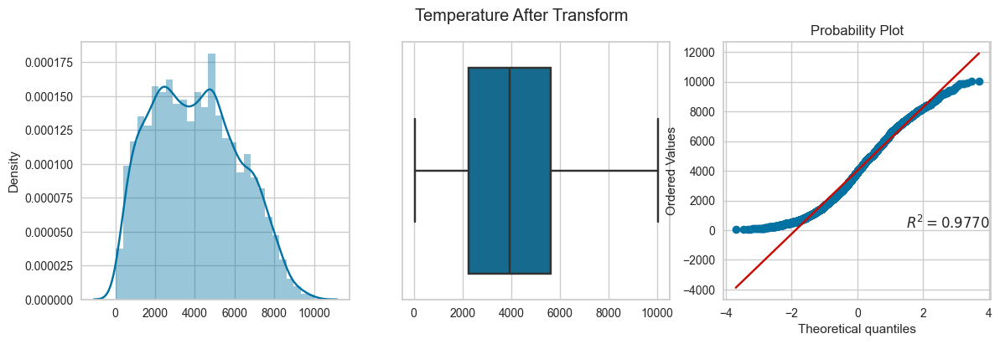

In [28]:
for col in skewed_cols:
    apply_transform(FunctionTransformer(lambda x: x**2),col)

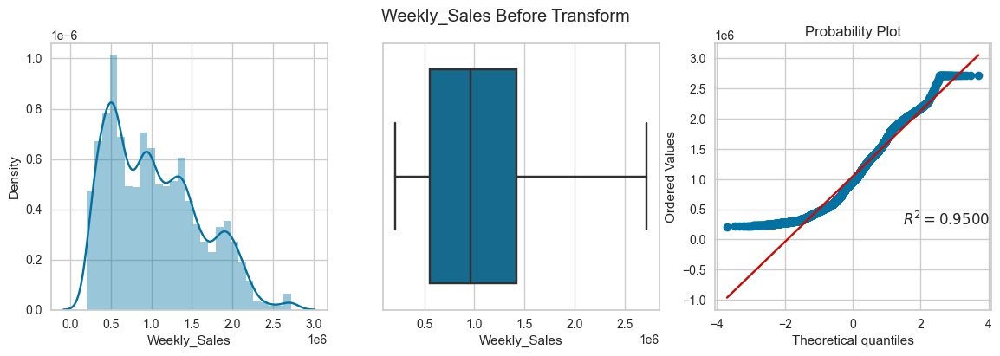

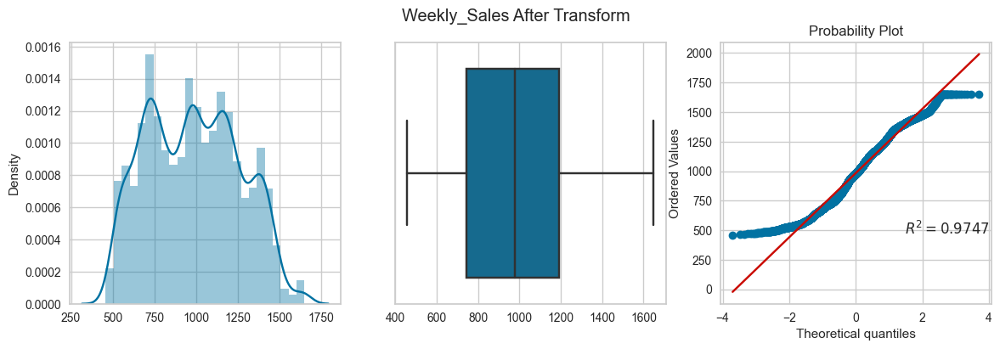

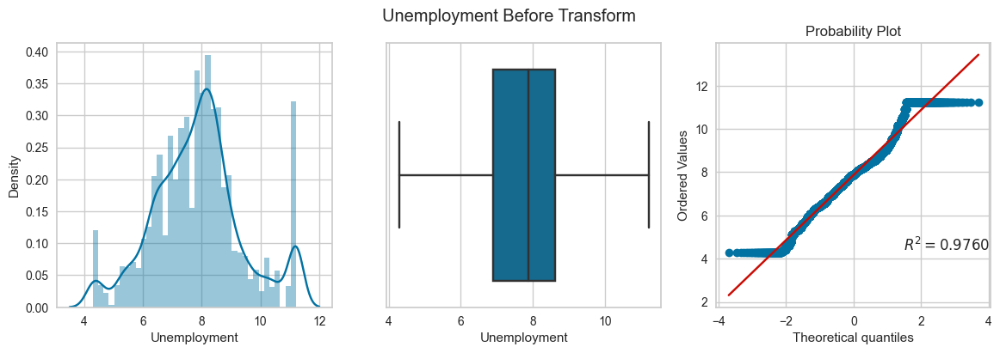

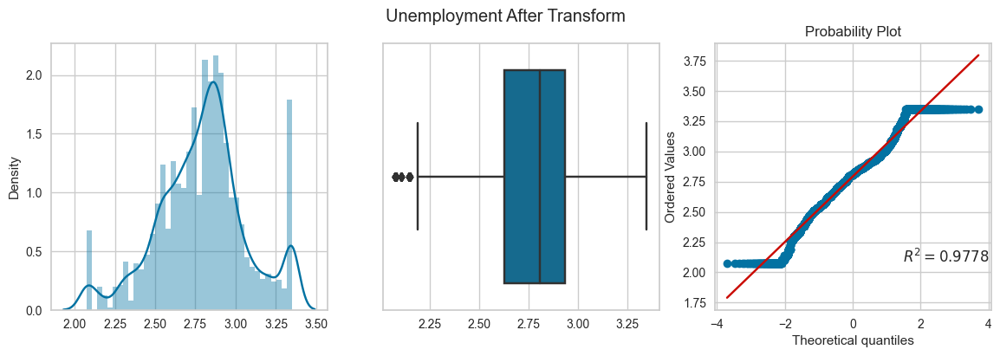

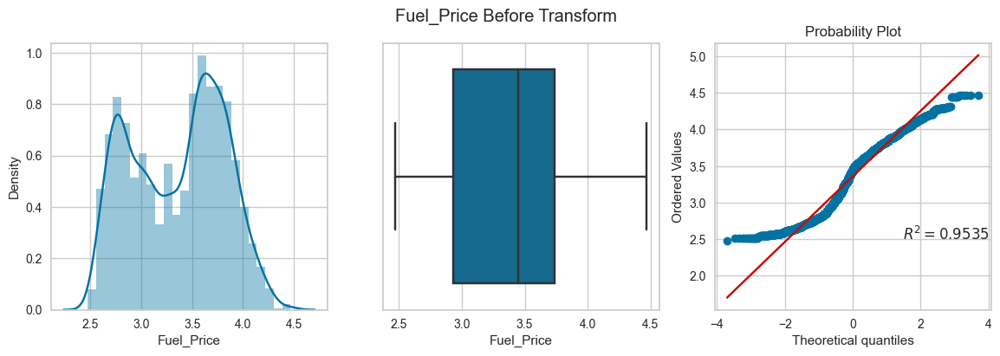

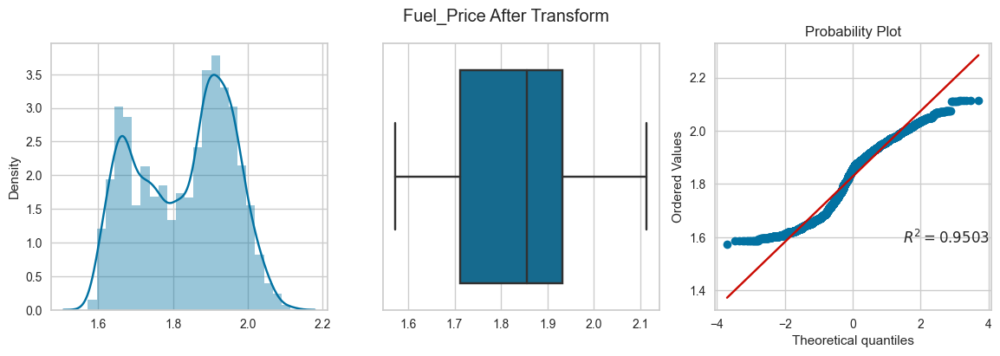

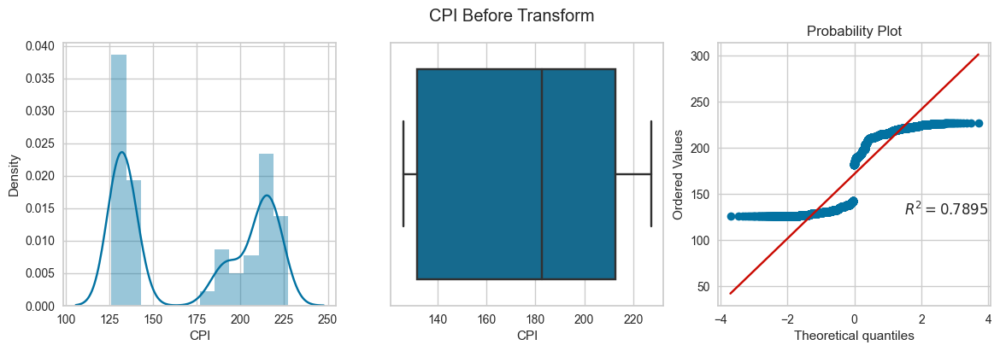

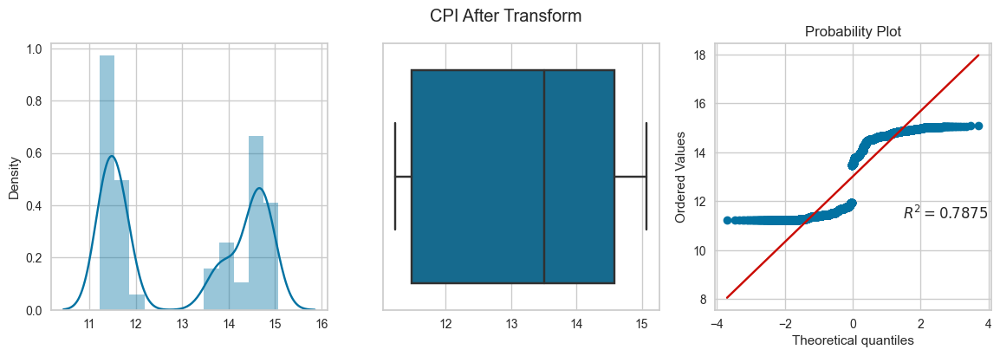

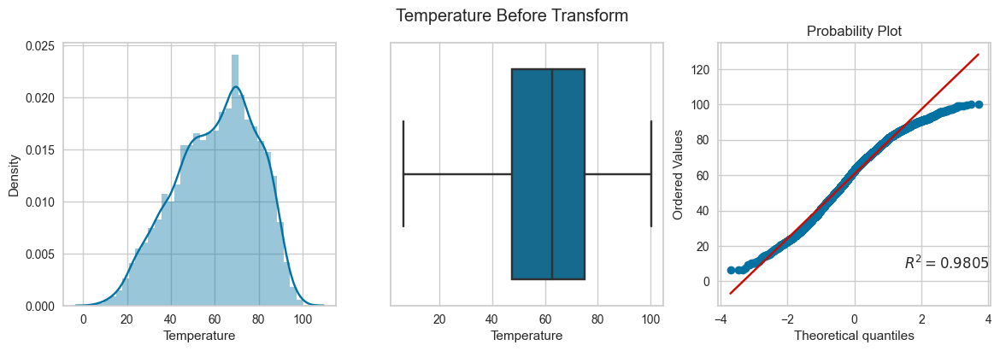

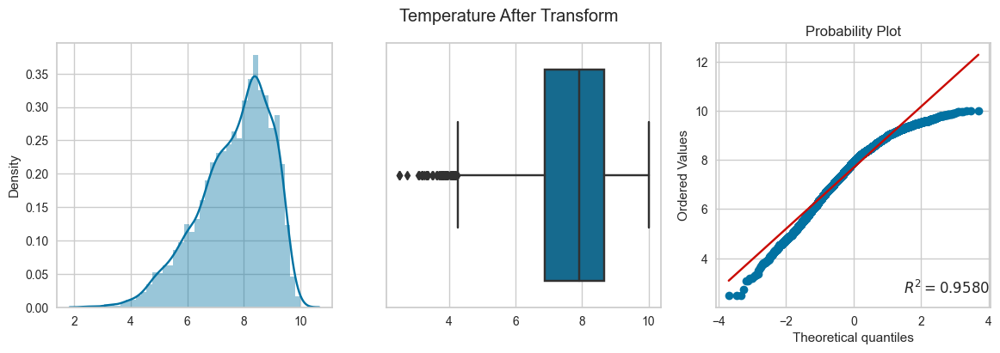

In [29]:
for col in skewed_cols:
    apply_transform(FunctionTransformer(np.sqrt),col)

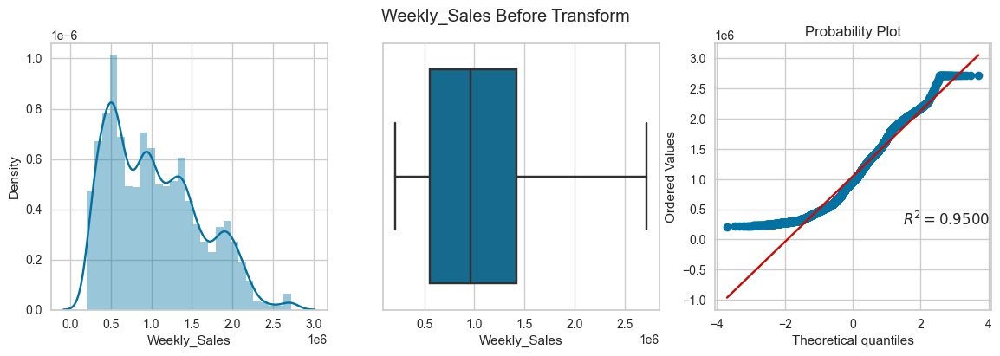

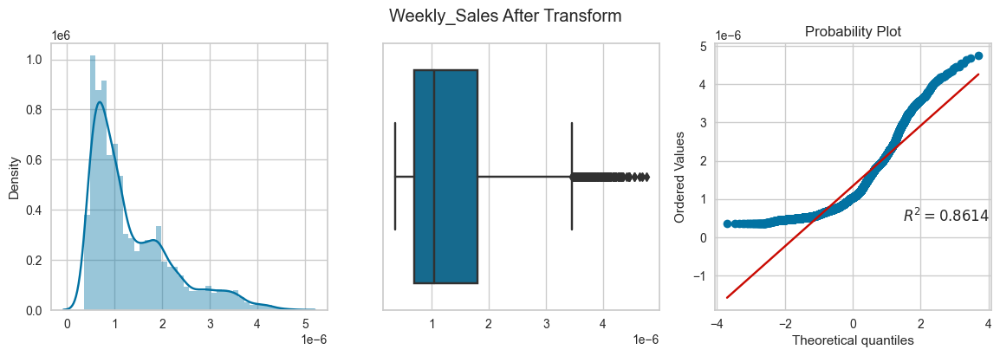

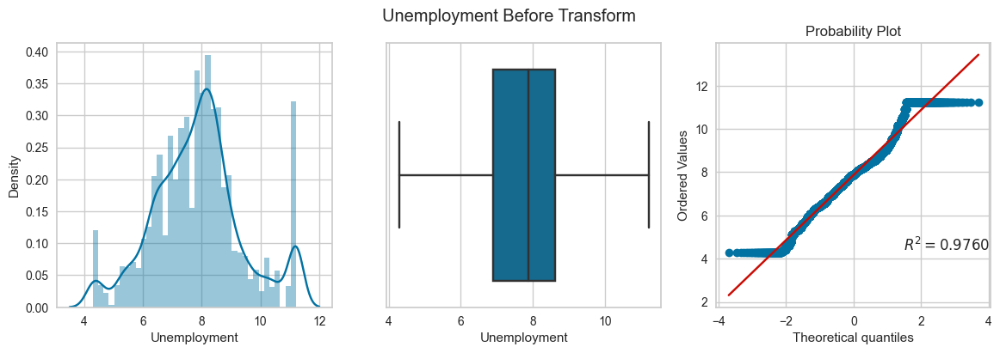

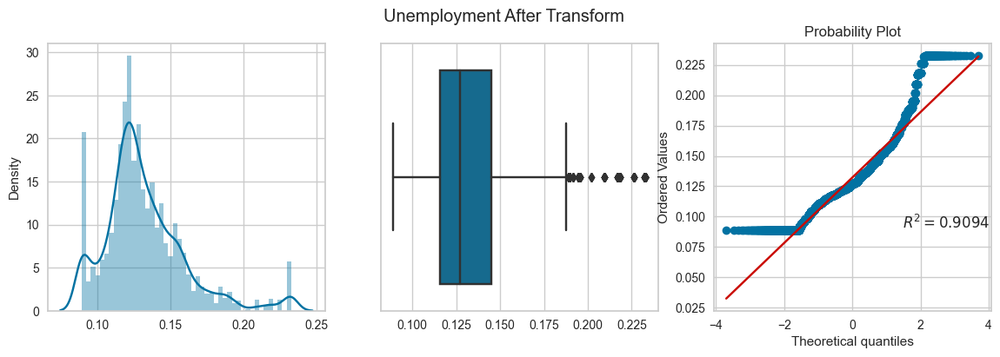

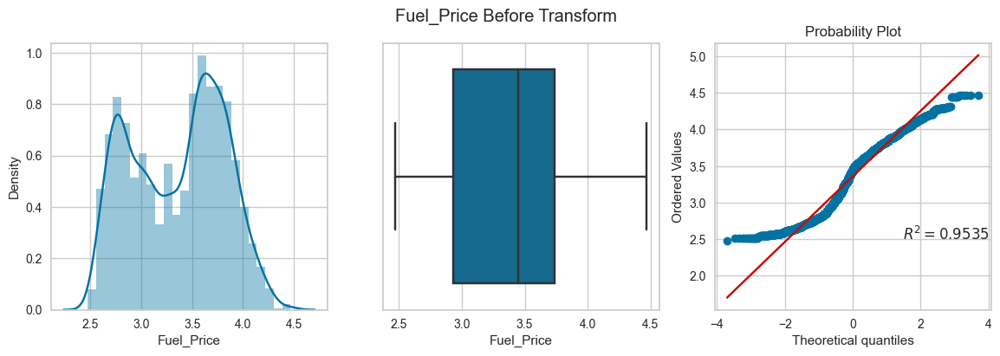

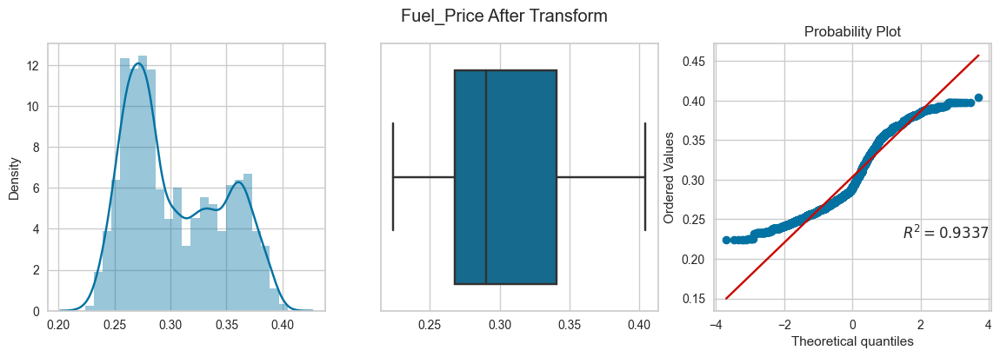

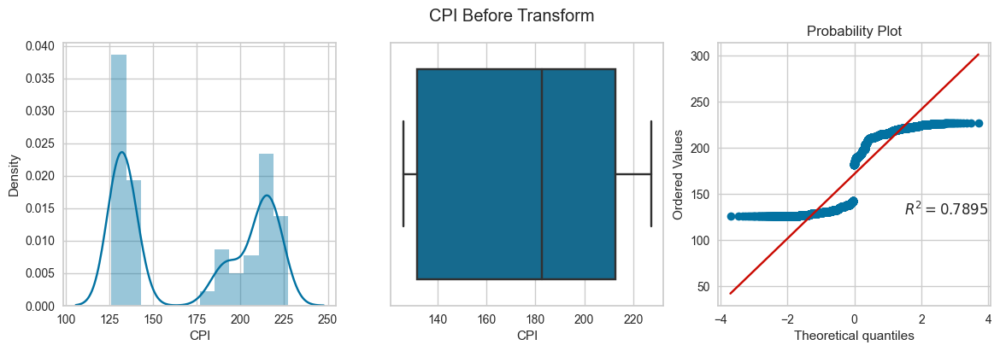

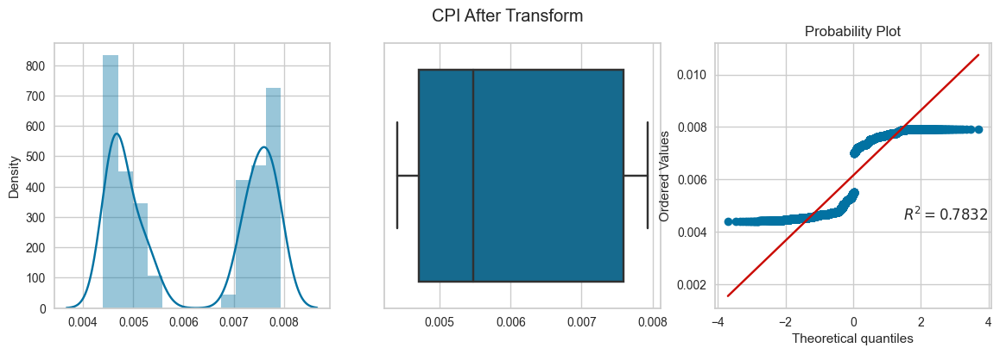

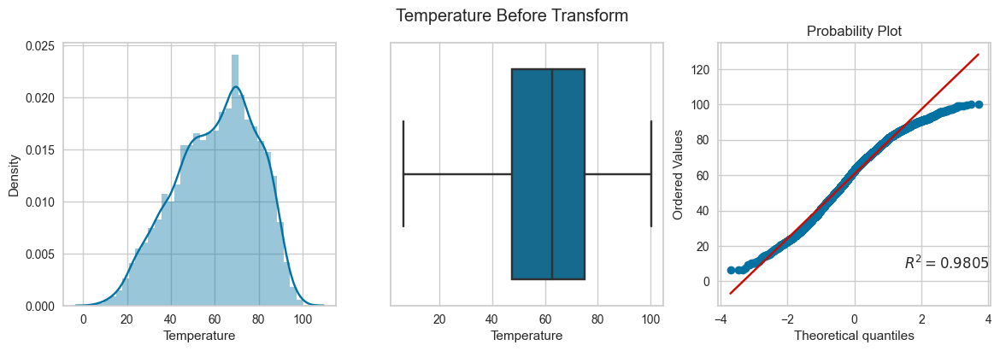

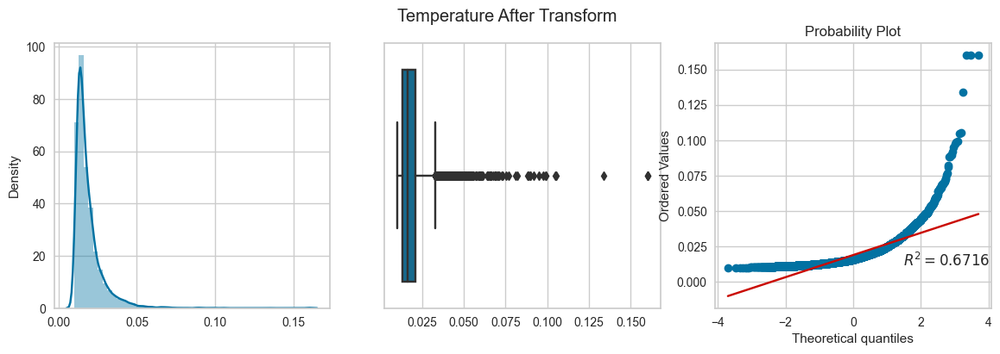

In [30]:
for col in skewed_cols:
    apply_transform(FunctionTransformer(lambda x: 1/(x+0.0000001)),col)

Log Transform: None <br>
Power Transform: Weekly_Sales, Unemployment, Temperature <br>
Sqrt Transform: None <br>
Square Transform: Fuel_Price, CPI <br>
Reciprocal Transform: None

In [31]:
pt = PowerTransformer()
pt_cols = ['Weekly_Sales','Unemployment','Temperature']

for col in pt_cols:
    col_tf = pt.fit_transform(df[[col]])
    col_tf = np.array(col_tf).reshape(col_tf.shape[0])
    df[col] = col_tf

In [32]:
ft = FunctionTransformer(lambda x: x**2)
ft_cols = ['Fuel_Price','CPI']

for col in ft_cols:
    col_tf = ft.fit_transform(df[[col]])
    col_tf = np.array(col_tf).reshape(col_tf.shape[0])
    df[col] = col_tf

### Feature Extraction

In [33]:
df.Date = pd.to_datetime(df.Date,errors='coerce')

In [34]:
df['Year'] = df.Date.dt.year
df['Month'] = df.Date.dt.month_name()
df['Day'] = df.Date.dt.day_name()
df['Days_In_Month'] = df.Date.dt.daysinmonth
df['Is_Leap_Year'] = df.Date.dt.is_leap_year
df['Is_Quarter_Start'] = df.Date.dt.is_quarter_start
df['Is_Quarter_End'] = df.Date.dt.is_quarter_end
df['Is_Year_End'] = df.Date.dt.is_year_end
df['Is_Month_Start'] = df.Date.dt.is_month_start
df['Is_Month_End'] = df.Date.dt.is_month_end
df['Day_Of_Year'] = df.Date.dt.day_of_year
df['Day_Of_Week'] = df.Date.dt.day_of_week

In [35]:
df.drop('Date',axis=1,inplace=True)

### Categorical Encoding

In [36]:
oe = OrdinalEncoder(categories=[['January','February','March','April','May','June','July','August','September','October','November','December']])
df.Month = oe.fit_transform(df[['Month']])
df.Month = df.Month.astype(int)

In [37]:
oe = OrdinalEncoder(categories=[['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']])
df.Day = oe.fit_transform(df[['Day']])
df.Day = df.Day.astype(int)

In [38]:
df.Is_Leap_Year = df.Is_Leap_Year.astype(int)
df.Is_Quarter_Start = df.Is_Quarter_Start.astype(int)
df.Is_Quarter_End = df.Is_Quarter_End.astype(int)
df.Is_Year_End = df.Is_Year_End.astype(int)
df.Is_Month_Start = df.Is_Month_Start.astype(int)
df.Is_Month_End = df.Is_Month_End.astype(int)

### Feature Splitting

In [39]:
X = df.drop('Weekly_Sales',axis=1)
y = df.Weekly_Sales

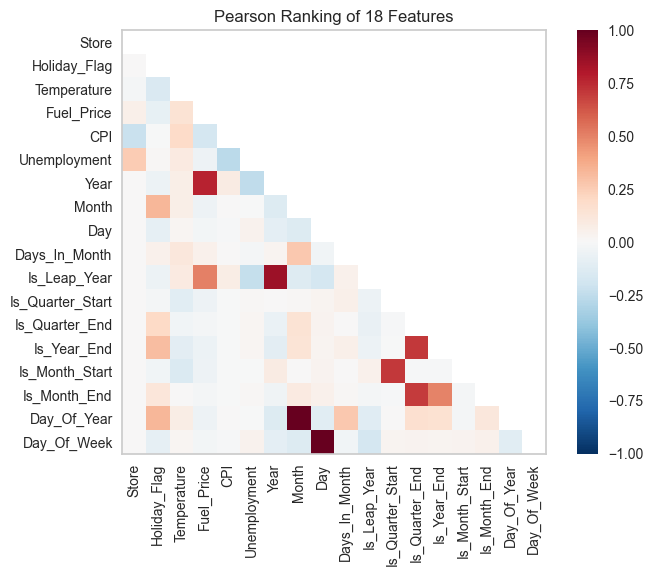

In [40]:
ranking_2d = Rank2D(algorithm='pearson')
ranking_2d.fit(X,y)
ranking_2d.transform(X)
ranking_2d.show();

In [41]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=101,shuffle=True)

### Feature Selection

In [42]:
kbest = SelectKBest(k=6,score_func=f_regression)
kbest.fit(X_train,y_train)

SelectKBest(k=6, score_func=<function f_regression at 0x000001BE01581090>)

In [43]:
selected_features = kbest.get_feature_names_out()
selected_features

array(['Store', 'Temperature', 'CPI', 'Unemployment', 'Month',
       'Day_Of_Year'], dtype=object)

In [44]:
percentile = SelectPercentile(percentile=30,score_func=f_regression)
percentile.fit(X_train,y_train)

SelectPercentile(percentile=30,
                 score_func=<function f_regression at 0x000001BE01581090>)

In [45]:
selected_features = percentile.get_feature_names_out()
selected_features

array(['Store', 'Temperature', 'CPI', 'Unemployment', 'Month',
       'Day_Of_Year'], dtype=object)

In [46]:
sfm = SelectFromModel(RandomForestRegressor(),threshold='median')
sfm.fit(X_train,y_train)

SelectFromModel(estimator=RandomForestRegressor(), threshold='median')

In [47]:
selected_features = sfm.get_feature_names_out()
selected_features

array(['Store', 'Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI',
       'Unemployment', 'Month', 'Day_Of_Year', 'Day_Of_Week'],
      dtype=object)

In [48]:
rfe = RFECV(estimator=RandomForestRegressor(),min_features_to_select=6,step=2,cv=5,verbose=1)
rfe.fit(X_train,y_train)

Fitting estimator with 18 features.
Fitting estimator with 16 features.
Fitting estimator with 14 features.
Fitting estimator with 12 features.
Fitting estimator with 10 features.
Fitting estimator with 8 features.
Fitting estimator with 18 features.
Fitting estimator with 16 features.
Fitting estimator with 14 features.
Fitting estimator with 12 features.
Fitting estimator with 10 features.
Fitting estimator with 8 features.
Fitting estimator with 18 features.
Fitting estimator with 16 features.
Fitting estimator with 14 features.
Fitting estimator with 12 features.
Fitting estimator with 10 features.
Fitting estimator with 8 features.
Fitting estimator with 18 features.
Fitting estimator with 16 features.
Fitting estimator with 14 features.
Fitting estimator with 12 features.
Fitting estimator with 10 features.
Fitting estimator with 8 features.
Fitting estimator with 18 features.
Fitting estimator with 16 features.
Fitting estimator with 14 features.
Fitting estimator with 12 featur

RFECV(cv=5, estimator=RandomForestRegressor(), min_features_to_select=6, step=2,
      verbose=1)

In [49]:
selected_features = rfe.get_feature_names_out()
selected_features

array(['Store', 'Holiday_Flag', 'Temperature', 'Fuel_Price', 'CPI',
       'Unemployment', 'Year', 'Month', 'Day', 'Days_In_Month',
       'Day_Of_Year', 'Day_Of_Week'], dtype=object)

In [50]:
sfs = SequentialFeatureSelector(estimator=RandomForestRegressor(),n_features_to_select=6,direction='forward',cv=3)
sfs.fit(X_train,y_train)

SequentialFeatureSelector(cv=3, estimator=RandomForestRegressor(),
                          n_features_to_select=6)

In [51]:
selected_features = sfs.get_feature_names_out()
selected_features

array(['Store', 'Holiday_Flag', 'CPI', 'Unemployment', 'Day',
       'Day_Of_Year'], dtype=object)

In [52]:
lasso = SelectFromModel(estimator=LassoCV(),threshold='0.95*mean')
lasso.fit(X_train,y_train)

SelectFromModel(estimator=LassoCV(), threshold='0.95*mean')

In [53]:
selected_features = lasso.get_feature_names_out()
selected_features

array(['Store'], dtype=object)

In [54]:
rf = RandomForestRegressor()
rf.fit(X_train,y_train)

RandomForestRegressor()

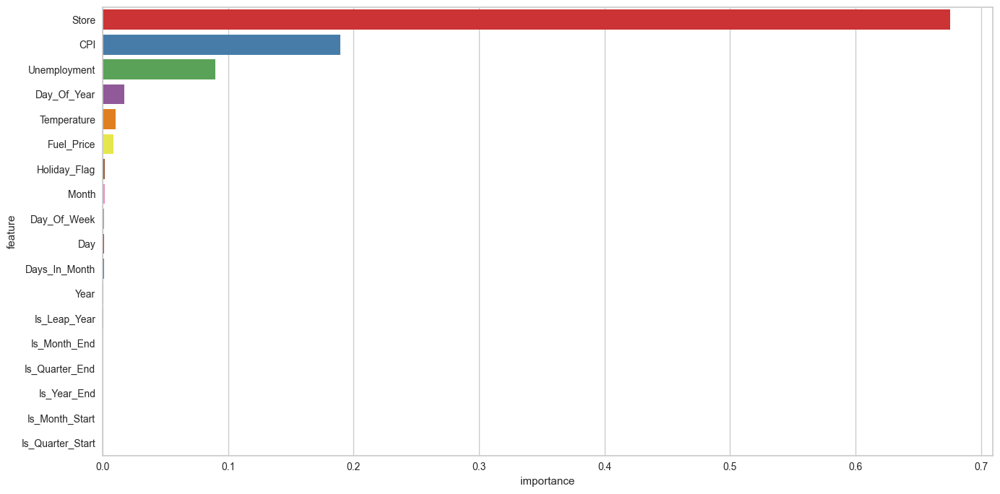

In [55]:
feat_imps = pd.DataFrame({'feature': X_train.columns, 'importance': rf.feature_importances_}).sort_values('importance',ascending=False)
plt.figure(figsize=(14,7))
sns.barplot(x='importance',y='feature',data=feat_imps,orient='horizontal',palette='Set1')
plt.tight_layout();

In [56]:
df.corr()['Weekly_Sales'].sort_values(ascending=False)[1:]

Month               0.050730
Day_Of_Year         0.048769
Holiday_Flag        0.029496
Fuel_Price          0.016294
Is_Leap_Year       -0.006772
Days_In_Month      -0.008107
Year               -0.009913
Is_Month_Start     -0.011720
Is_Quarter_Start   -0.011894
Is_Year_End        -0.020678
Day                -0.020999
Day_Of_Week        -0.020999
Is_Month_End       -0.022571
Is_Quarter_End     -0.025321
CPI                -0.082511
Temperature        -0.085931
Unemployment       -0.087557
Store              -0.308973
Name: Weekly_Sales, dtype: float64

Final selected features: Store, CPI, Unemployment, Day_Of_Year, Temperature, Month, Holiday_Flag

In [57]:
selected_features = ['Store','CPI','Unemployment','Day_Of_Year','Temperature','Month','Holiday_Flag']

X_train = X_train[selected_features]
X_test = X_test[selected_features]

### Feature Scaling

In [58]:
scaler = StandardScaler()
features = X_train.columns
X_train = scaler.fit_transform(X_train)
X_train = pd.DataFrame(X_train,columns=features)
X_test = scaler.transform(X_test)
X_test = pd.DataFrame(X_test,columns=features)
X_train.head()

,Store,CPI,Unemployment,Day_Of_Year,Temperature,Month,Holiday_Flag
0,1.304226,-0.974622,-1.870001,-0.865484,-2.253026,-0.728108,-0.268562
1,1.458359,-1.013378,-0.580989,1.183872,0.511933,1.078226,-0.268562
2,-1.470166,-1.054563,-1.270860,-0.234913,0.109179,-0.125997,-0.268562
3,-1.470166,-1.109167,-0.292376,-1.397529,0.695575,-1.330220,-0.268562
4,-1.470166,-1.039096,-1.848716,0.740502,-1.509232,0.777170,-0.268562


## Model Training & Evaluation

In [59]:
models = []
mape_scores = []
rmse_scores = []
r2_scores = []

In [144]:
def train_and_evaluate_model(model):
    model.fit(X_train,y_train)
    pred = model.predict(X_test)
    mape = mean_absolute_percentage_error(y_test,pred)
    print("Mean Absolute Percentage Error(MAPE):",mape)
    mape_scores.append(mape)
    rmse = np.sqrt(mean_squared_error(y_test,pred))
    print("Root Mean Squared Error(RMSE):",rmse)
    rmse_scores.append(rmse)
    r2 = r2_score(y_test,pred)
    print("R2 Score:",r2)
    r2_scores.append(r2)
    models.append(model)
    
    if re.search('catboost',str(model)) == None or re.search('Voting',str(model)) != None:
        residuals_plot = ResidualsPlot(model)
        residuals_plot.fit(X_train,y_train)
        residuals_plot.score(X_test,y_test)
        residuals_plot.show()
        predictions_error = PredictionError(model)
        predictions_error.score(X_train,y_train)
        predictions_error.fit(X_train,y_train)
        predictions_error.show()

        if str(model) == 'LassoCV()':
            visualizer = AlphaSelection(LassoCV(alphas=np.logspace(-10,10,400)))
            visualizer.fit(X_train,y_train)
            visualizer.show()
        elif str(model) == 'RidgeCV()':
            visualizer = AlphaSelection(RidgeCV(alphas=np.logspace(-10,10,400)))
            visualizer.fit(X_train,y_train)
            visualizer.show()
        elif str(model) == 'ElasticNetCV()':
            visualizer = AlphaSelection(ElasticNetCV(alphas=np.logspace(-10,10,400)))
            visualizer.fit(X_train,y_train)
            visualizer.show()

Mean Absolute Percentage Error(MAPE): 1.8588602855362242
Root Mean Squared Error(RMSE): 0.9428056032781673
R2 Score: 0.13166572867067572


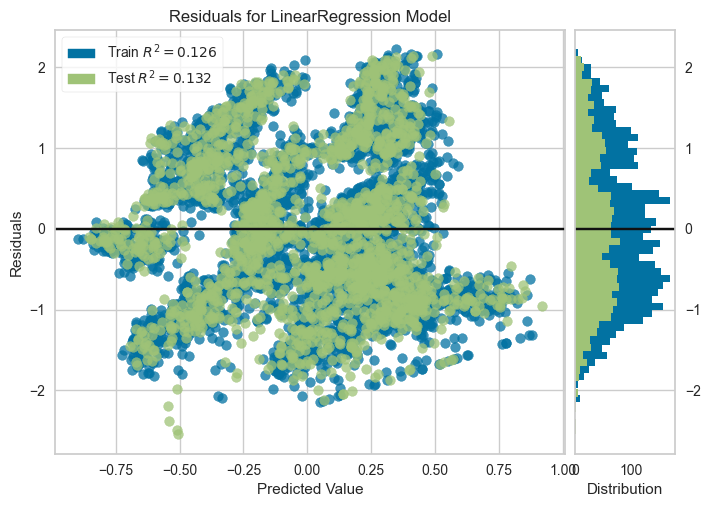

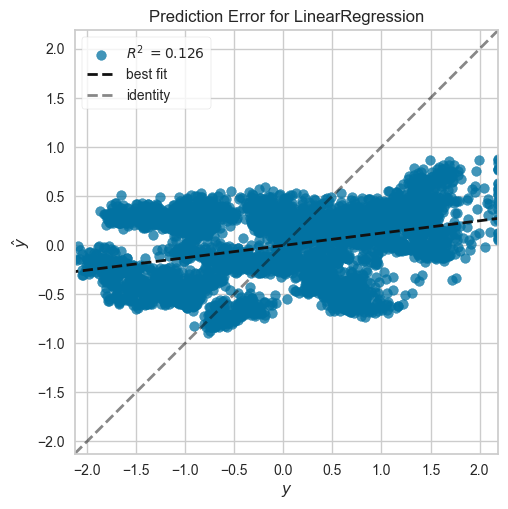

In [61]:
train_and_evaluate_model(LinearRegression())

Mean Absolute Percentage Error(MAPE): 1.87217359396011
Root Mean Squared Error(RMSE): 0.9430963176756088
R2 Score: 0.131130143830821


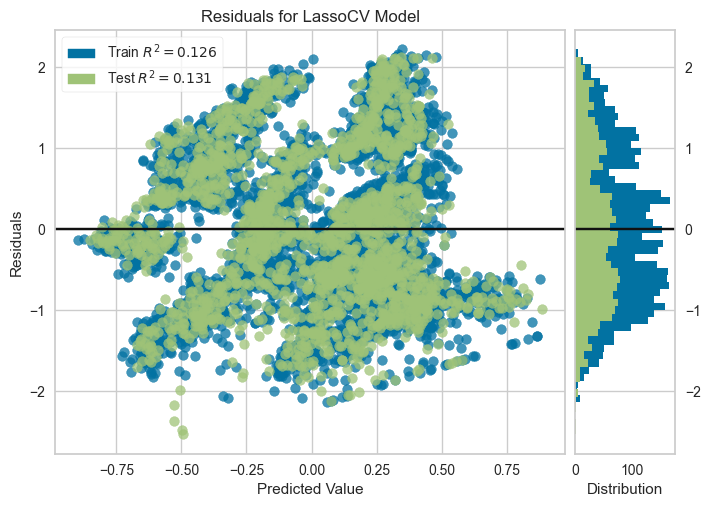

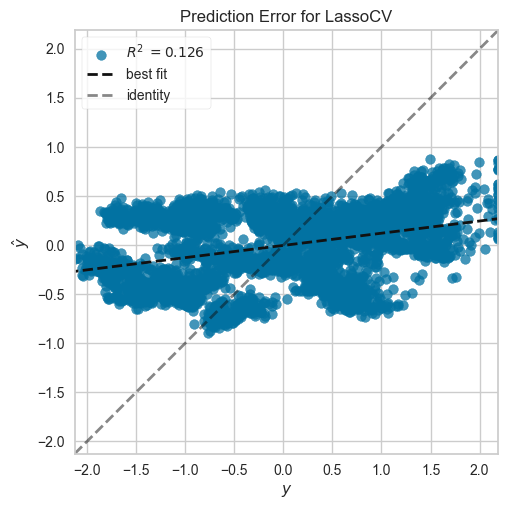

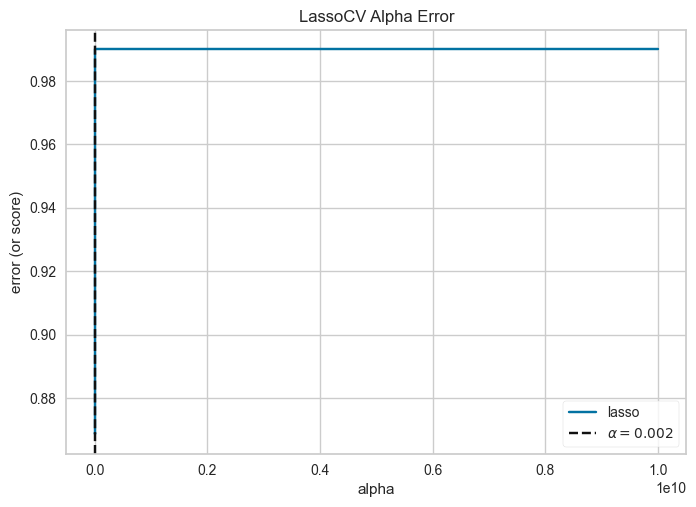

In [62]:
train_and_evaluate_model(LassoCV())

Mean Absolute Percentage Error(MAPE): 1.8583366137333945
Root Mean Squared Error(RMSE): 0.9429127460413069
R2 Score: 0.1314683581433027


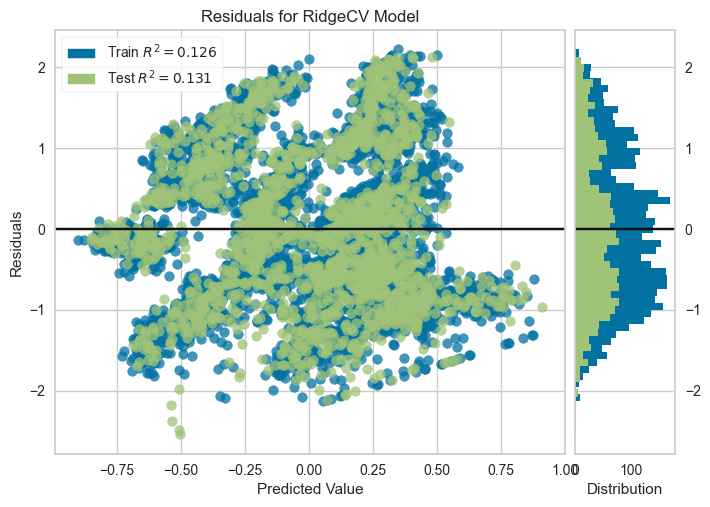

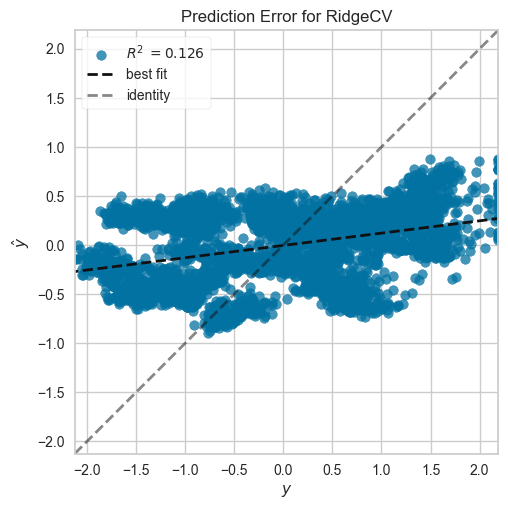

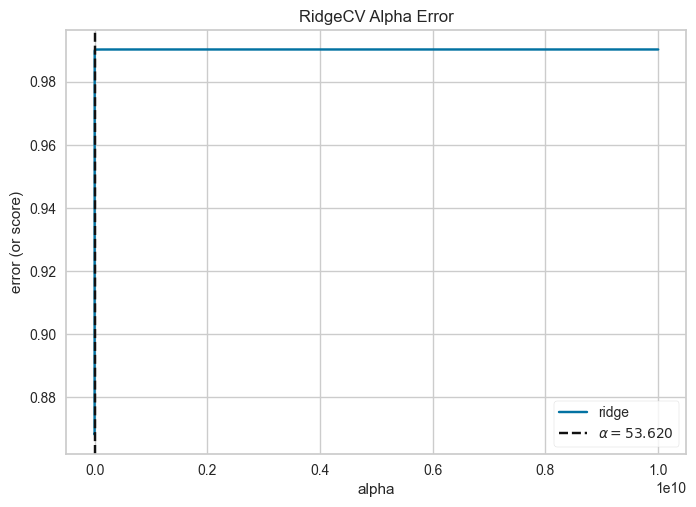

In [63]:
train_and_evaluate_model(RidgeCV())

Mean Absolute Percentage Error(MAPE): 1.8694173949342796
Root Mean Squared Error(RMSE): 0.9431117395338787
R2 Score: 0.13110172743880832


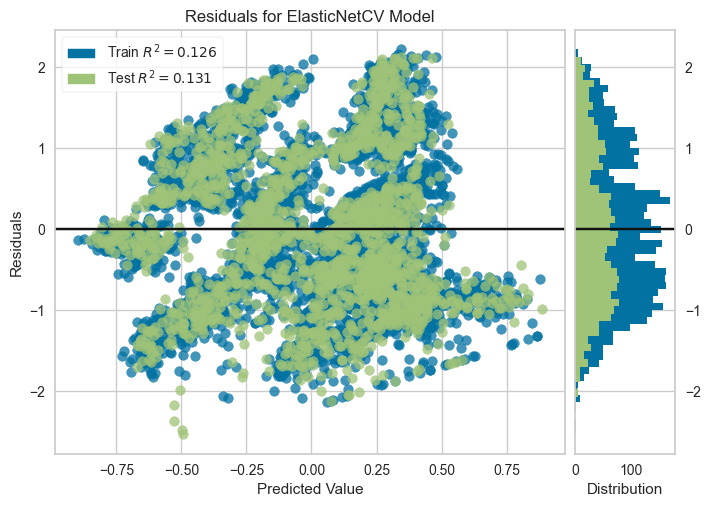

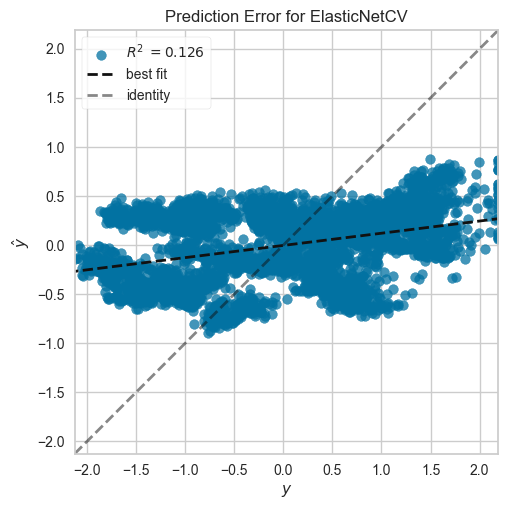

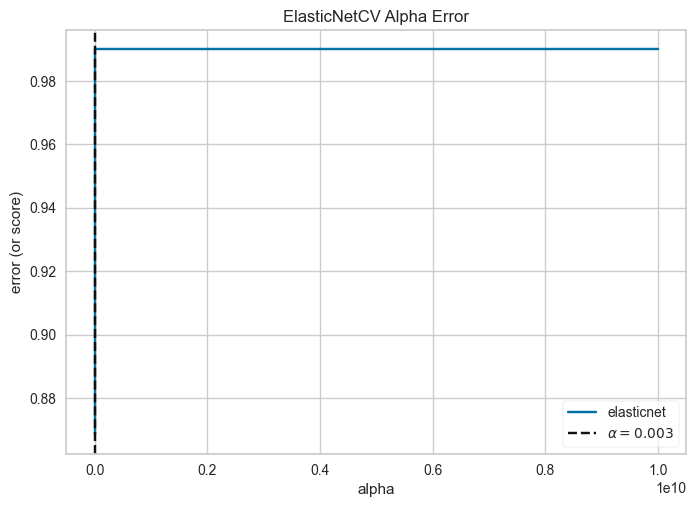

In [64]:
train_and_evaluate_model(ElasticNetCV())

Mean Absolute Percentage Error(MAPE): 1.8248079631075012
Root Mean Squared Error(RMSE): 0.9429675988096315
R2 Score: 0.13136730372257965


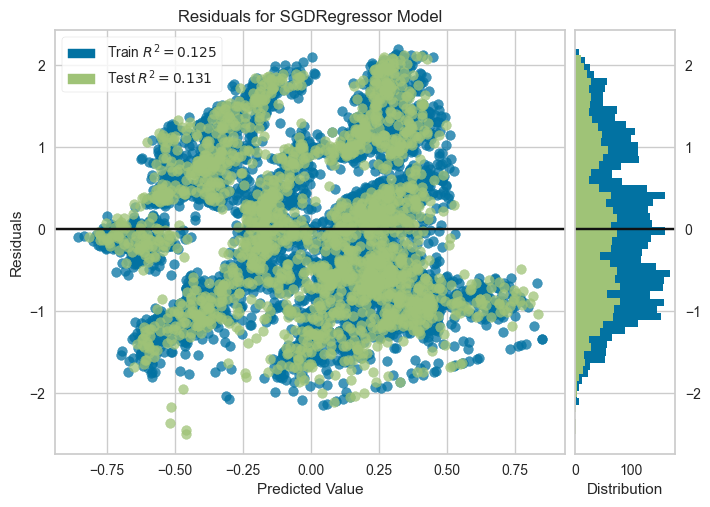

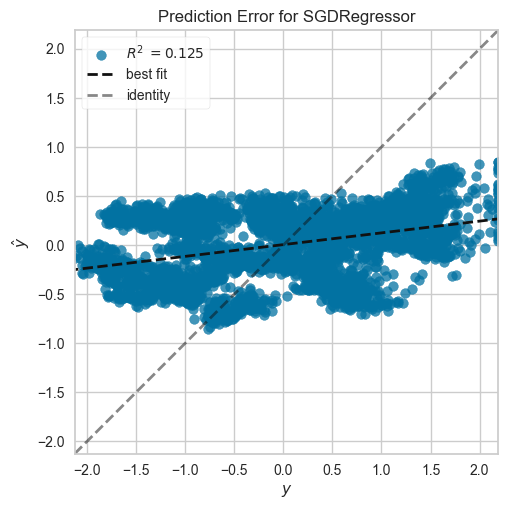

In [65]:
train_and_evaluate_model(SGDRegressor())

Mean Absolute Percentage Error(MAPE): 2.047510142946776
Root Mean Squared Error(RMSE): 0.9456807950172547
R2 Score: 0.12636148697284888


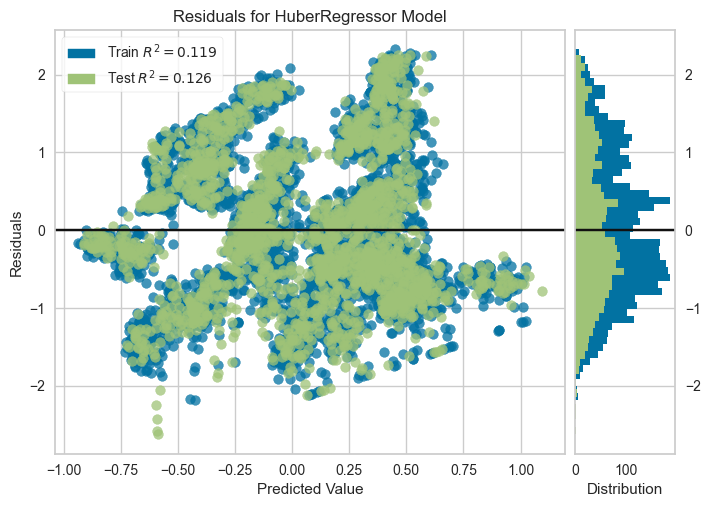

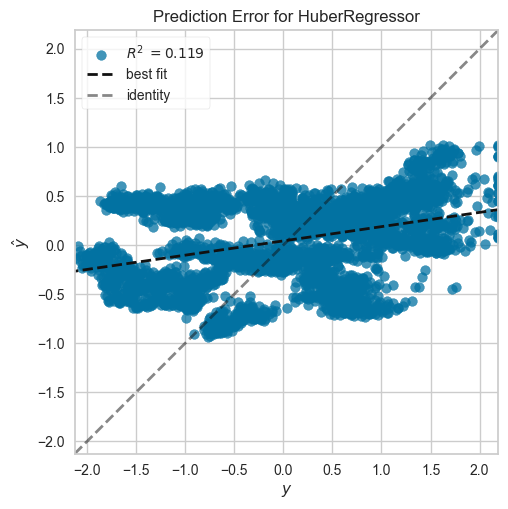

In [66]:
train_and_evaluate_model(HuberRegressor())

Mean Absolute Percentage Error(MAPE): 1.8962842173507548
Root Mean Squared Error(RMSE): 0.9431246081769947
R2 Score: 0.13107801525797047


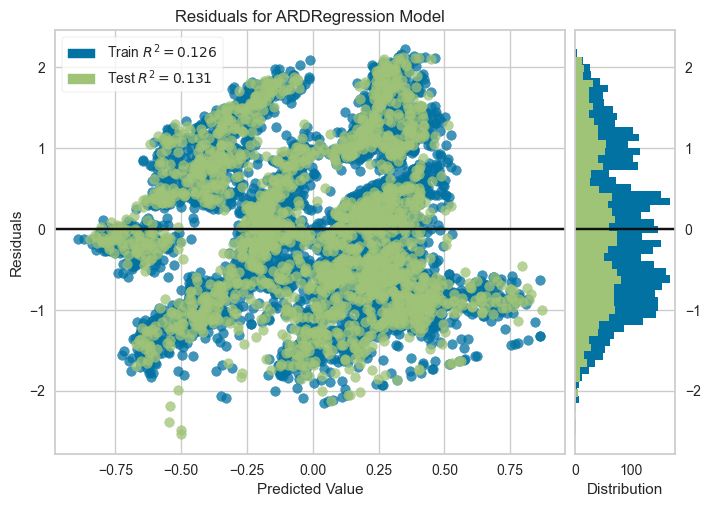

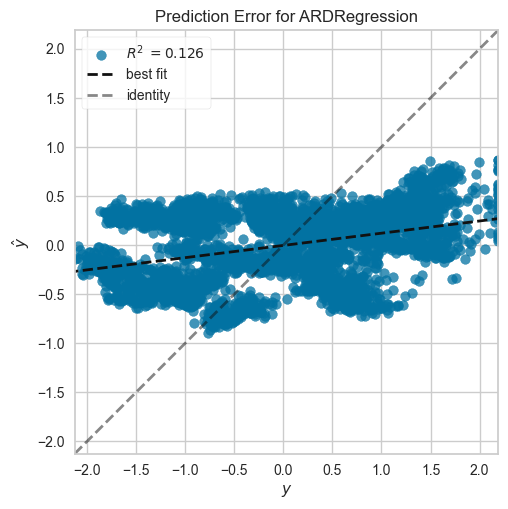

In [67]:
train_and_evaluate_model(ARDRegression())

Mean Absolute Percentage Error(MAPE): 4.191927385484206
Root Mean Squared Error(RMSE): 1.2575291396130108
R2 Score: -0.5448230714503632


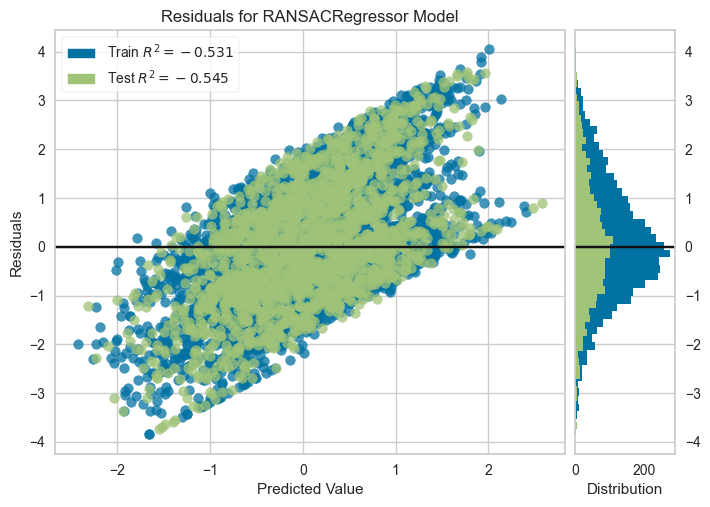

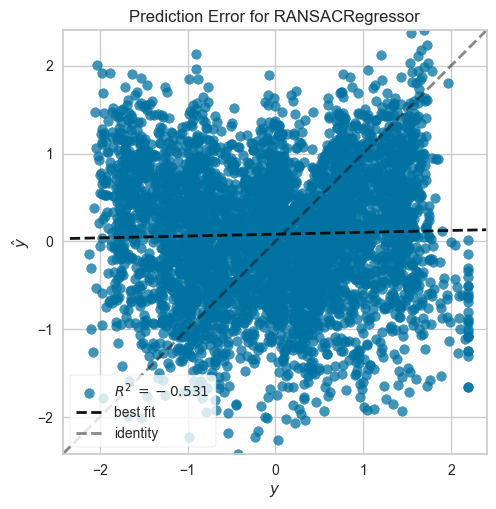

In [68]:
train_and_evaluate_model(RANSACRegressor())

Mean Absolute Percentage Error(MAPE): 1.30032699724825
Root Mean Squared Error(RMSE): 0.9645206708385978
R2 Score: 0.09120545570586358


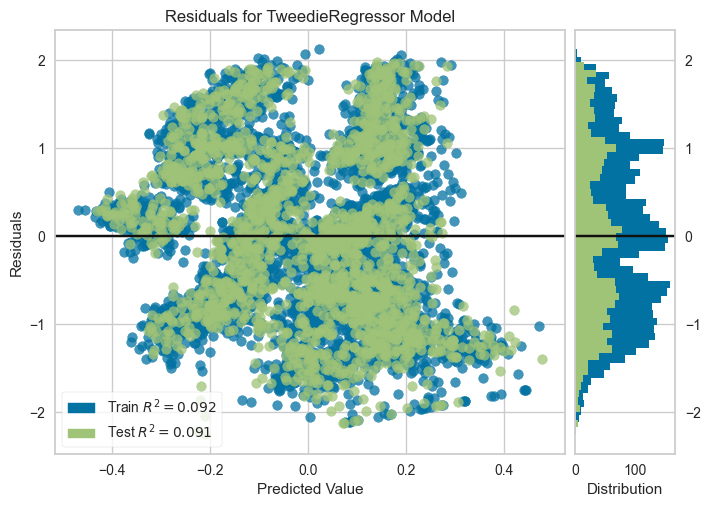

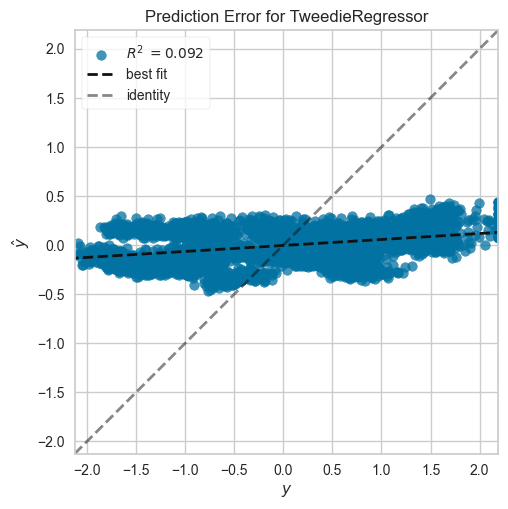

In [69]:
train_and_evaluate_model(TweedieRegressor())

Mean Absolute Percentage Error(MAPE): 5.203633425717179
Root Mean Squared Error(RMSE): 1.1235222151525137
R2 Score: -0.23312175640425492


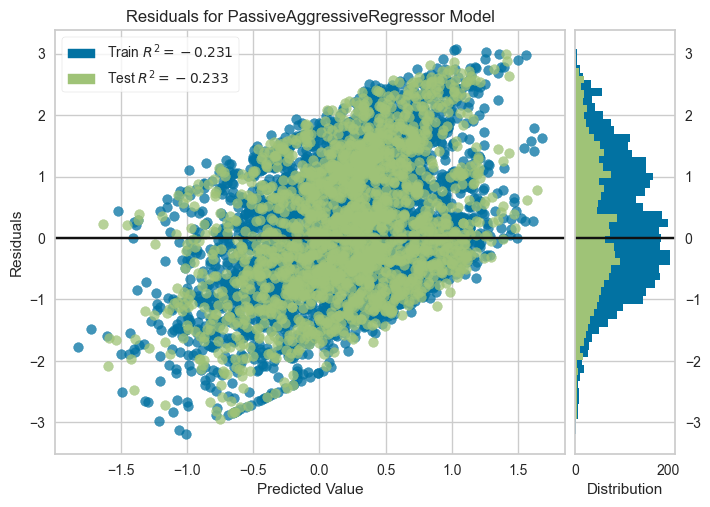

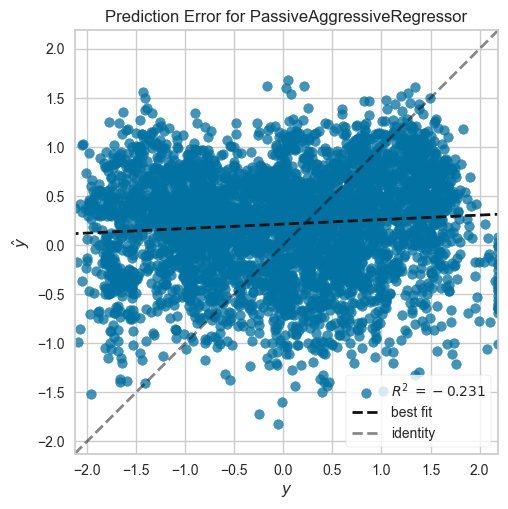

In [70]:
train_and_evaluate_model(PassiveAggressiveRegressor())

Mean Absolute Percentage Error(MAPE): 1.8324259921256374
Root Mean Squared Error(RMSE): 0.725657170052076
R2 Score: 0.485594487792688


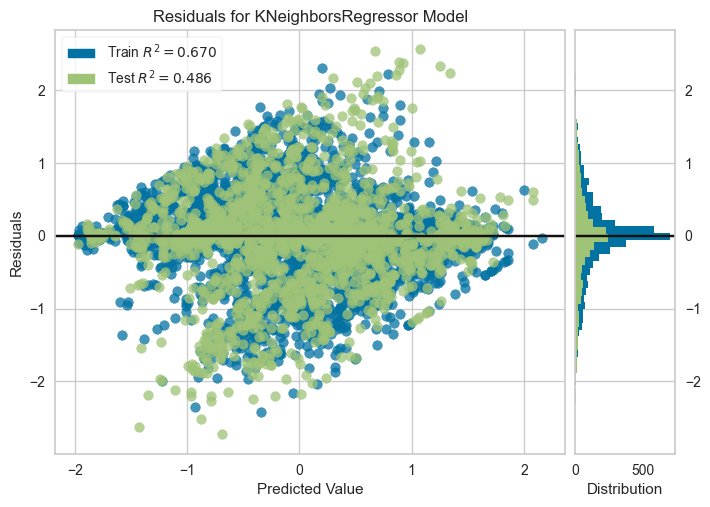

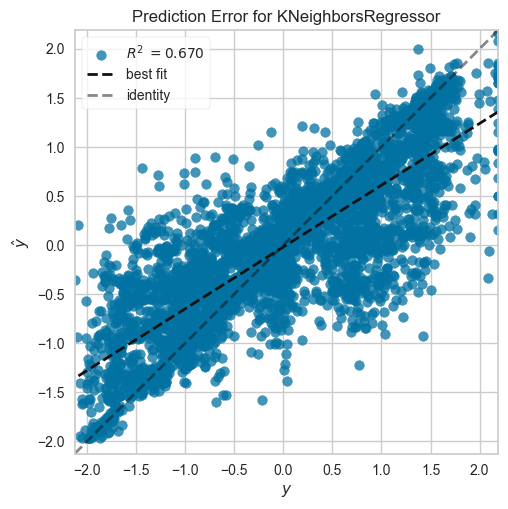

In [71]:
train_and_evaluate_model(KNeighborsRegressor())

Mean Absolute Percentage Error(MAPE): 1.7786440447853233
Root Mean Squared Error(RMSE): 0.8159376019038274
R2 Score: 0.3496359488709865


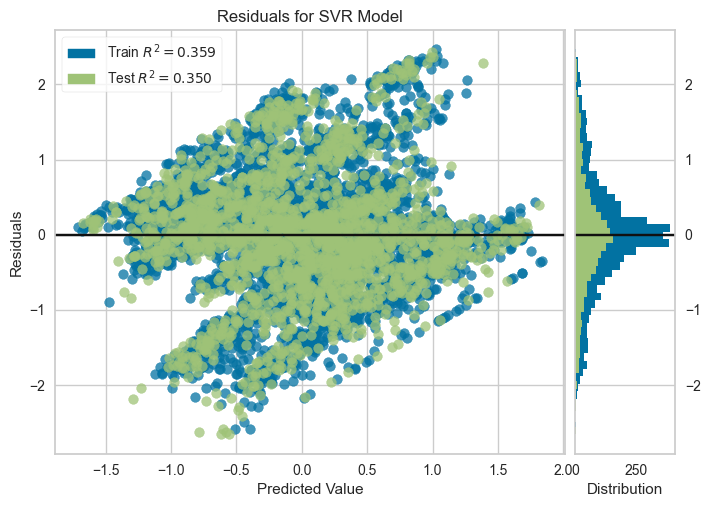

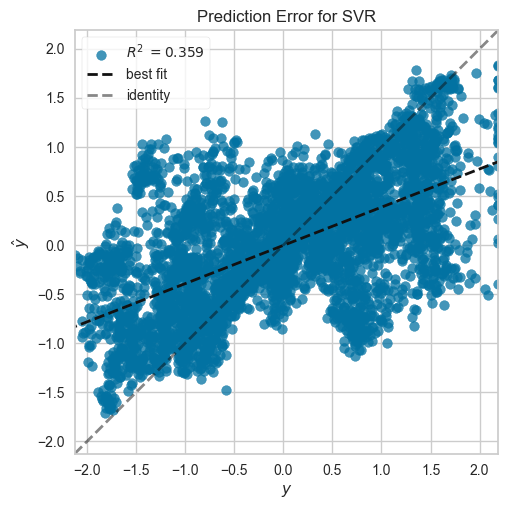

In [72]:
train_and_evaluate_model(SVR())

Mean Absolute Percentage Error(MAPE): 2.058692310166648
Root Mean Squared Error(RMSE): 0.9537043048035928
R2 Score: 0.11147404624017132


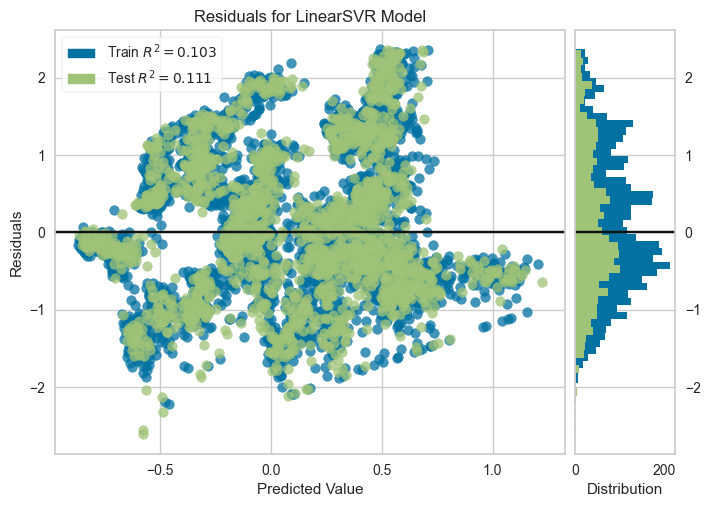

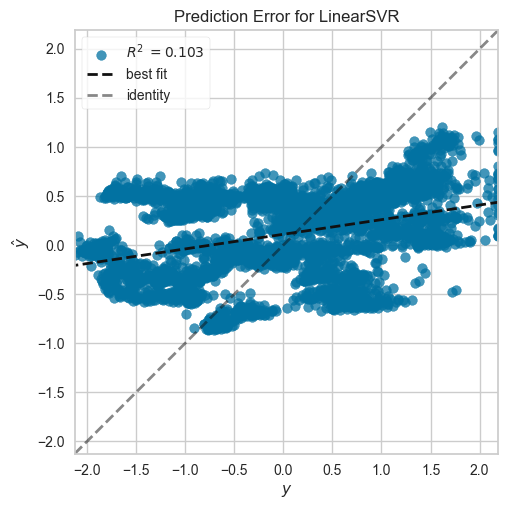

In [73]:
train_and_evaluate_model(LinearSVR())

Mean Absolute Percentage Error(MAPE): 0.6886173929889536
Root Mean Squared Error(RMSE): 0.22928363764923226
R2 Score: 0.9486442875189682


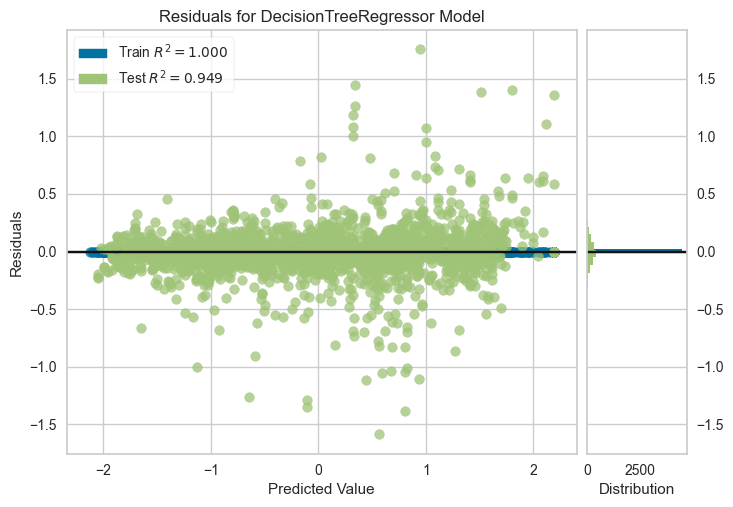

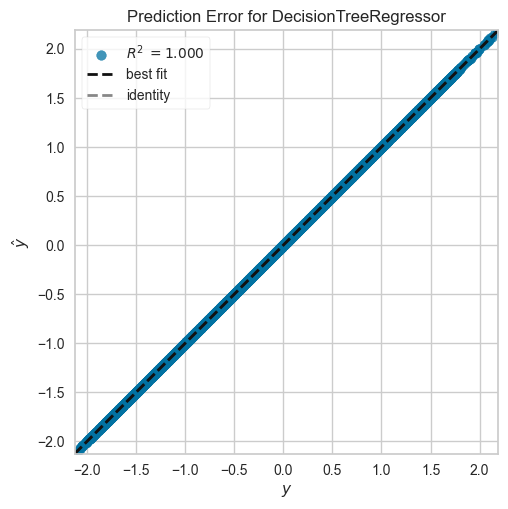

In [74]:
train_and_evaluate_model(DecisionTreeRegressor())

Mean Absolute Percentage Error(MAPE): 0.6316357845454231
Root Mean Squared Error(RMSE): 0.18088904075470633
R2 Score: 0.9680355568084091


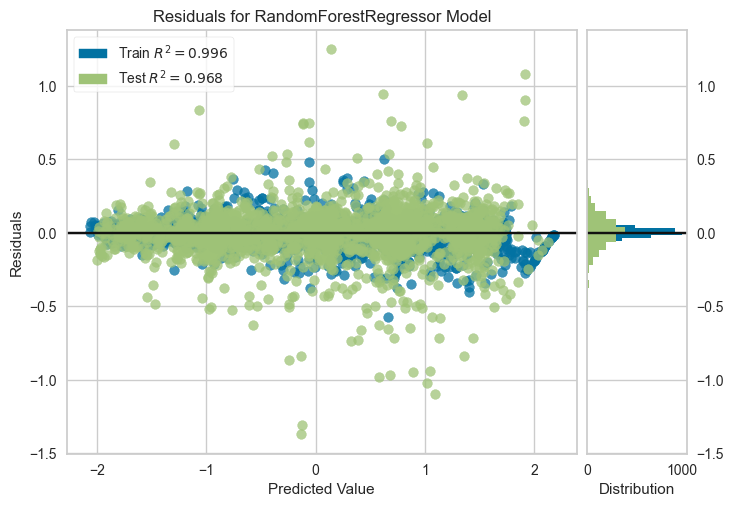

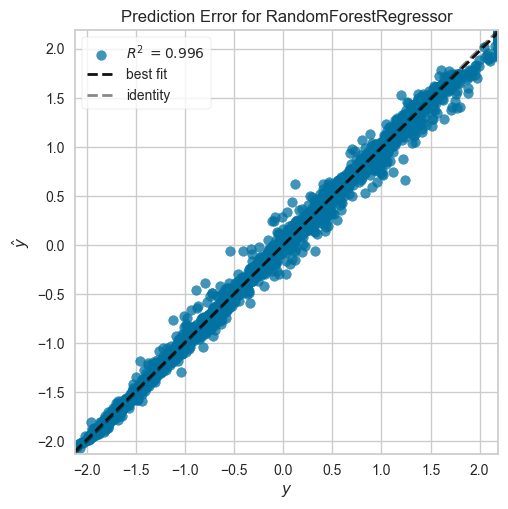

In [75]:
train_and_evaluate_model(RandomForestRegressor())

Mean Absolute Percentage Error(MAPE): 0.6288842943145447
Root Mean Squared Error(RMSE): 0.18181709881010605
R2 Score: 0.9677067258609293


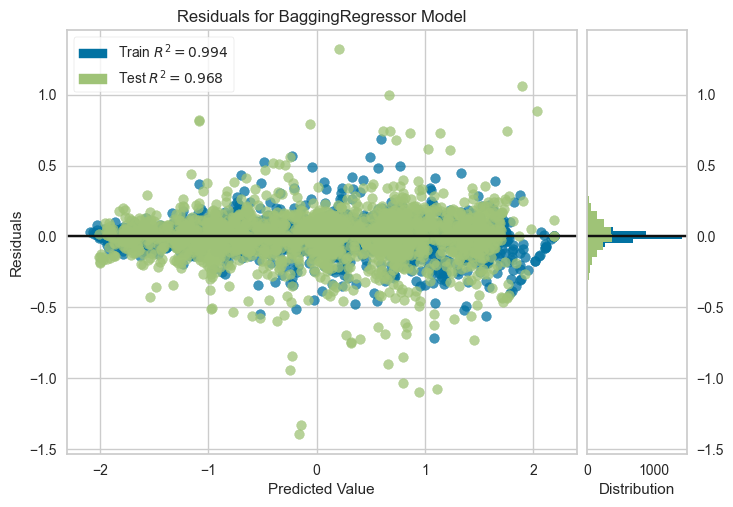

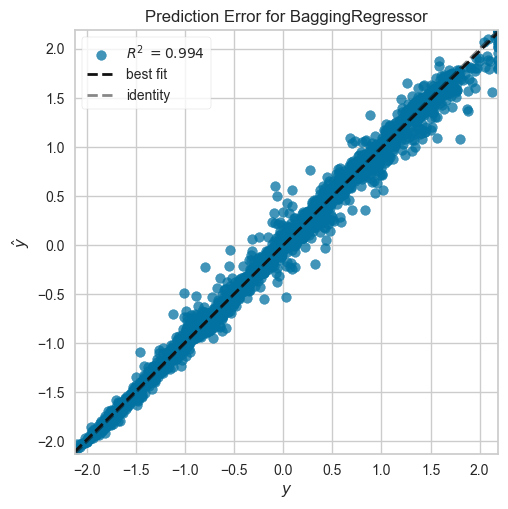

In [76]:
train_and_evaluate_model(BaggingRegressor())

Mean Absolute Percentage Error(MAPE): 0.5968460838198617
Root Mean Squared Error(RMSE): 0.17849433508980103
R2 Score: 0.9688762794770702


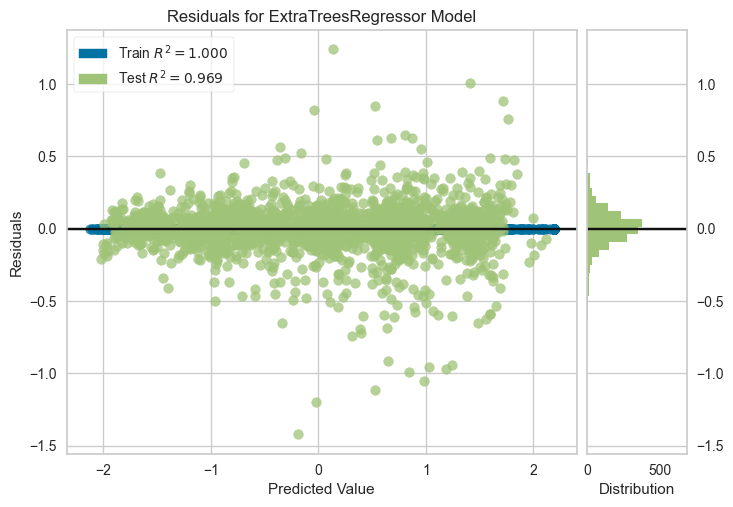

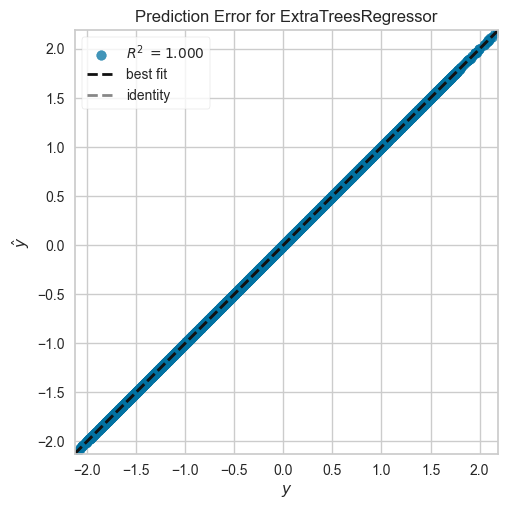

In [77]:
train_and_evaluate_model(ExtraTreesRegressor())

Mean Absolute Percentage Error(MAPE): 2.57532882324867
Root Mean Squared Error(RMSE): 0.7250431693889414
R2 Score: 0.4864646278959307


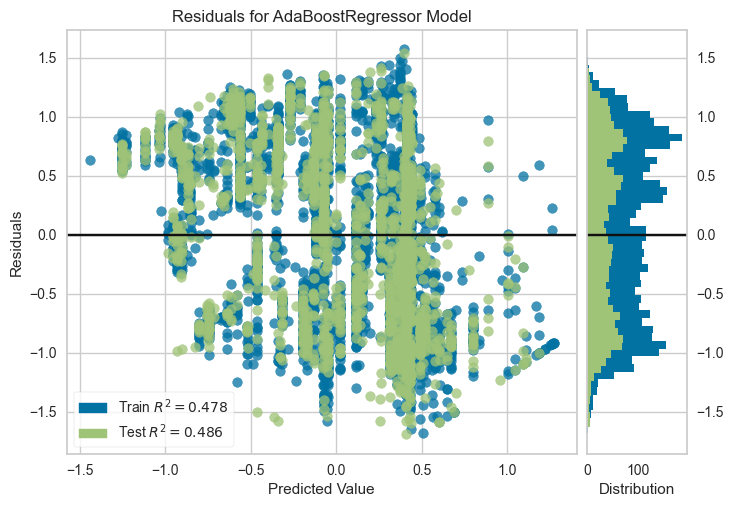

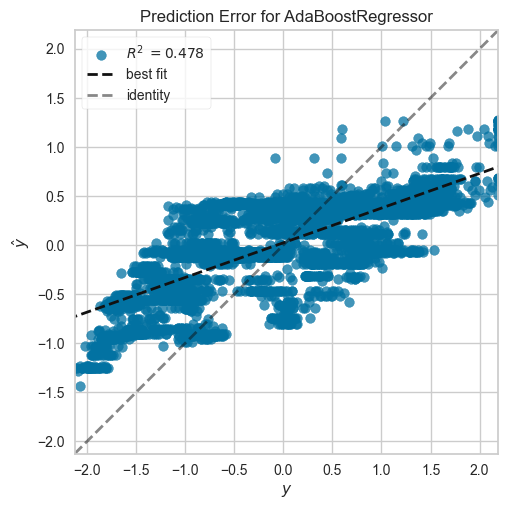

In [78]:
train_and_evaluate_model(AdaBoostRegressor())

Mean Absolute Percentage Error(MAPE): 0.51087336067734
Root Mean Squared Error(RMSE): 0.1294334736270051
R2 Score: 0.9836342525411399


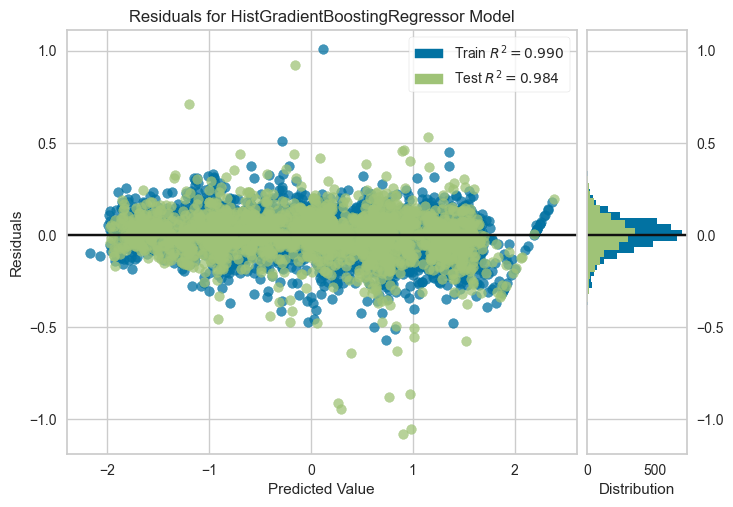

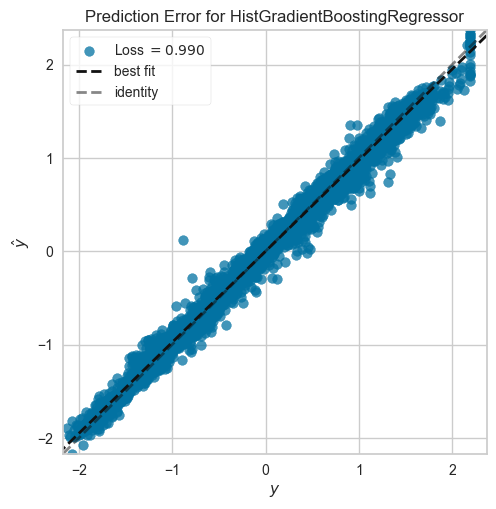

In [79]:
train_and_evaluate_model(HistGradientBoostingRegressor())

Mean Absolute Percentage Error(MAPE): 1.5252582037997267
Root Mean Squared Error(RMSE): 0.30209150905999316
R2 Score: 0.910850344465775


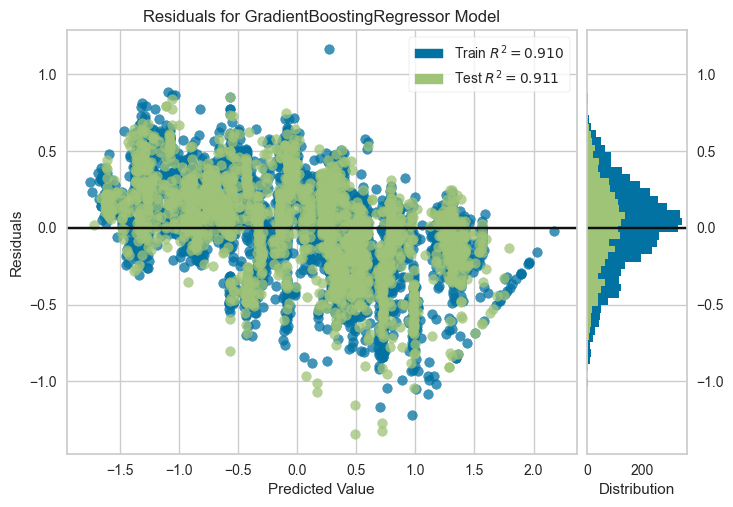

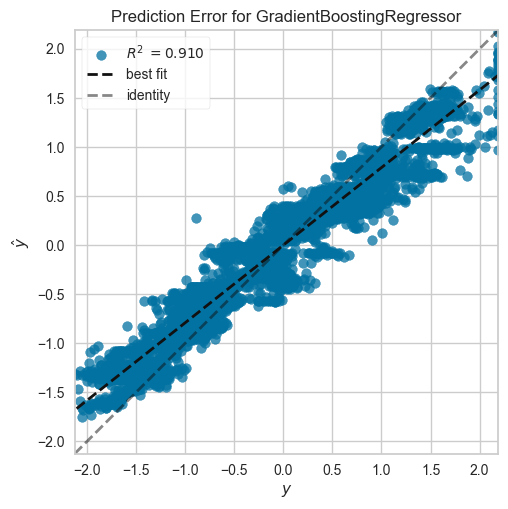

In [80]:
train_and_evaluate_model(GradientBoostingRegressor())

Mean Absolute Percentage Error(MAPE): 2.302538030869336
Root Mean Squared Error(RMSE): 0.6807573916414449
R2 Score: 0.5472824159249126


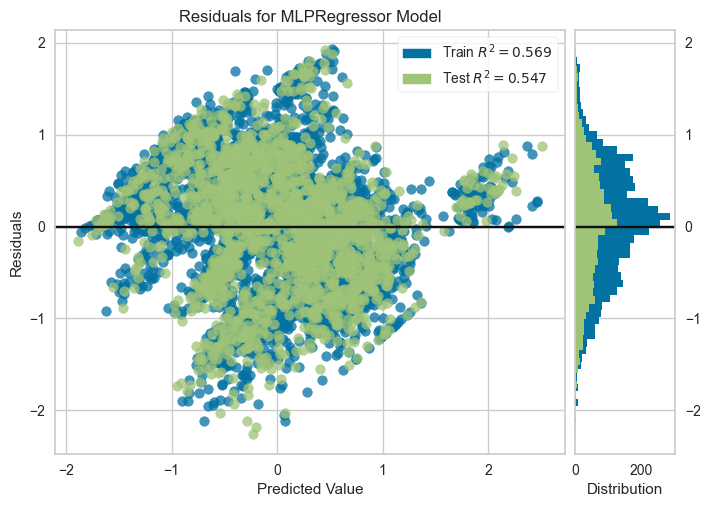

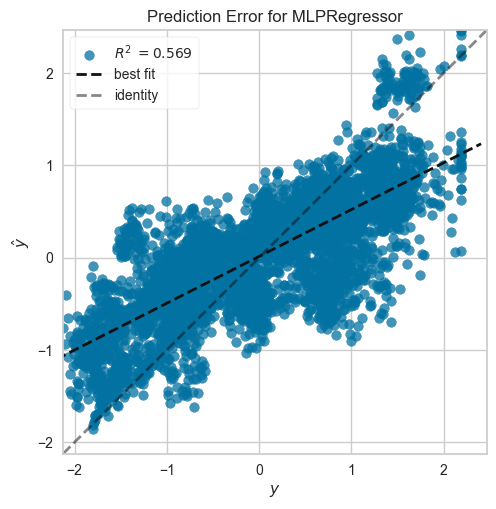

In [81]:
train_and_evaluate_model(MLPRegressor())

Mean Absolute Percentage Error(MAPE): 0.4484239317276413
Root Mean Squared Error(RMSE): 0.1279829255613287
R2 Score: 0.9839990156994279


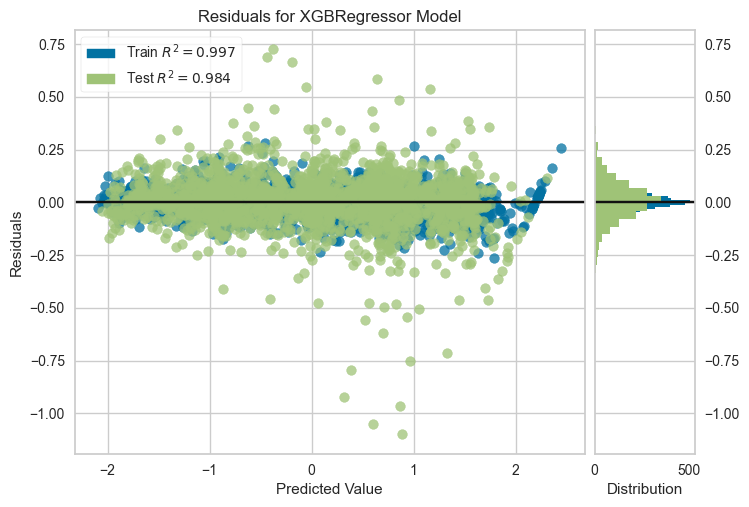

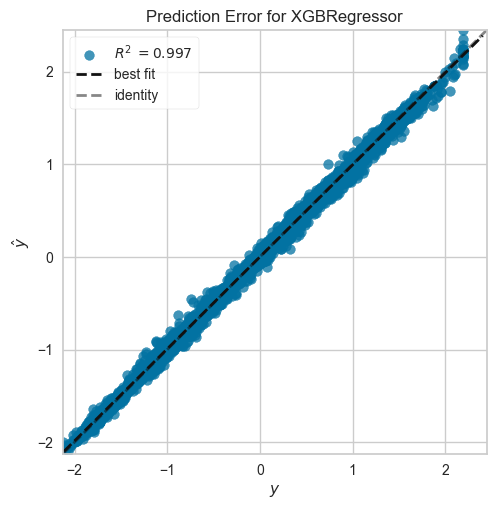

In [82]:
train_and_evaluate_model(XGBRegressor())

Mean Absolute Percentage Error(MAPE): 1.4958698963663275
Root Mean Squared Error(RMSE): 0.3956003717003603
R2 Score: 0.8471181201865408


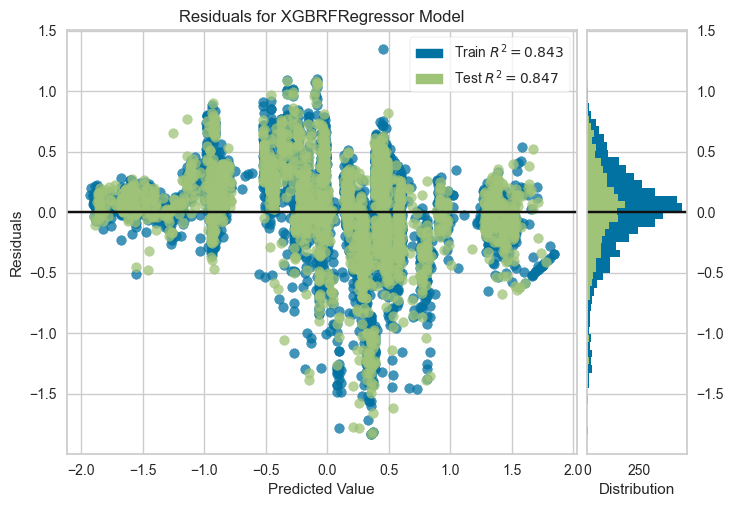

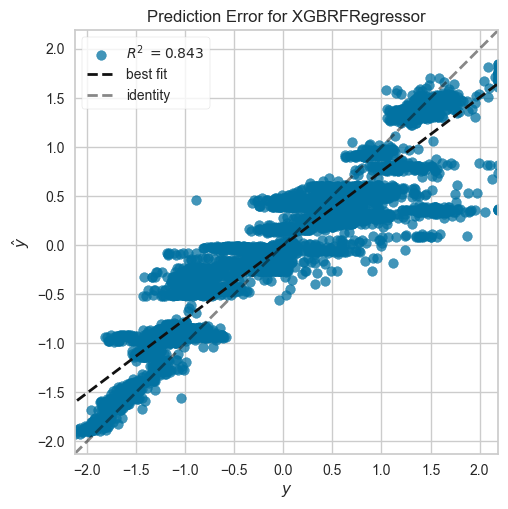

In [83]:
train_and_evaluate_model(XGBRFRegressor())

Mean Absolute Percentage Error(MAPE): 2.7676772849788933
Root Mean Squared Error(RMSE): 0.7953092639783247
R2 Score: 0.3821049519963209


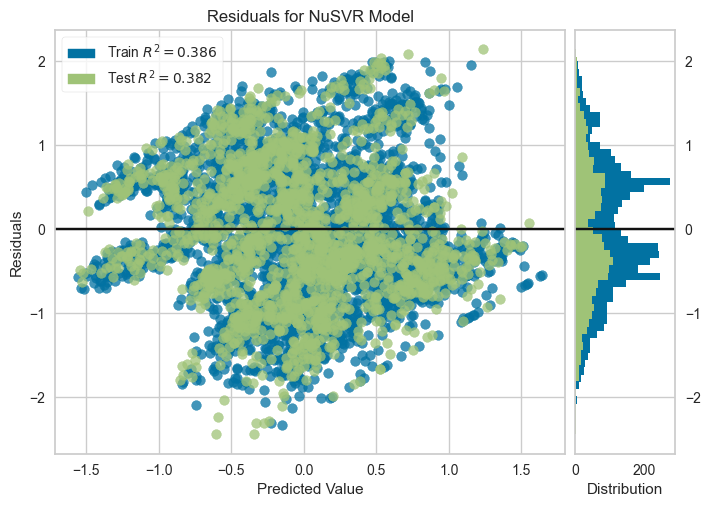

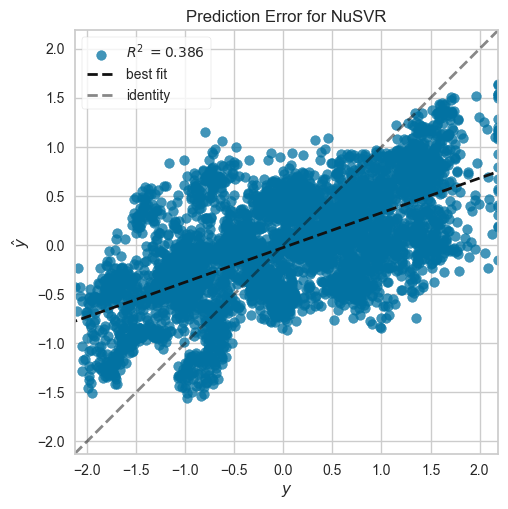

In [84]:
train_and_evaluate_model(NuSVR())

Mean Absolute Percentage Error(MAPE): 0.4836466164864434
Root Mean Squared Error(RMSE): 0.1289760326076023
R2 Score: 0.9837497270767015


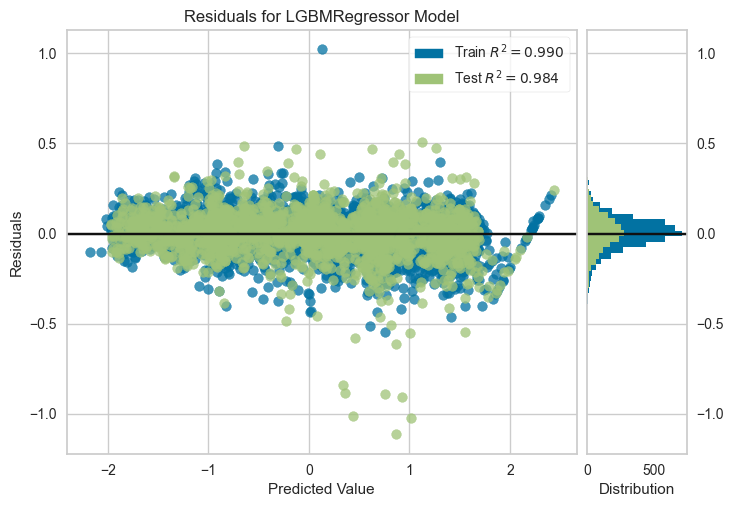

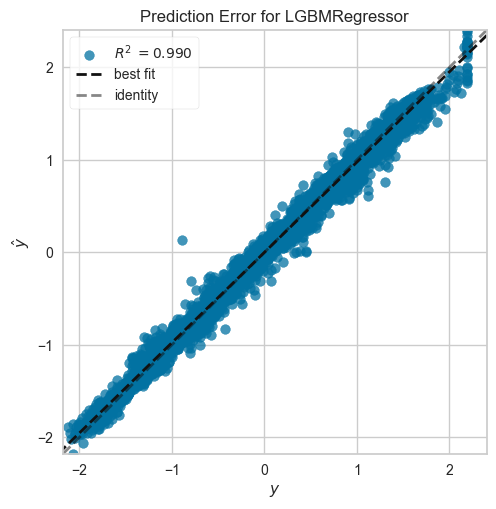

In [85]:
train_and_evaluate_model(LGBMRegressor())

In [86]:
train_and_evaluate_model(CatBoostRegressor(silent=True))

Mean Absolute Percentage Error(MAPE): 0.5341453587985909
Root Mean Squared Error(RMSE): 0.12290887063346671
R2 Score: 0.9852426258469904


Mean Absolute Percentage Error(MAPE): 0.4845606374418606
Root Mean Squared Error(RMSE): 0.12994806863698197
R2 Score: 0.9835038616447688


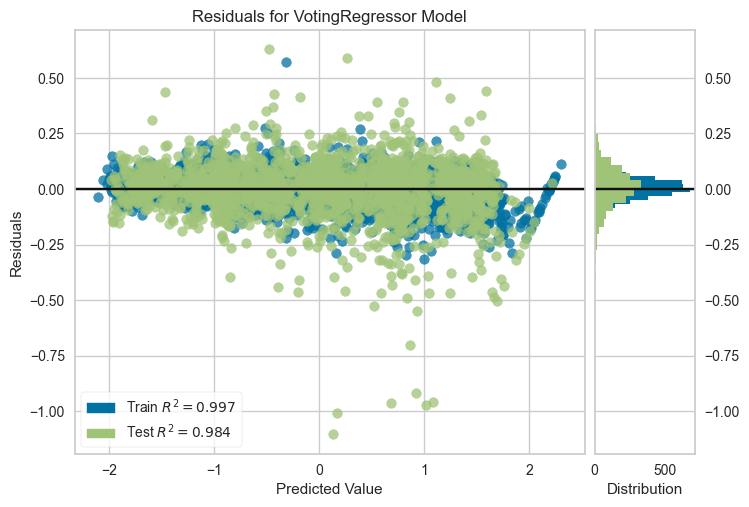

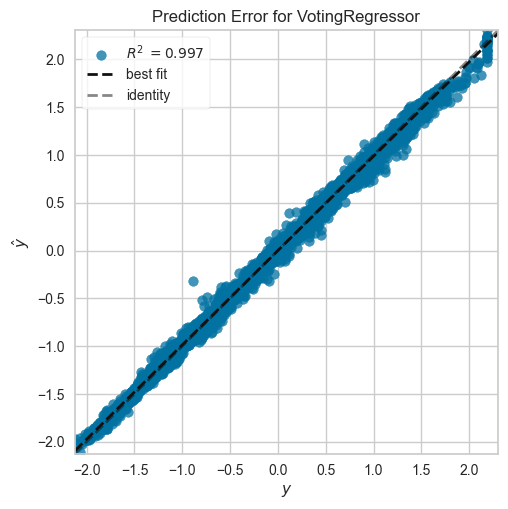

In [145]:
train_and_evaluate_model(VotingRegressor(estimators=[
    ('CAT',CatBoostRegressor(silent=True)),
    ('XGB',XGBRegressor()),
    ('LGBM',LGBMRegressor()),
    ('HGB',HistGradientBoostingRegressor()),
    ('RF',RandomForestRegressor()),
    ('BAG',BaggingRegressor()),
    ('ET',ExtraTreesRegressor())
]))

## Baseline Models Performance Comparison

In [88]:
model_perfs = pd.DataFrame({'Model': models, 'MAPE': mape_scores, 'RMSE': rmse_scores, 'R2': r2_scores})
model_perfs = model_perfs.sort_values('R2',ascending=False)
model_perfs

,Model,MAPE,RMSE,R2
25,<catboost.core.CatBoostRegressor object at 0x0...,0.534145,0.122909,0.985243
21,"XGBRegressor(base_score=None, booster=None, ca...",0.448424,0.127983,0.983999
24,LGBMRegressor(),0.483647,0.128976,0.983750
18,HistGradientBoostingRegressor(),0.510873,0.129433,0.983634
26,"VotingRegressor(estimators=[('CAT',\n ...",0.483340,0.131280,0.983164
16,"(ExtraTreeRegressor(random_state=1040630546), ...",0.596846,0.178494,0.968876
14,"(DecisionTreeRegressor(max_features=1.0, rando...",0.631636,0.180889,0.968036
15,(DecisionTreeRegressor(random_state=1012004194...,0.628884,0.181817,0.967707
13,DecisionTreeRegressor(),0.688617,0.229284,0.948644
19,([DecisionTreeRegressor(criterion='friedman_ms...,1.525258,0.302092,0.910850


Among the baseline models, Cat Boost Regressor produced the best performance by obtaining an astonishing r2 score of more than 98.5%. 

## Hyperparameter Optimization and Cross Validation

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=True, criterion=friedman_mse, max_features=log2, n_estimators=600, oob_score=True; total time=   5.2s
[CV] END bootstrap=True, criterion=friedman_mse, max_features=log2, n_estimators=600, oob_score=True; total time=   5.1s
[CV] END bootstrap=True, criterion=friedman_mse, max_features=log2, n_estimators=600, oob_score=True; total time=   5.2s
[CV] END bootstrap=True, criterion=friedman_mse, max_features=log2, n_estimators=600, oob_score=True; total time=   5.2s
[CV] END bootstrap=True, criterion=friedman_mse, max_features=log2, n_estimators=600, oob_score=True; total time=   6.0s
[CV] END bootstrap=True, criterion=absolute_error, max_features=log2, n_estimators=200, oob_score=False; total time=  12.6s
[CV] END bootstrap=True, criterion=absolute_error, max_features=log2, n_estimators=200, oob_score=False; total time=  12.8s
[CV] END bootstrap=True, criterion=absolute_error, max_features=log2, n_estimators=200

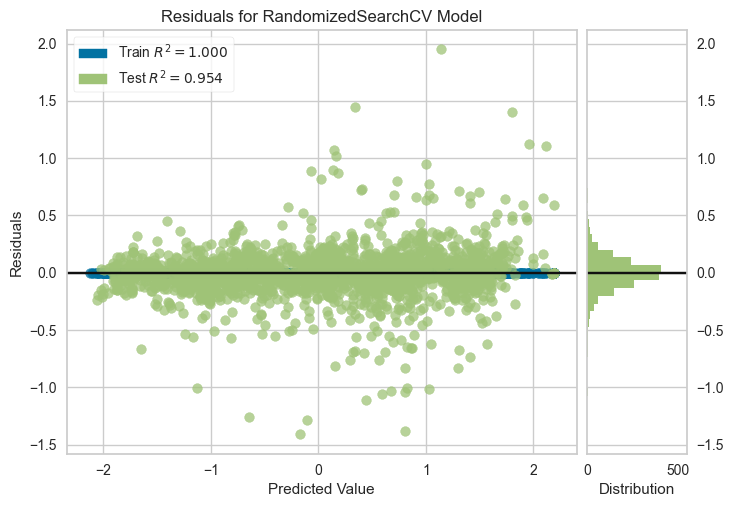

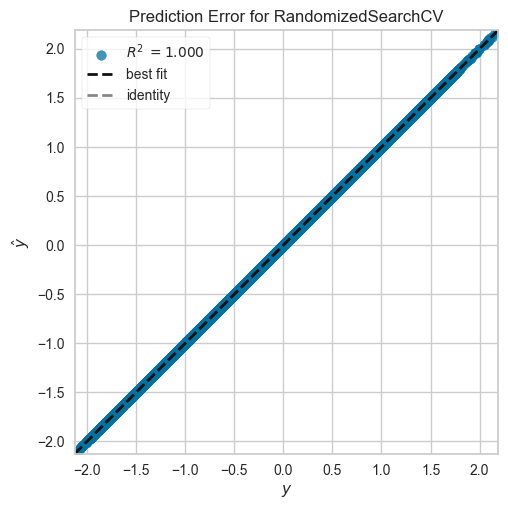

In [89]:
param_grid = {'n_estimators': [200,400,600,800,1000], 
              'criterion': ['squared_error', 'absolute_error', 'friedman_mse', 'poisson'],
              'max_features': ['auto','sqrt','log2'],
              'bootstrap': [True,False],
              'oob_score': [True,False]}

grid_rf = RandomizedSearchCV(RandomForestRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_rf)

In [90]:
grid_rf.best_params_

{'oob_score': False,
 'n_estimators': 400,
 'max_features': 'auto',
 'criterion': 'squared_error',
 'bootstrap': False}

Fitting 15 folds for each of 10 candidates, totalling 150 fits
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean, n_neighbors=2, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=euclidean

[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s
[CV] END algorithm=ball_tree, metric=manhattan, n_neighbors=12, weights=uniform; total time=   0.0s


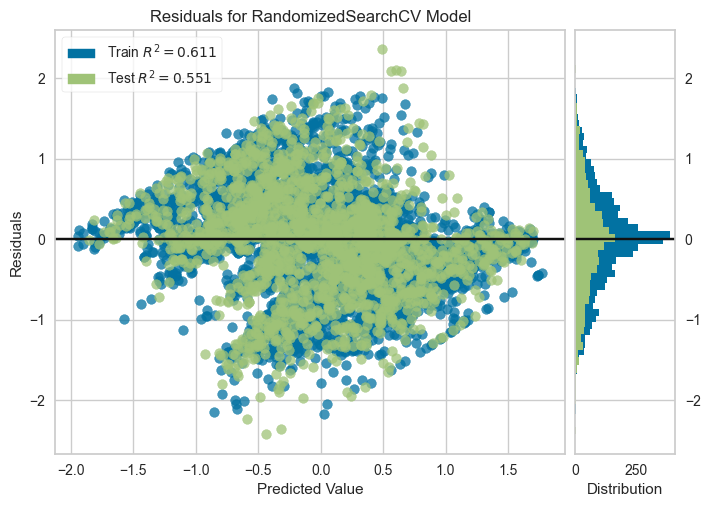

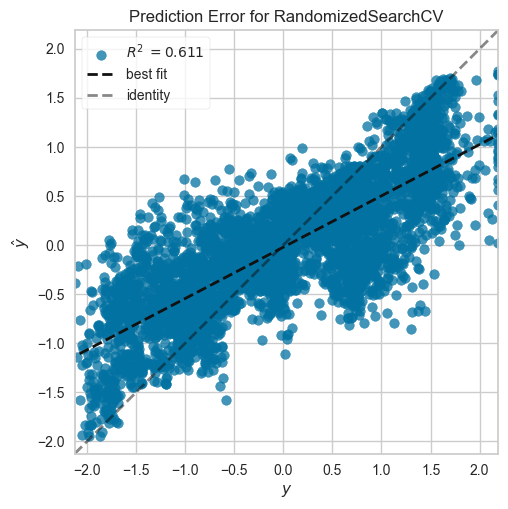

In [91]:
param_grid = {'n_neighbors': [2,5,8,12,20],
              'weights': ['uniform','distance'],
              'algorithm': ['ball_tree', 'kd_tree', 'brute'],
              'metric': ['minkowski','manhattan','euclidean','chebyshev']
             }

grid_knn = RandomizedSearchCV(KNeighborsRegressor(),param_grid,cv=RepeatedKFold(n_splits=5,n_repeats=3),verbose=2)
train_and_evaluate_model(grid_knn)

In [92]:
grid_knn.best_params_

{'weights': 'uniform',
 'n_neighbors': 12,
 'metric': 'manhattan',
 'algorithm': 'ball_tree'}

Fitting 15 folds for each of 10 candidates, totalling 150 fits
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_rate=0.8, loss=poisson, max_bins=0; total time=   0.0s
[CV] END interaction_cst=pairwise, learning_ra

[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; total time=   0.0s
[CV] END interaction_cst=no_interaction, learning_rate=1.0, loss=absolute_error, max_bins=50; to

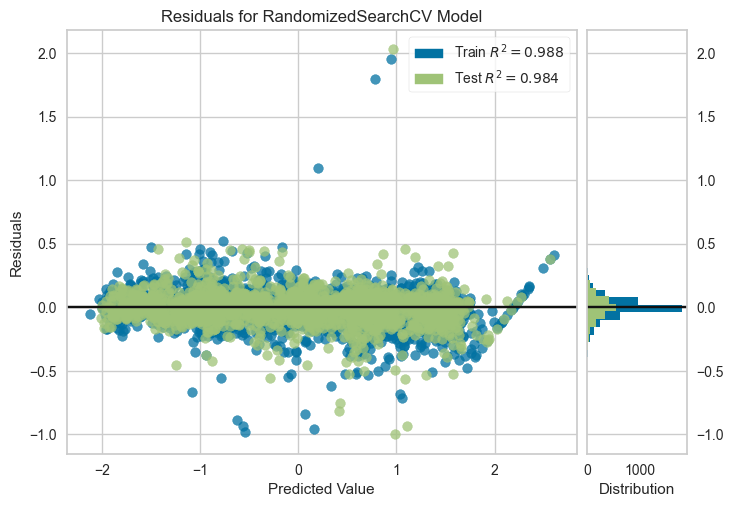

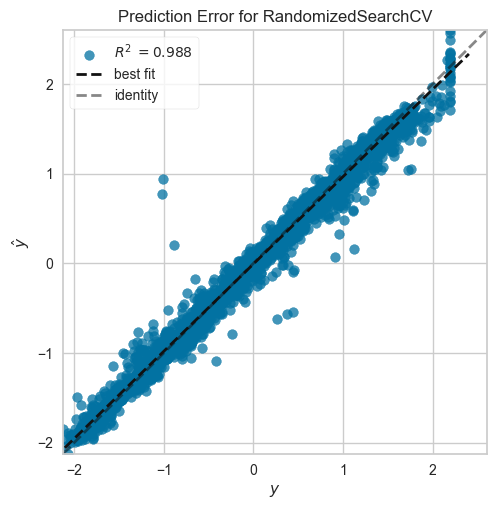

In [93]:
param_grid = {'learning_rate': [0.2,0.4,0.5,0.8,1.0],
              'loss': ['squared_error','absolute_error','poisson','quantile'],
              'max_bins': np.arange(0,255,50),
              'interaction_cst': ['pairwise','no_interaction']}
grid_hgb = RandomizedSearchCV(HistGradientBoostingRegressor(),param_grid,cv=RepeatedKFold(n_splits=5,n_repeats=3),verbose=2)
train_and_evaluate_model(grid_hgb)

In [94]:
grid_hgb.best_params_

{'max_bins': 200,
 'loss': 'absolute_error',
 'learning_rate': 0.2,
 'interaction_cst': 'pairwise'}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=0.1, degree=5, epsilon=1.0, gamma=scale, kernel=linear, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=5, epsilon=1.0, gamma=scale, kernel=linear, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=5, epsilon=1.0, gamma=scale, kernel=linear, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=5, epsilon=1.0, gamma=scale, kernel=linear, shrinking=True; total time=   0.1s
[CV] END C=0.1, degree=5, epsilon=1.0, gamma=scale, kernel=linear, shrinking=True; total time=   0.1s
[CV] END C=1, degree=3, epsilon=0.25075, gamma=scale, kernel=rbf, shrinking=True; total time=   0.5s
[CV] END C=1, degree=3, epsilon=0.25075, gamma=scale, kernel=rbf, shrinking=True; total time=   0.5s
[CV] END C=1, degree=3, epsilon=0.25075, gamma=scale, kernel=rbf, shrinking=True; total time=   0.5s
[CV] END C=1, degree=3, epsilon=0.25075, gamma=scale, kernel=rbf, shrinking=True; total time=   0.6s
[CV] END C=1, degree=3, e

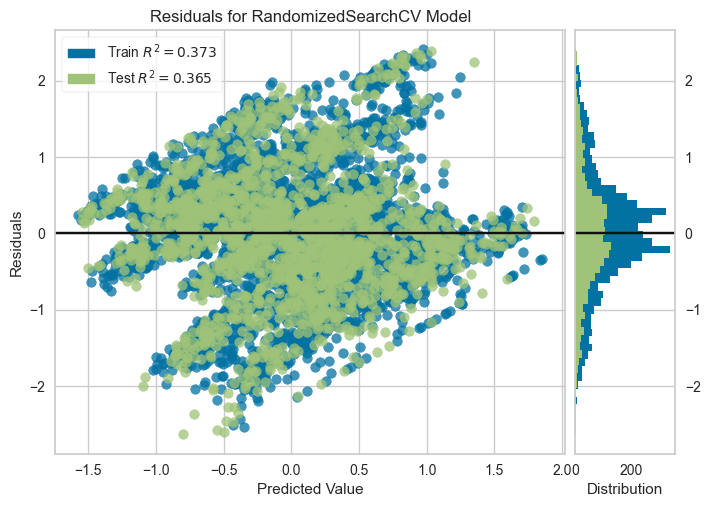

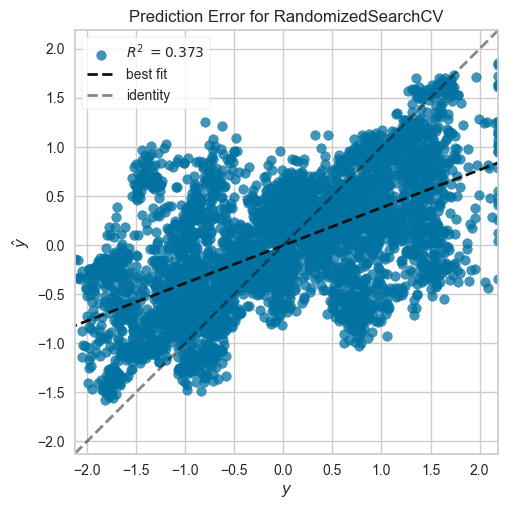

In [95]:
param_grid = {'C': [0.001,0.01,0.1,1,5],
             'gamma': ['scale','auto'],
             'epsilon': np.linspace(0.001,1,5),
             'kernel': ['linear','poly','rbf','sigmoid'],
             'degree': [2,3,4,5],
             'shrinking': [True,False]
             }
grid_svr = RandomizedSearchCV(SVR(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_svr)

In [96]:
grid_svr.best_params_

{'shrinking': True,
 'kernel': 'rbf',
 'gamma': 'scale',
 'epsilon': 0.25075,
 'degree': 3,
 'C': 1}

Fitting 12 folds for each of 10 candidates, totalling 120 fits
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsilon_insensitive; total time=   0.0s
[CV] END C=0.0001, epsilon=0.25075, loss=epsil

[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
[CV] END .........C=1, epsilon=1.0, loss=epsilon_insensitive; total time=   0.0s
Mean Absolute Percentage Err

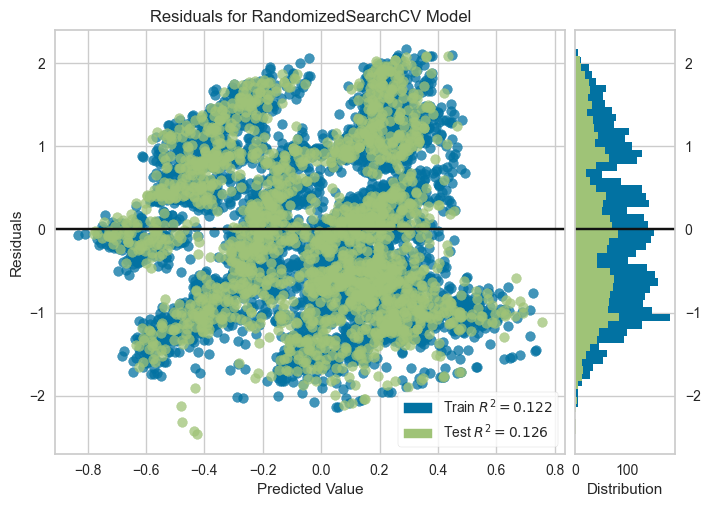

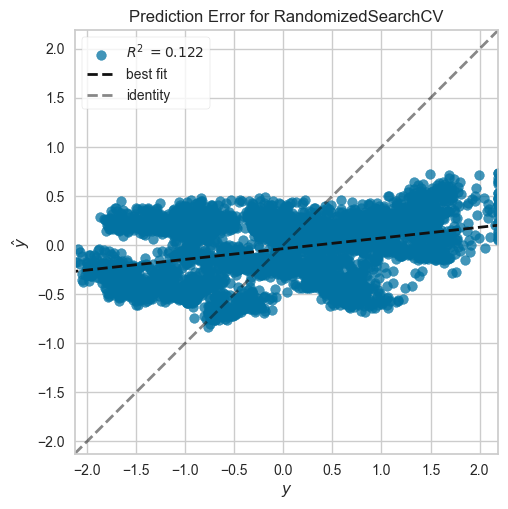

In [97]:
param_grid = {'loss': ['epsilon_insensitive','squared_epsilon_insensitive'],
             'C': [0.0001,0.001,0.01,0.1,1],
             'epsilon': np.linspace(0.001,1,5)}

grid_lsvr = RandomizedSearchCV(LinearSVR(),param_grid,cv=RepeatedKFold(n_splits=6,n_repeats=2),verbose=2)
train_and_evaluate_model(grid_lsvr)

In [98]:
grid_lsvr.best_params_

{'loss': 'squared_epsilon_insensitive', 'epsilon': 0.5005, 'C': 0.1}

Fitting 18 folds for each of 10 candidates, totalling 180 fits
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2, splitter=best; total time=   0.0s
[CV] END criterion=poisson, max_features=log2,

[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=squared_error, max_features=sqrt, splitter=random; total time=   0.0s
[CV] END criterion=sq

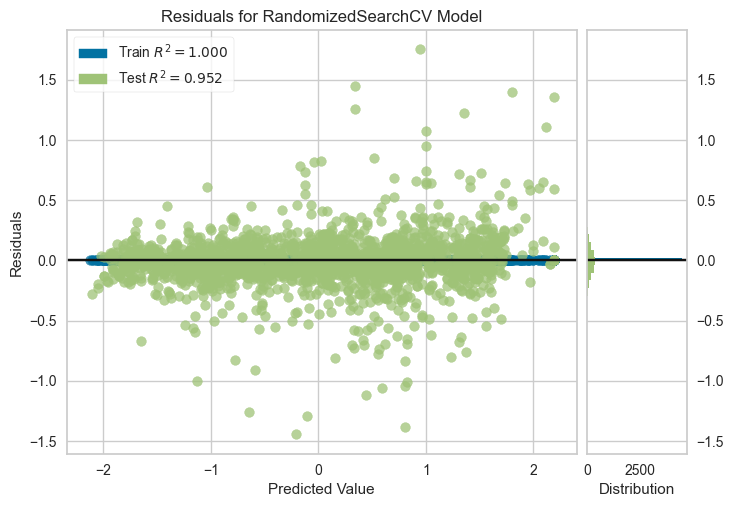

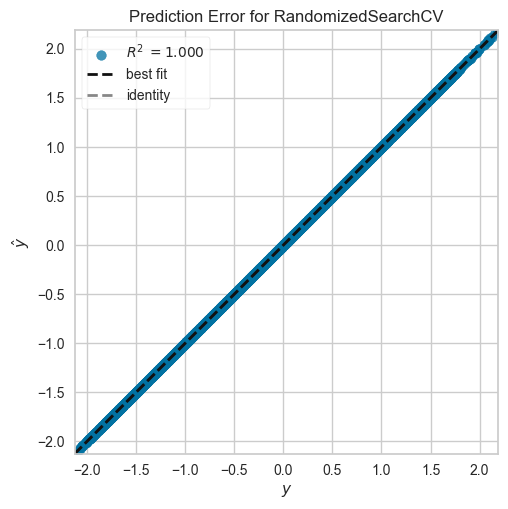

In [99]:
param_grid = {'criterion': ['squared_error','friedman_mse','absolute_error','poisson'],
              'splitter': ['best','random'],
              'max_features': ['auto','sqrt','log2']
             }

grid_dt = RandomizedSearchCV(DecisionTreeRegressor(),param_grid,verbose=2,cv=RepeatedKFold(n_splits=6,n_repeats=3))
train_and_evaluate_model(grid_dt)

In [100]:
grid_dt.best_params_

{'splitter': 'best', 'max_features': 'auto', 'criterion': 'friedman_mse'}

Fitting 6 folds for each of 10 candidates, totalling 60 fits
[CV 1/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.969 total time=   3.5s
[CV 2/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.976 total time=   3.4s
[CV 3/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.960 total time=   3.6s
[CV 4/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.962 total time=   3.6s
[CV 5/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.967 total time=   3.5s
[CV 6/6] END criterion=friedman_mse, learning_rate=0.4, loss=absolute_error, max_features=log2, n_estimators=1000;, score=0.960 total time=   3.6s
[CV 1/6] END criterion=squared_error, learning_rate=0.2, 

[CV 5/6] END criterion=squared_error, learning_rate=1, loss=huber, max_features=log2, n_estimators=100;, score=0.922 total time=   0.4s
[CV 6/6] END criterion=squared_error, learning_rate=1, loss=huber, max_features=log2, n_estimators=100;, score=0.951 total time=   0.4s
Mean Absolute Percentage Error(MAPE): 0.5385070919758704
Root Mean Squared Error(RMSE): 0.16830518927732563
R2 Score: 0.9723281850145602


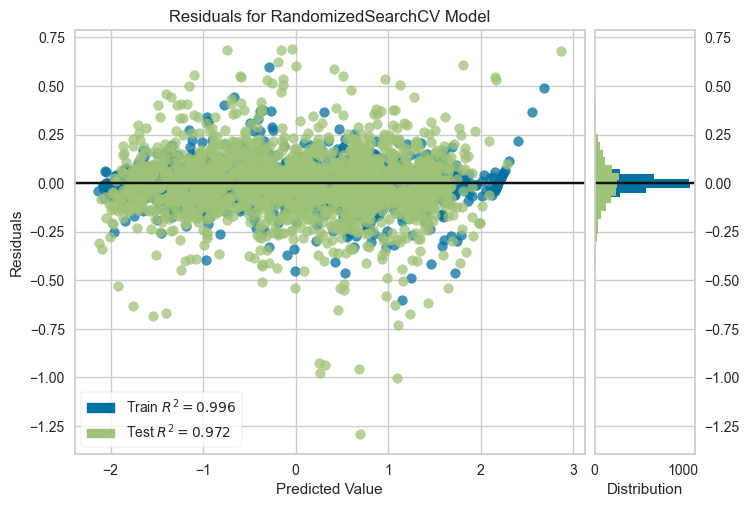

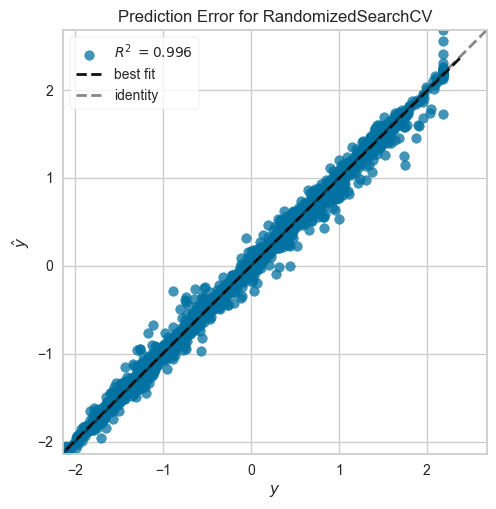

In [101]:
param_grid = {'loss': ['squared_error','absolute_error','huber','quantile'],
              'n_estimators': [100,400,700,1000],
              'learning_rate': [0.2,0.4,0.7,1],
              'criterion': ['friedman_mse','squared_error'],
              'max_features': ['auto','sqrt','log2']
             }

grid_gb = RandomizedSearchCV(GradientBoostingRegressor(),param_grid,verbose=3,cv=6)
train_and_evaluate_model(grid_gb)

In [102]:
grid_gb.best_params_

{'n_estimators': 1000,
 'max_features': 'sqrt',
 'loss': 'huber',
 'learning_rate': 0.7,
 'criterion': 'squared_error'}

In [103]:
param_grid = {'learning_rate': [0.2,0.4,0.5,0.7,1],
              'n_estimators': [100,400,700,800,1000]
             }

grid_cat = RandomizedSearchCV(CatBoostRegressor(silent=True),param_grid,verbose=5,cv=5)
train_and_evaluate_model(grid_cat)

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END learning_rate=0.4, n_estimators=700;, score=0.986 total time=   1.7s
[CV 2/5] END learning_rate=0.4, n_estimators=700;, score=0.986 total time=   2.1s
[CV 3/5] END learning_rate=0.4, n_estimators=700;, score=0.984 total time=   1.6s
[CV 4/5] END learning_rate=0.4, n_estimators=700;, score=0.986 total time=   1.6s
[CV 5/5] END learning_rate=0.4, n_estimators=700;, score=0.986 total time=   1.9s
[CV 1/5] END learning_rate=0.2, n_estimators=800;, score=0.987 total time=   1.9s
[CV 2/5] END learning_rate=0.2, n_estimators=800;, score=0.986 total time=   1.8s
[CV 3/5] END learning_rate=0.2, n_estimators=800;, score=0.984 total time=   2.0s
[CV 4/5] END learning_rate=0.2, n_estimators=800;, score=0.986 total time=   1.9s
[CV 5/5] END learning_rate=0.2, n_estimators=800;, score=0.987 total time=   2.1s
[CV 1/5] END .learning_rate=1, n_estimators=700;, score=0.978 total time=   2.1s
[CV 2/5] END .learning_rate=1, n_estim

In [104]:
grid_cat.best_params_

{'n_estimators': 800, 'learning_rate': 0.2}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=True, max_features=0.25, max_samples=0.24, n_estimators=300, oob_score=True; total time=   0.9s
[CV] END bootstrap=True, max_features=0.25, max_samples=0.24, n_estimators=300, oob_score=True; total time=   0.8s
[CV] END bootstrap=True, max_features=0.25, max_samples=0.24, n_estimators=300, oob_score=True; total time=   0.8s
[CV] END bootstrap=True, max_features=0.25, max_samples=0.24, n_estimators=300, oob_score=True; total time=   0.8s
[CV] END bootstrap=True, max_features=0.25, max_samples=0.24, n_estimators=300, oob_score=True; total time=   0.8s
[CV] END bootstrap=False, max_features=0.5, max_samples=0.24, n_estimators=800, oob_score=True; total time=   0.0s
[CV] END bootstrap=False, max_features=0.5, max_samples=0.24, n_estimators=800, oob_score=True; total time=   0.0s
[CV] END bootstrap=False, max_features=0.5, max_samples=0.24, n_estimators=800, oob_score=True; total time=   0.0s
[CV] END bootstrap=

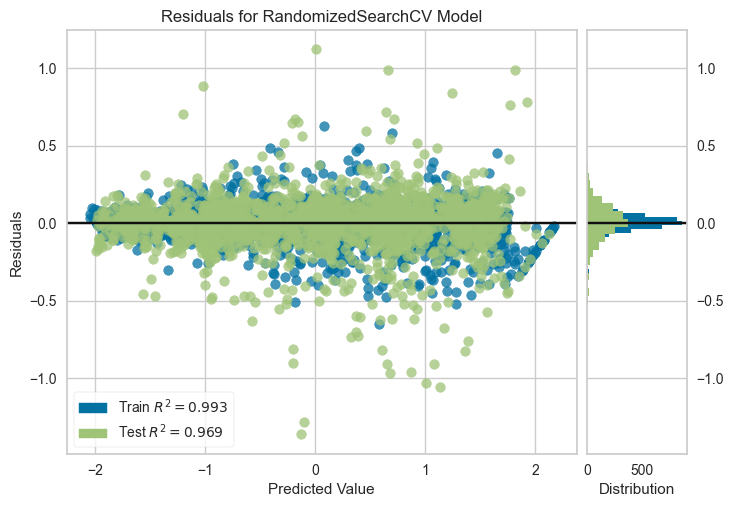

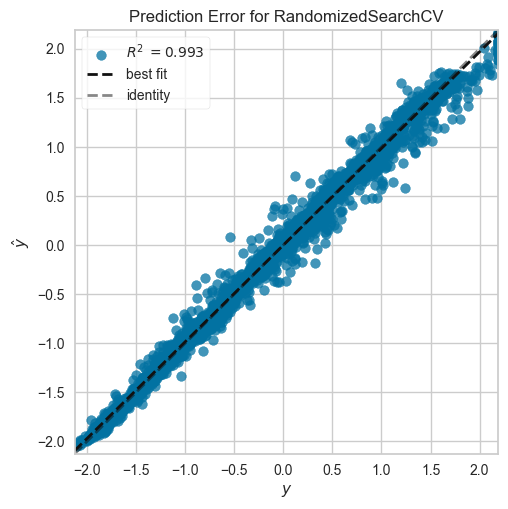

In [105]:
param_grid = {'n_estimators': [100,300,500,800,1000],
              'max_samples': [0.24,0.58,0.71,0.96],
              'max_features': np.linspace(0,1,5),
              'bootstrap': [True,False],
              'oob_score': [True,False]
             }
grid_bag = RandomizedSearchCV(BaggingRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_bag)

In [106]:
grid_bag.best_params_

{'oob_score': False,
 'n_estimators': 1000,
 'max_samples': 0.71,
 'max_features': 1.0,
 'bootstrap': True}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END boosting_type=goss, importance_type=gain, learning_rate=0.2, min_split_gain=1, n_estimators=1000;, score=0.967 total time=   0.0s
[CV 2/5] END boosting_type=goss, importance_type=gain, learning_rate=0.2, min_split_gain=1, n_estimators=1000;, score=0.970 total time=   0.0s
[CV 3/5] END boosting_type=goss, importance_type=gain, learning_rate=0.2, min_split_gain=1, n_estimators=1000;, score=0.960 total time=   0.0s
[CV 4/5] END boosting_type=goss, importance_type=gain, learning_rate=0.2, min_split_gain=1, n_estimators=1000;, score=0.966 total time=   0.0s
[CV 5/5] END boosting_type=goss, importance_type=gain, learning_rate=0.2, min_split_gain=1, n_estimators=1000;, score=0.973 total time=   0.0s
[CV 1/5] END boosting_type=goss, importance_type=split, learning_rate=0.4, min_split_gain=0.68, n_estimators=500;, score=0.971 total time=   0.0s
[CV 2/5] END boosting_type=goss, importance_type=split, learning_rate=0.4, min

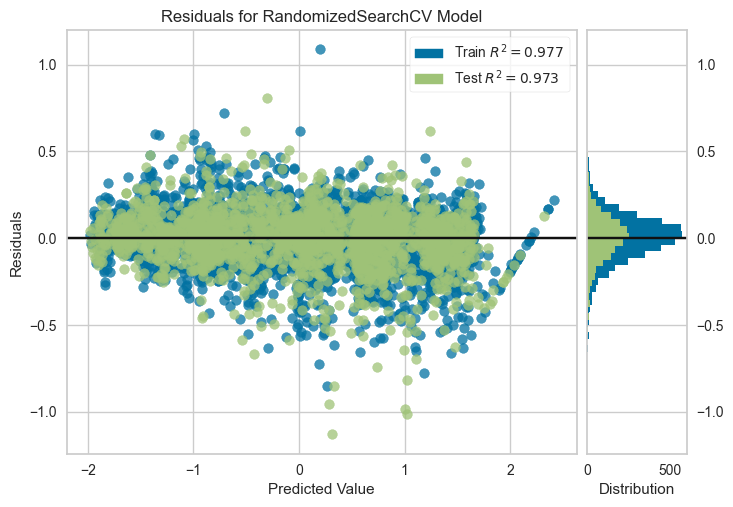

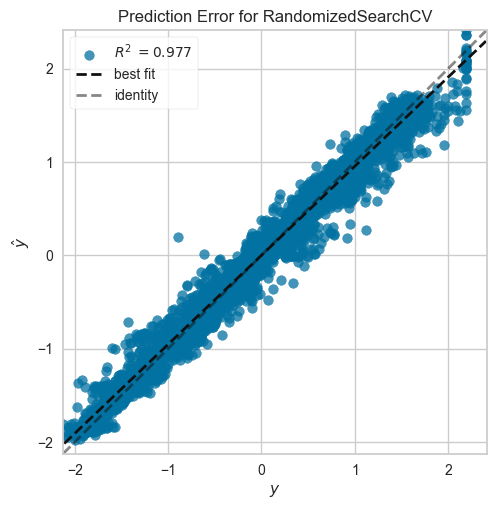

In [107]:
param_grid = {'boosting_type': ['gbdt','dart','goss','rf'],
              'learning_rate': np.linspace(0,1,6)[1:],
              'n_estimators': [100,300,500,800,1000],
              'importance_type': ['split','gain'],
              'min_split_gain': [0.68,0.79,0.87,1]}

grid_lgbm = RandomizedSearchCV(LGBMRegressor(),param_grid,verbose=3)
train_and_evaluate_model(grid_lgbm)

In [108]:
grid_lgbm.best_params_

{'n_estimators': 1000,
 'min_split_gain': 0.79,
 'learning_rate': 0.4,
 'importance_type': 'split',
 'boosting_type': 'goss'}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END bootstrap=True, criterion=squared_error, max_features=log2, max_samples=0.2, n_estimators=100, oob_score=True; total time=   0.6s
[CV] END bootstrap=True, criterion=squared_error, max_features=log2, max_samples=0.2, n_estimators=100, oob_score=True; total time=   0.6s
[CV] END bootstrap=True, criterion=squared_error, max_features=log2, max_samples=0.2, n_estimators=100, oob_score=True; total time=   0.6s
[CV] END bootstrap=True, criterion=squared_error, max_features=log2, max_samples=0.2, n_estimators=100, oob_score=True; total time=   0.2s
[CV] END bootstrap=True, criterion=squared_error, max_features=log2, max_samples=0.2, n_estimators=100, oob_score=True; total time=   0.2s
[CV] END bootstrap=False, criterion=squared_error, max_features=auto, max_samples=0.45, n_estimators=1000, oob_score=False; total time=   0.0s
[CV] END bootstrap=False, criterion=squared_error, max_features=auto, max_samples=0.45, n_estimators=

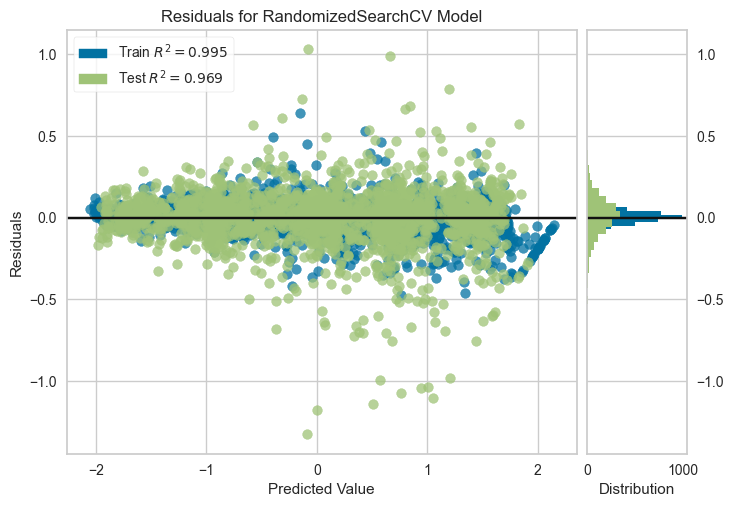

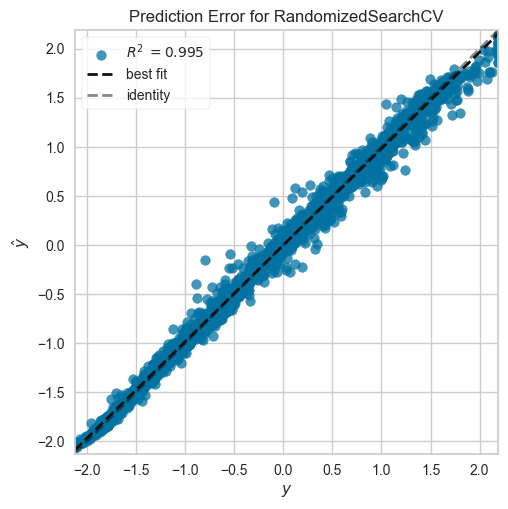

In [109]:
param_grid = {'n_estimators': [100,300,500,800,1000],
             'criterion': ["squared_error", "absolute_error", "friedman_mse", "poisson"],
             'max_features': ['auto','sqrt','log2'],
             'bootstrap': [True,False],
             'oob_score': [True,False],
             'max_samples': [0.2,0.45,0.7,0.95]
             }

grid_et = RandomizedSearchCV(ExtraTreesRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_et)

In [110]:
grid_et.best_params_

{'oob_score': True,
 'n_estimators': 100,
 'max_samples': 0.95,
 'max_features': 'auto',
 'criterion': 'squared_error',
 'bootstrap': True}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END booster=gbtree, grow_policy=0, importance_type=gain, learning_rate=1, n_estimators=700, sampling_method=uniform; total time=   0.0s
[CV] END booster=gbtree, grow_policy=0, importance_type=gain, learning_rate=1, n_estimators=700, sampling_method=uniform; total time=   0.0s
[CV] END booster=gbtree, grow_policy=0, importance_type=gain, learning_rate=1, n_estimators=700, sampling_method=uniform; total time=   0.0s
[CV] END booster=gbtree, grow_policy=0, importance_type=gain, learning_rate=1, n_estimators=700, sampling_method=uniform; total time=   0.0s
[CV] END booster=gbtree, grow_policy=0, importance_type=gain, learning_rate=1, n_estimators=700, sampling_method=uniform; total time=   0.0s
[CV] END booster=dart, grow_policy=0, importance_type=gain, learning_rate=0.6, n_estimators=700, sampling_method=gradient_based; total time=   0.0s
[CV] END booster=dart, grow_policy=0, importance_type=gain, learning_rate=0.6, n_estim

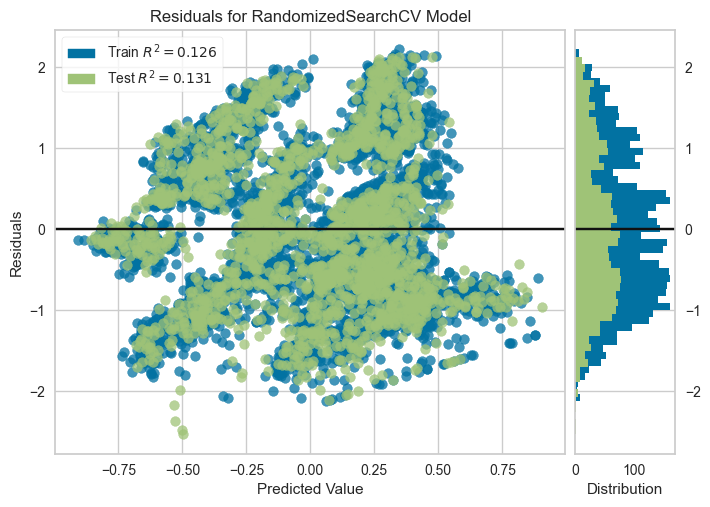

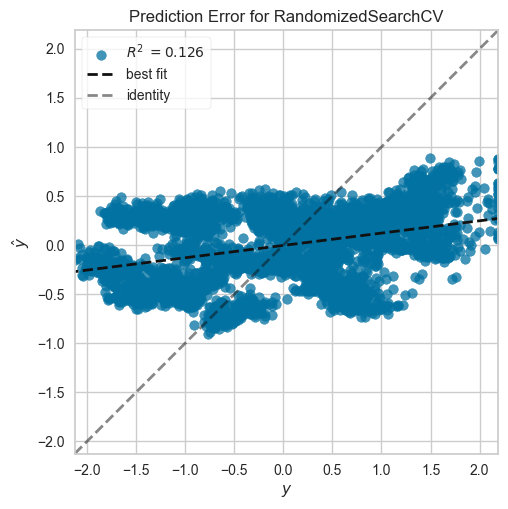

In [111]:
param_grid = {'n_estimators': [100,400,700,900,1000],
              'grow_policy': [0,1],
              'learning_rate': [0.1,0.4,0.6,0.8,1],
              'booster': ['gbtree','gblinear','dart'],
              'sampling_method': ['uniform','gradient_based'],
              'importance_type': ['gain','weight','cover','total_gain','total_cover']
              }

grid_xgb = RandomizedSearchCV(XGBRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_xgb)

In [112]:
grid_xgb.best_params_

{'sampling_method': 'uniform',
 'n_estimators': 100,
 'learning_rate': 0.8,
 'importance_type': 'gain',
 'grow_policy': 1,
 'booster': 'gblinear'}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.15, learning_rate=adaptive, loss=squared_error, penalty=l2, shuffle=True; total time=   0.0s
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.15, learning_rate=adaptive, loss=squared_error, penalty=l2, shuffle=True; total time=   0.0s
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.15, learning_rate=adaptive, loss=squared_error, penalty=l2, shuffle=True; total time=   0.0s
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.15, learning_rate=adaptive, loss=squared_error, penalty=l2, shuffle=True; total time=   0.0s
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.15, learning_rate=adaptive, loss=squared_error, penalty=l2, shuffle=True; total time=   0.0s
[CV] END alpha=1, average=False, epsilon=11.111999999999998, l1_ratio=0.97, learning_rate=optimal, loss=huber, pen

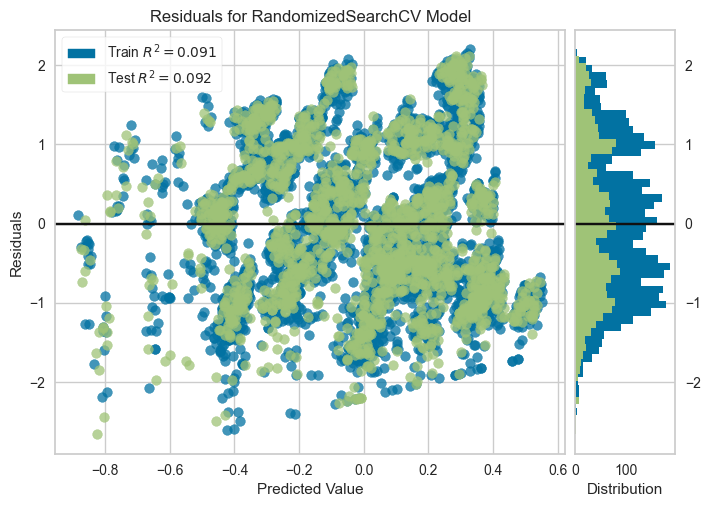

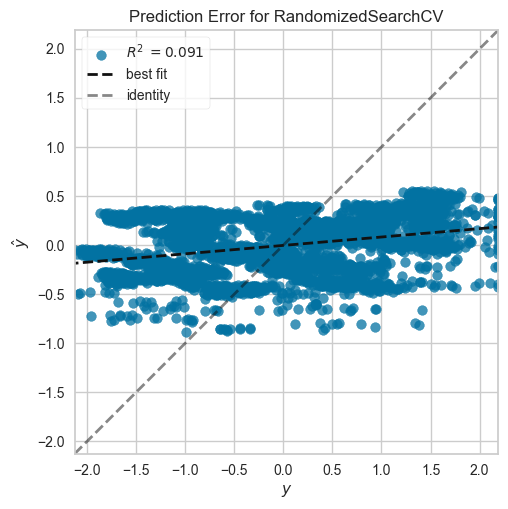

In [113]:
param_grid = {'loss': ['squared_error','huber','epsilon_insensitive','squared_epsilon_insensitive'],
              'penalty': ['l2', 'l1', 'elasticnet'],
              'l1_ratio': [0.15,0.45,0.68,0.81,0.97],
              'alpha': [0.0001,0.001,0.01,0.1,1],
              'shuffle': [True,False],
              'learning_rate': ['adaptive','constant','optimal','invscaling'],
              'epsilon': np.linspace(0.001,100,10),
              'average': [True,False]
             }

grid_sgd = RandomizedSearchCV(SGDRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_sgd)

In [114]:
grid_sgd.best_params_

{'shuffle': False,
 'penalty': 'l1',
 'loss': 'squared_error',
 'learning_rate': 'adaptive',
 'l1_ratio': 0.15,
 'epsilon': 66.667,
 'average': True,
 'alpha': 0.001}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ..........................alpha=6.6667, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=6.6667, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=6.6667, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=6.6667, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=6.6667, epsilon=3.0; total time=   0.0s
[CV] END ..........................alpha=3.3334, epsilon=1.0; total time=   0.0s
[CV] END ..........................alpha=3.3334, epsilon=1.0; total time=   0.0s
[CV] END ..........................alpha=3.3334, epsilon=1.0; total time=   0.0s
[CV] END ..........................alpha=3.3334, epsilon=1.0; total time=   0.0s
[CV] END ..........................alpha=3.3334, epsilon=1.0; total time=   0.0s
[CV] END ............................alpha=10.0, epsilon=5.0; total time=   0.0s
[CV] END ............................alpha=10.0,

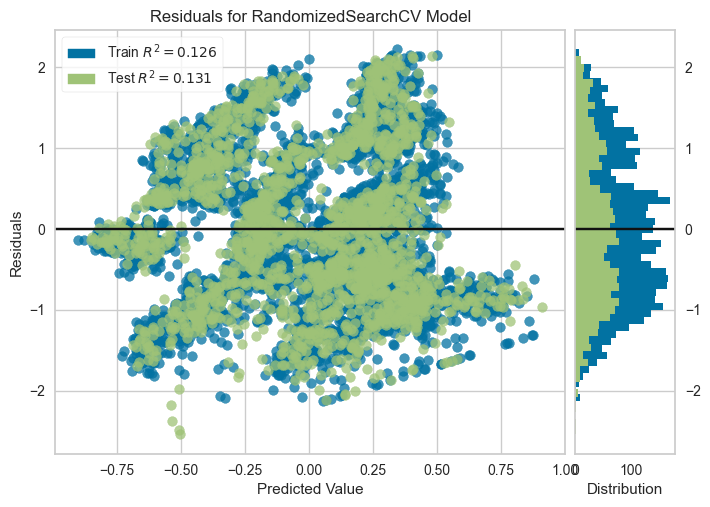

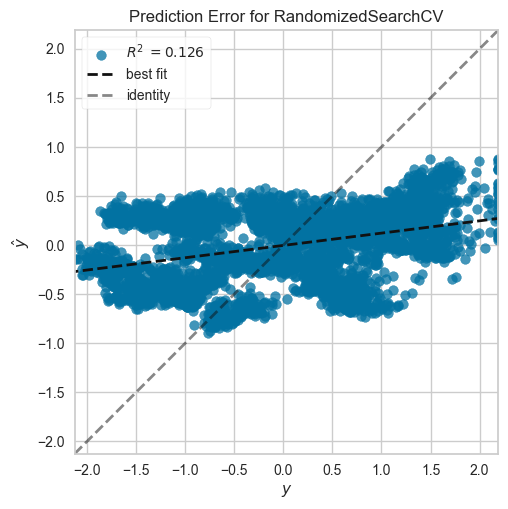

In [115]:
param_grid = {'epsilon': np.linspace(1,10,10),
             'alpha': np.linspace(0.0001,10,10)}

grid_huber = RandomizedSearchCV(HuberRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_huber)

In [116]:
grid_huber.best_params_

{'epsilon': 5.0, 'alpha': 10.0}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ............alpha=10.0, link=identity, solver=lbfgs; total time=   0.0s
[CV] END ............alpha=10.0, link=identity, solver=lbfgs; total time=   0.0s
[CV] END ............alpha=10.0, link=identity, solver=lbfgs; total time=   0.0s
[CV] END ............alpha=10.0, link=identity, solver=lbfgs; total time=   0.0s
[CV] END ............alpha=10.0, link=identity, solver=lbfgs; total time=   0.0s
[CV] END ...............alpha=1.1112, link=log, solver=lbfgs; total time=   0.0s
[CV] END ...............alpha=1.1112, link=log, solver=lbfgs; total time=   0.0s
[CV] END ...............alpha=1.1112, link=log, solver=lbfgs; total time=   0.0s
[CV] END ...............alpha=1.1112, link=log, solver=lbfgs; total time=   0.0s
[CV] END ...............alpha=1.1112, link=log, solver=lbfgs; total time=   0.0s
[CV] END alpha=6.6667, link=identity, solver=newton-cholesky; total time=   0.0s
[CV] END alpha=6.6667, link=identity, solver=new

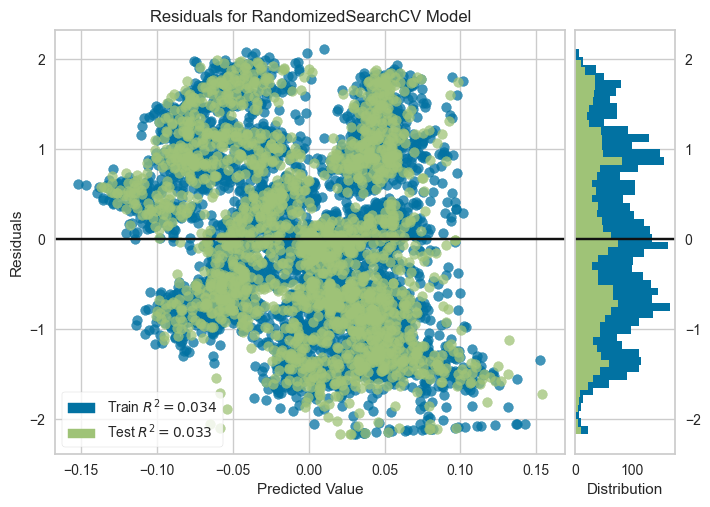

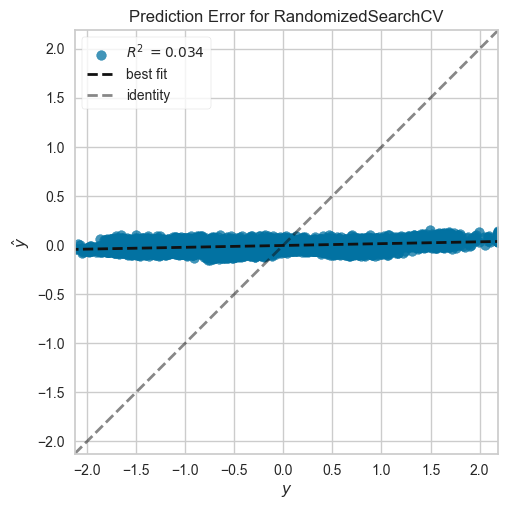

In [117]:
param_grid = {'link': ['auto', 'identity', 'log'],
              'solver': ['lbfgs', 'newton-cholesky'],
              'alpha': np.linspace(0.0001,10,10)}

grid_tweedie = RandomizedSearchCV(TweedieRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_tweedie)

In [118]:
grid_tweedie.best_params_

{'solver': 'newton-cholesky', 'link': 'identity', 'alpha': 5.5556}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END C=10, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=10, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=10, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=10, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=10, average=False, epsilon=0.75025, loss=epsilon_insensitive, shuffle=True; total time=   0.0s
[CV] END C=0.1, average=True, epsilon=0.25075, loss=squared_epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=0.1, average=True, epsilon=0.25075, loss=squared_epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=0.1, average=True, epsilon=0.25075, loss=squared_epsilon_insensitive, shuffle=False; total time=   0.0s
[CV] END C=0.1, average=True, epsilon=0.25075, loss=squared_epsi

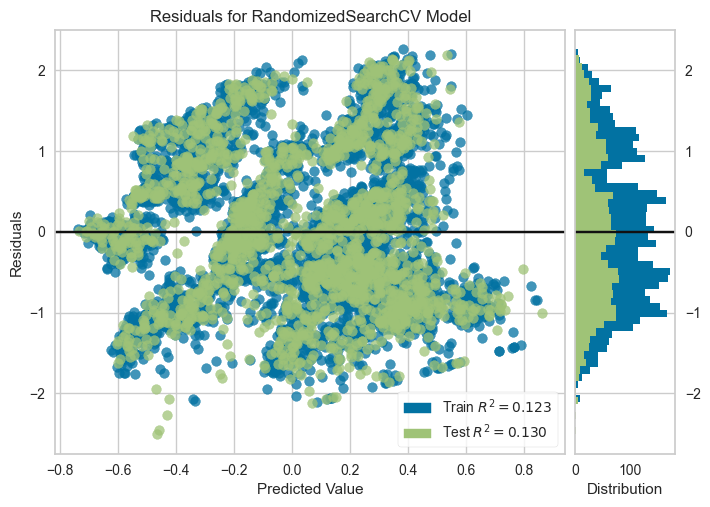

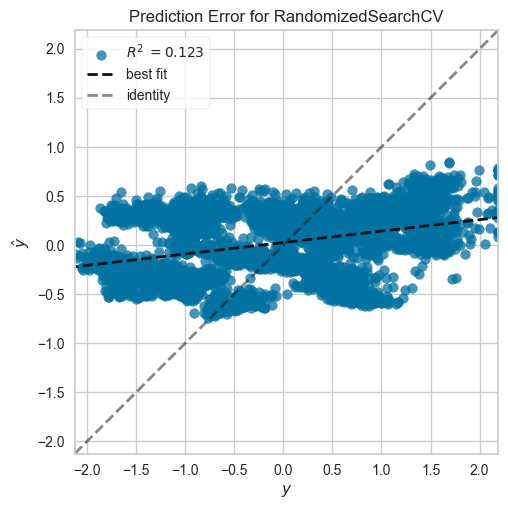

In [119]:
param_grid = {'C': [0.0001,0.001,0.01,0.1,1,10],
              'loss': ['epsilon_insensitive','squared_epsilon_insensitive'],
              'epsilon': np.linspace(0.001,1,5),
              'shuffle': [True,False],
              'average': [True,False]}

grid_pa = RandomizedSearchCV(PassiveAggressiveRegressor(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_pa)

In [120]:
grid_pa.best_params_

{'shuffle': False,
 'loss': 'squared_epsilon_insensitive',
 'epsilon': 0.25075,
 'average': True,
 'C': 0.1}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ..........eps=0.1, positive=False, selection=random; total time=   0.0s
[CV] END ..........eps=0.1, positive=False, selection=random; total time=   0.0s
[CV] END ..........eps=0.1, positive=False, selection=random; total time=   0.0s
[CV] END ..........eps=0.1, positive=False, selection=random; total time=   0.0s
[CV] END ..........eps=0.1, positive=False, selection=random; total time=   0.0s
[CV] END ...........eps=0.1, positive=True, selection=random; total time=   0.0s
[CV] END ...........eps=0.1, positive=True, selection=random; total time=   0.0s
[CV] END ...........eps=0.1, positive=True, selection=random; total time=   0.0s
[CV] END ...........eps=0.1, positive=True, selection=random; total time=   0.0s
[CV] END ...........eps=0.1, positive=True, selection=random; total time=   0.0s
[CV] END .......eps=0.0001, positive=False, selection=cyclic; total time=   0.0s
[CV] END .......eps=0.0001, positive=False, sele

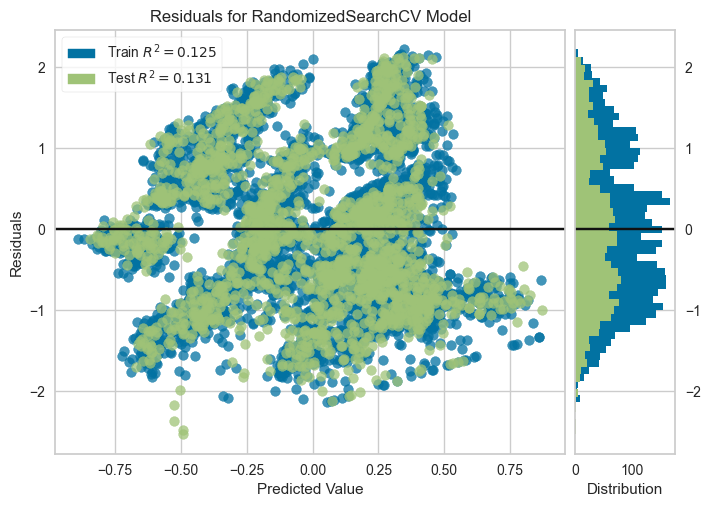

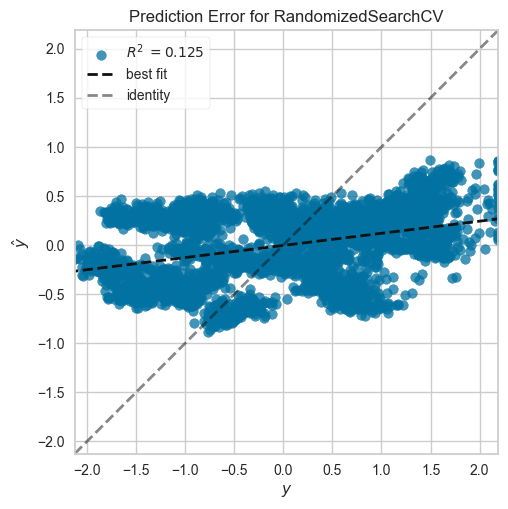

In [121]:
param_grid = {
    'eps': [0.0001,0.001,0.01,0.1,1],
    'positive': [True,False],
    'selection': ['cyclic','random']
}

grid_lasso = RandomizedSearchCV(LassoCV(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_lasso)

In [122]:
grid_lasso.best_params_

{'selection': 'random', 'positive': False, 'eps': 0.01}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha_per_target=False, alphas=(0.001, 0.01, 0.1), gcv_mode=eigen, store_cv_values=False; total time=  10.4s
[CV] END alpha_per_target=False, alphas=(0.001, 0.01, 0.1), gcv_mode=eigen, store_cv_values=False; total time=  10.3s
[CV] END alpha_per_target=False, alphas=(0.001, 0.01, 0.1), gcv_mode=eigen, store_cv_values=False; total time=  11.4s
[CV] END alpha_per_target=False, alphas=(0.001, 0.01, 0.1), gcv_mode=eigen, store_cv_values=False; total time=  10.1s
[CV] END alpha_per_target=False, alphas=(0.001, 0.01, 0.1), gcv_mode=eigen, store_cv_values=False; total time=  10.0s
[CV] END alpha_per_target=False, alphas=(0.01, 0.1, 1), gcv_mode=svd, store_cv_values=False; total time=   0.0s
[CV] END alpha_per_target=False, alphas=(0.01, 0.1, 1), gcv_mode=svd, store_cv_values=False; total time=   0.0s
[CV] END alpha_per_target=False, alphas=(0.01, 0.1, 1), gcv_mode=svd, store_cv_values=False; total time=   0.0s
[CV] END alph

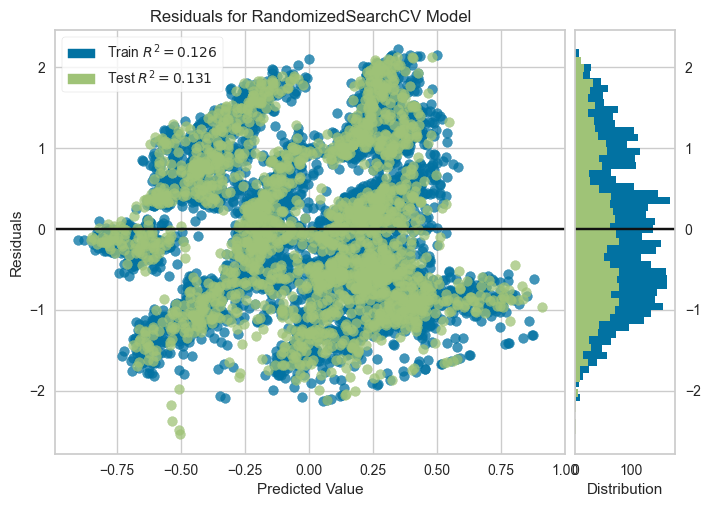

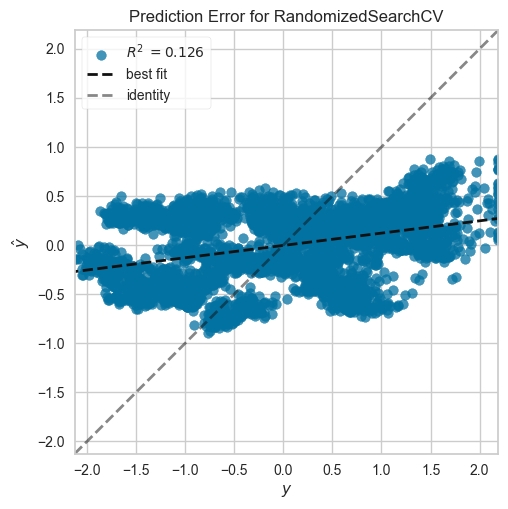

In [123]:
param_grid = {
    'alphas': [(0.1, 1.0, 10.0),(0.01,0.1,1),(0.001,0.01,0.1)],
    'gcv_mode': ['auto', 'svd', 'eigen'],
    'store_cv_values': [True,False],
    'alpha_per_target': [True,False]
}

grid_ridge = RandomizedSearchCV(RidgeCV(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_ridge)

In [124]:
grid_ridge.best_params_

{'store_cv_values': True,
 'gcv_mode': 'svd',
 'alphas': (0.1, 1.0, 10.0),
 'alpha_per_target': True}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ......l1_ratio=0.1, positive=True, selection=cyclic; total time=   0.0s
[CV] END ......l1_ratio=0.1, positive=True, selection=cyclic; total time=   0.0s
[CV] END ......l1_ratio=0.1, positive=True, selection=cyclic; total time=   0.0s
[CV] END ......l1_ratio=0.1, positive=True, selection=cyclic; total time=   0.0s
[CV] END ......l1_ratio=0.1, positive=True, selection=cyclic; total time=   0.0s
[CV] END ........l1_ratio=1, positive=True, selection=random; total time=   0.0s
[CV] END ........l1_ratio=1, positive=True, selection=random; total time=   0.0s
[CV] END ........l1_ratio=1, positive=True, selection=random; total time=   0.0s
[CV] END ........l1_ratio=1, positive=True, selection=random; total time=   0.0s
[CV] END ........l1_ratio=1, positive=True, selection=random; total time=   0.0s
[CV] END ......l1_ratio=0.8, positive=True, selection=random; total time=   0.0s
[CV] END ......l1_ratio=0.8, positive=True, sele

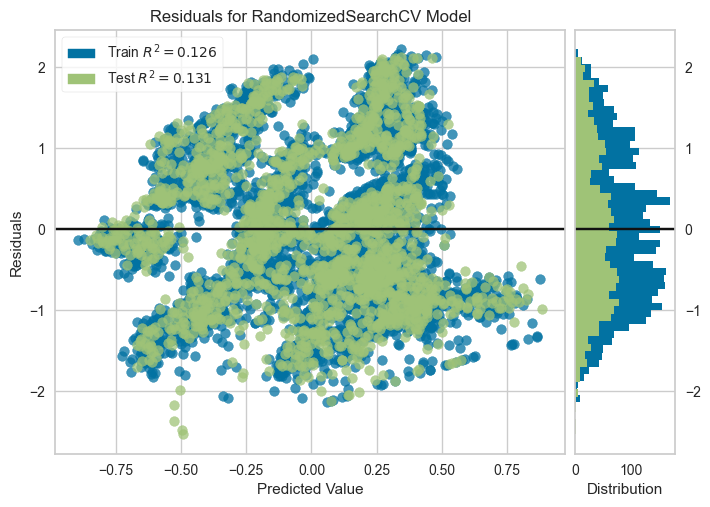

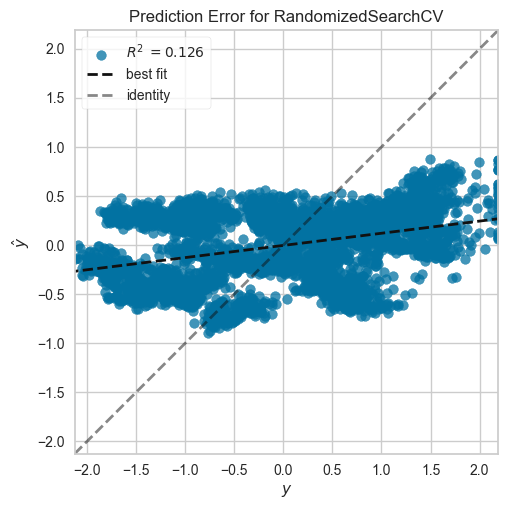

In [125]:
param_grid = {'selection': ['cyclic','random'],
              'l1_ratio': [0.1,0.3,0.5,0.8,1],
              'positive': [True,False]}

grid_elasticnet = RandomizedSearchCV(ElasticNetCV(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_elasticnet)

In [126]:
grid_elasticnet.best_params_

{'selection': 'cyclic', 'positive': False, 'l1_ratio': 0.3}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END ...learning_rate=0.4, loss=square, n_estimators=700; total time=   2.5s
[CV] END ...learning_rate=0.4, loss=square, n_estimators=700; total time=   2.2s
[CV] END ...learning_rate=0.4, loss=square, n_estimators=700; total time=   2.2s
[CV] END ...learning_rate=0.4, loss=square, n_estimators=700; total time=   2.2s
[CV] END ...learning_rate=0.4, loss=square, n_estimators=700; total time=   2.1s
[CV] END learning_rate=0.4, loss=exponential, n_estimators=400; total time=   1.4s
[CV] END learning_rate=0.4, loss=exponential, n_estimators=400; total time=   1.4s
[CV] END learning_rate=0.4, loss=exponential, n_estimators=400; total time=   1.4s
[CV] END learning_rate=0.4, loss=exponential, n_estimators=400; total time=   1.4s
[CV] END learning_rate=0.4, loss=exponential, n_estimators=400; total time=   1.4s
[CV] END ...learning_rate=0.6, loss=linear, n_estimators=100; total time=   0.2s
[CV] END ...learning_rate=0.6, loss=li

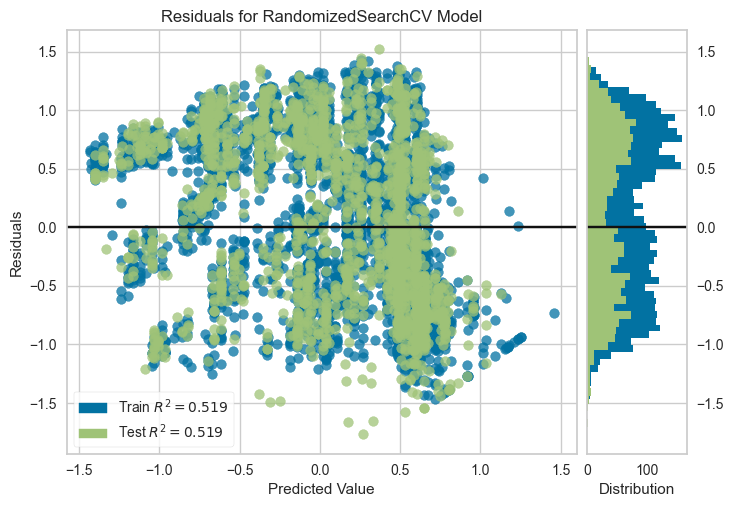

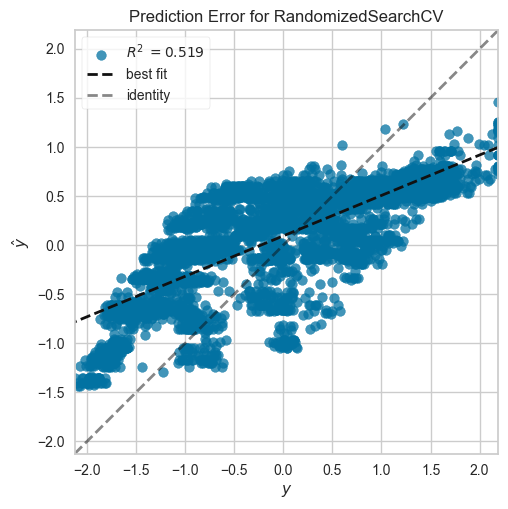

In [127]:
param_grid = {'n_estimators': np.arange(100,1001,300),
             'learning_rate': [0.1,0.4,0.6,0.8,1],
             'loss': ['linear', 'square', 'exponential']}

grid_ab = RandomizedSearchCV(AdaBoostRegressor(),param_grid,cv=5,verbose=2)
train_and_evaluate_model(grid_ab)

In [128]:
grid_ab.best_params_

{'n_estimators': 100, 'loss': 'square', 'learning_rate': 1}

Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV] END alpha_1=1e-06, alpha_2=1e-06, compute_score=False, fit_intercept=False, lambda_1=1e-07, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-06, alpha_2=1e-06, compute_score=False, fit_intercept=False, lambda_1=1e-07, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-06, alpha_2=1e-06, compute_score=False, fit_intercept=False, lambda_1=1e-07, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-06, alpha_2=1e-06, compute_score=False, fit_intercept=False, lambda_1=1e-07, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-06, alpha_2=1e-06, compute_score=False, fit_intercept=False, lambda_1=1e-07, lambda_2=1e-08; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-06, compute_score=True, fit_intercept=True, lambda_1=1e-07, lambda_2=1e-07; total time=   0.0s
[CV] END alpha_1=1e-08, alpha_2=1e-06, compute_score=True, fit_intercept=True, lambda_1=1e-07, lambda_2=1e-07; total time=   0.0s
[CV] END alpha_1=1e

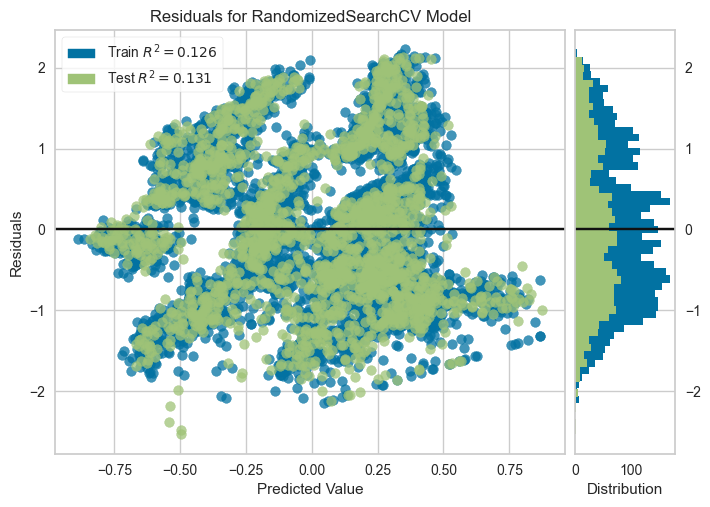

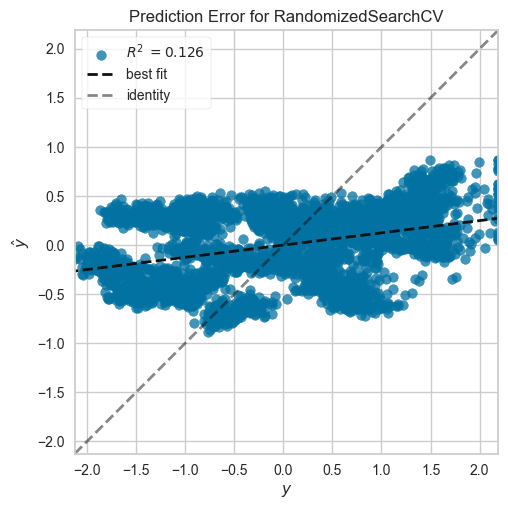

In [129]:
param_grid = {'alpha_1': [1e-5,1e-6,1e-7,1e-8],
              'alpha_2': [1e-5,1e-6,1e-7,1e-8],
              'lambda_1': [1e-5,1e-6,1e-7,1e-8],
              'lambda_2': [1e-5,1e-6,1e-7,1e-8],
              'fit_intercept': [True,False],
              'compute_score': [True,False]}

grid_ard = RandomizedSearchCV(ARDRegression(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_ard)

In [130]:
grid_ard.best_params_

{'lambda_2': 1e-08,
 'lambda_1': 1e-07,
 'fit_intercept': False,
 'compute_score': False,
 'alpha_2': 1e-06,
 'alpha_1': 1e-06}

Fitting 5 folds for each of 4 candidates, totalling 20 fits
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END ..................fit_intercept=True, positive=True; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=True, positive=False; total time=   0.0s
[CV] END .................fit_intercept=False, positive=True; total time=   0.0s
[CV] END .................fit_intercept=False, po

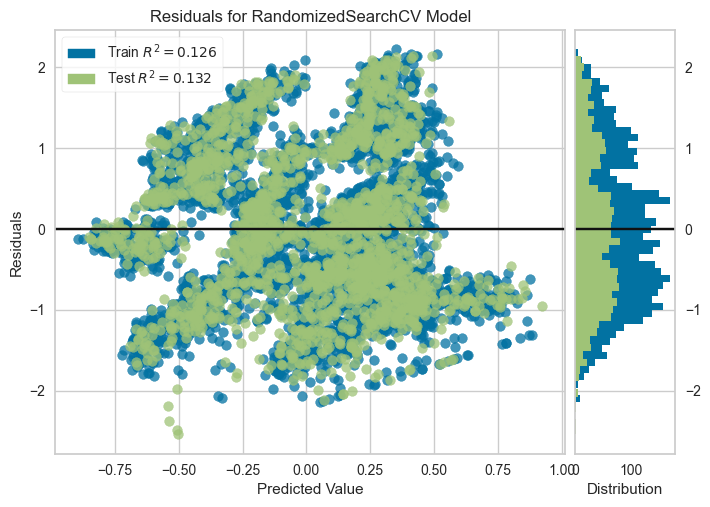

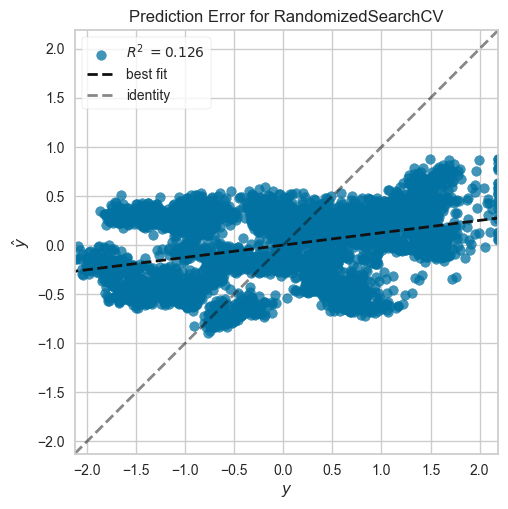

In [131]:
param_grid = {'fit_intercept': [True,False],
             'positive': [True,False]}

grid_lr = RandomizedSearchCV(LinearRegression(),param_grid,verbose=2,cv=5)
train_and_evaluate_model(grid_lr)

In [132]:
grid_lr.best_params_

{'positive': False, 'fit_intercept': False}

## Optimized Models Performance Comparison

In [133]:
model_perfs = pd.DataFrame({'Model': models, 'MAPE': mape_scores, 'RMSE': rmse_scores, 'R2': r2_scores}).sort_values('R2',ascending=False)
model_perfs

,Model,MAPE,RMSE,R2
34,"RandomizedSearchCV(cv=5,\n e...",0.439785,0.116884,0.986654
25,<catboost.core.CatBoostRegressor object at 0x0...,0.534145,0.122909,0.985243
21,"XGBRegressor(base_score=None, booster=None, ca...",0.448424,0.127983,0.983999
29,RandomizedSearchCV(cv=RepeatedKFold(n_repeats=...,0.353994,0.128688,0.983822
24,LGBMRegressor(),0.483647,0.128976,0.983750
18,HistGradientBoostingRegressor(),0.510873,0.129433,0.983634
26,"VotingRegressor(estimators=[('CAT',\n ...",0.483340,0.131280,0.983164
36,"RandomizedSearchCV(estimator=LGBMRegressor(),\...",0.812379,0.166020,0.973074
33,"RandomizedSearchCV(cv=6, estimator=GradientBoo...",0.538507,0.168305,0.972328
16,"(ExtraTreeRegressor(random_state=1040630546), ...",0.596846,0.178494,0.968876


Hyperparameter-tuned Cat Boost Regressor is the best performing model among all optimized models, achieving an outstanding r2 score of nearly 98.7%. 

## Saving the best model for future use

In [141]:
# Cross validating the performance of the Cat Boost Regressor model before saving it
avg_cv_score = np.mean(cross_val_score(grid_cat,X_test,y_test,scoring='r2',cv=RepeatedKFold(n_splits=4,n_repeats=2),verbose=1))
print("Average cross validation R2 score:",avg_cv_score)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END learning_rate=0.4, n_estimators=700;, score=0.967 total time=   1.6s
[CV 2/5] END learning_rate=0.4, n_estimators=700;, score=0.962 total time=   1.2s
[CV 3/5] END learning_rate=0.4, n_estimators=700;, score=0.967 total time=   1.3s
[CV 4/5] END learning_rate=0.4, n_estimators=700;, score=0.957 total time=   1.2s
[CV 5/5] END learning_rate=0.4, n_estimators=700;, score=0.962 total time=   1.3s
[CV 1/5] END learning_rate=0.4, n_estimators=400;, score=0.967 total time=   1.1s
[CV 2/5] END learning_rate=0.4, n_estimators=400;, score=0.962 total time=   1.0s
[CV 3/5] END learning_rate=0.4, n_estimators=400;, score=0.967 total time=   0.9s
[CV 4/5] END learning_rate=0.4, n_estimators=400;, score=0.957 total time=   0.9s
[CV 5/5] END learning_rate=0.4, n_estimators=400;, score=0.961 total time=   0.9s
[CV 1/5] END learning_rate=0.2, n_estimators=400;, score=0.967 total time=   1.1s
[CV 2/5] END learning_rate=0.2, n_est

[CV 5/5] END learning_rate=0.5, n_estimators=800;, score=0.967 total time=   1.6s
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END learning_rate=0.2, n_estimators=100;, score=0.944 total time=   0.7s
[CV 2/5] END learning_rate=0.2, n_estimators=100;, score=0.952 total time=   0.7s
[CV 3/5] END learning_rate=0.2, n_estimators=100;, score=0.966 total time=   0.8s
[CV 4/5] END learning_rate=0.2, n_estimators=100;, score=0.952 total time=   0.8s
[CV 5/5] END learning_rate=0.2, n_estimators=100;, score=0.947 total time=   1.0s
[CV 1/5] END .learning_rate=1, n_estimators=100;, score=0.920 total time=   0.8s
[CV 2/5] END .learning_rate=1, n_estimators=100;, score=0.948 total time=   0.7s
[CV 3/5] END .learning_rate=1, n_estimators=100;, score=0.959 total time=   0.7s
[CV 4/5] END .learning_rate=1, n_estimators=100;, score=0.897 total time=   0.6s
[CV 5/5] END .learning_rate=1, n_estimators=100;, score=0.948 total time=   0.7s
[CV 1/5] END learning_rate=0.2, n_estimato

[CV 4/5] END .learning_rate=1, n_estimators=400;, score=0.929 total time=   0.8s
[CV 5/5] END .learning_rate=1, n_estimators=400;, score=0.936 total time=   1.1s
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END .learning_rate=1, n_estimators=800;, score=0.931 total time=   1.5s
[CV 2/5] END .learning_rate=1, n_estimators=800;, score=0.932 total time=   2.0s
[CV 3/5] END .learning_rate=1, n_estimators=800;, score=0.945 total time=   2.2s
[CV 4/5] END .learning_rate=1, n_estimators=800;, score=0.928 total time=   1.4s
[CV 5/5] END .learning_rate=1, n_estimators=800;, score=0.945 total time=   1.4s
[CV 1/5] END learning_rate=0.7, n_estimators=700;, score=0.954 total time=   1.4s
[CV 2/5] END learning_rate=0.7, n_estimators=700;, score=0.941 total time=   1.4s
[CV 3/5] END learning_rate=0.7, n_estimators=700;, score=0.958 total time=   1.4s
[CV 4/5] END learning_rate=0.7, n_estimators=700;, score=0.954 total time=   1.7s
[CV 5/5] END learning_rate=0.7, n_estimators

[CV 3/5] END .learning_rate=1, n_estimators=100;, score=0.934 total time=   0.6s
[CV 4/5] END .learning_rate=1, n_estimators=100;, score=0.919 total time=   0.8s
[CV 5/5] END .learning_rate=1, n_estimators=100;, score=0.946 total time=   0.6s
Fitting 5 folds for each of 10 candidates, totalling 50 fits
[CV 1/5] END learning_rate=0.7, n_estimators=700;, score=0.962 total time=   1.5s
[CV 2/5] END learning_rate=0.7, n_estimators=700;, score=0.969 total time=   1.4s
[CV 3/5] END learning_rate=0.7, n_estimators=700;, score=0.957 total time=   1.4s
[CV 4/5] END learning_rate=0.7, n_estimators=700;, score=0.951 total time=   1.5s
[CV 5/5] END learning_rate=0.7, n_estimators=700;, score=0.959 total time=   1.5s
[CV 1/5] END learning_rate=0.7, n_estimators=100;, score=0.960 total time=   0.9s
[CV 2/5] END learning_rate=0.7, n_estimators=100;, score=0.968 total time=   0.7s
[CV 3/5] END learning_rate=0.7, n_estimators=100;, score=0.955 total time=   0.7s
[CV 4/5] END learning_rate=0.7, n_estima

[CV 2/5] END learning_rate=0.4, n_estimators=100;, score=0.963 total time=   0.7s
[CV 3/5] END learning_rate=0.4, n_estimators=100;, score=0.963 total time=   0.9s
[CV 4/5] END learning_rate=0.4, n_estimators=100;, score=0.957 total time=   0.7s
[CV 5/5] END learning_rate=0.4, n_estimators=100;, score=0.958 total time=   0.6s
Average cross validation R2 score: 0.9753825201956607


[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed: 10.0min finished


In [142]:
joblib.dump(grid_cat,'walmart_sales_predictor.h5')

['walmart_sales_predictor.h5']

In [143]:
model = joblib.load('walmart_sales_predictor.h5')
model

RandomizedSearchCV(cv=5,
                   estimator=<catboost.core.CatBoostRegressor object at 0x000001BE0B867DF0>,
                   param_distributions={'learning_rate': [0.2, 0.4, 0.5, 0.7,
                                                          1],
                                        'n_estimators': [100, 400, 700, 800,
                                                         1000]},
                   verbose=5)